In [61]:
import pandas as pd
from scipy.stats import kruskal
from scikit_posthocs import posthoc_dunn
import seaborn as sns

import cv2
import matplotlib.pyplot as plt
import numpy as np
import sys
import math
from pathlib import Path

from utils_behavior import Processing

In [2]:
# Function to bin event_id into 50 bins
def bin_metric(df, column, bins):

    # Get the name of the metric which is name of the column
    metric = column

    df[f"binned_{metric}"] = pd.cut(df[column], bins=bins, labels=False)
    return df

In [146]:
def calculate_and_plot_normalized_proportions(
    data,
    group_by_column,
    metadata_column,
    normalize_by_column,
    output_dir,
    significance_annotations=None,
    figsize=(12, 6),
    title="Normalized Proportions by Cluster",
    xlabel="Cluster Number",
    ylabel="Normalized Proportion",
    save_filename="normalized_proportions_by_cluster.png",
):
    """
    Generalized function to calculate and plot normalized proportions of a metadata column grouped by clusters.

    Args:
        data (pd.DataFrame): The dataset containing clusters and metadata.
        group_by_column (str): The column to group by (e.g., "cluster").
        metadata_column (str): The metadata column to calculate proportions for (e.g., "event_type").
        normalize_by_column (str): The column to normalize proportions by (e.g., "Light").
        output_dir (Path): Directory to save the plot.
        figsize (tuple, optional): Size of the plot. Default is (12, 6).
        title (str, optional): Title of the plot. Default is "Normalized Proportions by Cluster".
        xlabel (str, optional): Label for the x-axis. Default is "Cluster Number".
        ylabel (str, optional): Label for the y-axis. Default is "Normalized Proportion".
        save_filename (str, optional): Filename to save the plot. Default is "normalized_proportions_by_cluster.png".

    Returns:
        None
    """
    # Calculate the total count for each category in the normalize_by_column
    total_counts = data[normalize_by_column].value_counts(normalize=False)

    # Initialize a DataFrame to store the normalized proportions
    proportions_df = pd.DataFrame()

    # Process each normalization group (e.g., each light condition)
    for normalize_group in data[normalize_by_column].unique():
        group_data = data[data[normalize_by_column] == normalize_group]

        # Get unique clusters within this group
        unique_clusters = group_data[group_by_column].unique()

        # Process each cluster
        for cluster_id in unique_clusters:
            cluster_data = group_data[group_data[group_by_column] == cluster_id]

            # Count metadata types and calculate proportions
            metadata_counts = cluster_data[metadata_column].value_counts(normalize=False).reset_index()
            metadata_counts.columns = [metadata_column, "proportion"]

            # Normalize by the total count of the category
            if normalize_group in total_counts:
                metadata_counts["normalized_proportion"] = metadata_counts["proportion"] / total_counts[normalize_group]
            else:
                metadata_counts["normalized_proportion"] = 0  # Handle missing groups gracefully

            metadata_counts[group_by_column] = cluster_id
            metadata_counts[normalize_by_column] = normalize_group

            # Append to the proportions DataFrame
            proportions_df = pd.concat([proportions_df, metadata_counts], ignore_index=True)

    clusters = sorted(data[group_by_column].unique())

    # Plot normalized proportions as bar plots
    plt.figure(figsize=figsize)
    sns.barplot(data=proportions_df, x=group_by_column, y="normalized_proportion", hue=metadata_column)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.legend(title=metadata_column, bbox_to_anchor=(1.05, 1), loc="upper left")

    # Add vertical lines between cluster groups
    for i in range(len(clusters) - 1):
        plt.axvline(x=i + 0.5, color="gray", linestyle="-", alpha=0.5, linewidth=1)

    # Add alternating background for easier visual grouping
    for i in range(len(clusters)):
        if i % 2 == 0:  # Every other cluster gets a light background
            plt.axvspan(i - 0.5, i + 0.5, alpha=0.1, color="gray")

    # Add statistical annotations
    if significance_annotations:
        for cluster, annotation in significance_annotations.items():
            plt.text(
                x=clusters.index(cluster),
                y=proportions_df["normalized_proportion"].max() * 1.05,
                s=annotation,
                ha="center",
                va="bottom",
                fontsize=10,
                color="red",
            )

    plt.tight_layout()

    # Save the plot
    plt.savefig(f"{output_dir}/{save_filename}")
    plt.show()
    plt.close()

In [50]:
def calculate_and_plot_proportions(
    data,
    group_by_column,
    metadata_column,
    output_dir,
    figsize=(12, 6),
    title="Proportions by Cluster",
    xlabel="Cluster Number",
    ylabel="Proportion",
    save_filename="proportions_by_cluster.png",
):
    """
    Generalized function to calculate and plot proportions of a metadata column grouped by clusters.

    Args:
        data (pd.DataFrame): The dataset containing clusters and metadata.
        group_by_column (str): The column to group by (e.g., "cluster").
        metadata_column (str): The metadata column to calculate proportions for (e.g., "event_type").
        output_dir (Path): Directory to save the plot.
        figsize (tuple, optional): Size of the plot. Default is (12, 6).
        title (str, optional): Title of the plot. Default is "Proportions by Cluster".
        xlabel (str, optional): Label for the x-axis. Default is "Cluster Number".
        ylabel (str, optional): Label for the y-axis. Default is "Proportion".
        save_filename (str, optional): Filename to save the plot. Default is "proportions_by_cluster.png".

    Returns:
        None
    """
    # Get unique clusters
    unique_clusters = data[group_by_column].unique()

    # Initialize a DataFrame to store the proportions
    proportions_df = pd.DataFrame()

    # Process each cluster
    for cluster_id in unique_clusters:
        cluster_data = data[data[group_by_column] == cluster_id]

        # Count metadata types and calculate proportions
        metadata_counts = cluster_data[metadata_column].value_counts(normalize=True).reset_index()
        metadata_counts.columns = [metadata_column, "proportion"]
        metadata_counts[group_by_column] = cluster_id

        # Append to the proportions DataFrame
        proportions_df = pd.concat([proportions_df, metadata_counts], ignore_index=True)

    clusters = sorted(data[group_by_column].unique())

    # Plot proportions as bar plots
    plt.figure(figsize=figsize)
    sns.barplot(data=proportions_df, x=group_by_column, y="proportion", hue=metadata_column)
    plt.axhline(0.5, color="red", linestyle="--")
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.legend(title=metadata_column, bbox_to_anchor=(1.05, 1), loc="upper left")

    # Add vertical lines between cluster groups
    for i in range(len(clusters) - 1):
        plt.axvline(x=i + 0.5, color="gray", linestyle="-", alpha=0.5, linewidth=1)

    # Add alternating background for easier visual grouping
    for i in range(len(clusters)):
        if i % 2 == 0:  # Every other cluster gets a light background
            plt.axvspan(i - 0.5, i + 0.5, alpha=0.1, color="gray")

    plt.tight_layout()

    # Save the plot
    plt.savefig(f"{output_dir}/{save_filename}")
    plt.show()
    plt.close()

In [36]:
def calculate_and_plot_proportions_perfly(
    data,
    group_by_column,
    metadata_column,
    output_dir,
    min_data_points=5,
    figsize=(18, 8),
    title="Proportions by Cluster",
    xlabel="Cluster Number",
    ylabel="Proportion",
    save_filename="proportions_by_cluster.png",
):
    """
    Generalized function to calculate and plot proportions of a metadata column grouped by clusters.

    Args:
        data (pd.DataFrame): The dataset containing clusters and metadata.
        group_by_column (str): The column to group by (e.g., "cluster").
        metadata_column (str): The metadata column to calculate proportions for (e.g., "event_type").
        output_dir (Path): Directory to save the plot.
        min_data_points (int, optional): Minimum number of data points required for processing. Default is 5.
        figsize (tuple, optional): Size of the plot. Default is (18, 8).
        title (str, optional): Title of the plot. Default is "Proportions by Cluster".
        xlabel (str, optional): Label for the x-axis. Default is "Cluster Number".
        ylabel (str, optional): Label for the y-axis. Default is "Proportion".
        save_filename (str, optional): Filename to save the plot. Default is "proportions_by_cluster.png".

    Returns:
        None
    """
    # Get unique clusters
    unique_clusters = data[group_by_column].unique()

    # Initialize a DataFrame to store the proportions
    proportions_df = pd.DataFrame()

    # Process each cluster and group combination
    for cluster_id in unique_clusters:
        cluster_data = data[data[group_by_column] == cluster_id]

        # Get unique groups in this cluster
        unique_groups = cluster_data["fly"].unique()

        for group_id in unique_groups:
            # Get data for this specific group and cluster
            group_cluster_data = cluster_data[cluster_data["fly"] == group_id]

            # Only process if we have enough data points
            if len(group_cluster_data) >= min_data_points:
                # Count metadata types and calculate proportions
                metadata_counts = group_cluster_data[metadata_column].value_counts(normalize=True).reset_index()
                metadata_counts.columns = [metadata_column, "proportion"]
                metadata_counts[group_by_column] = cluster_id
                metadata_counts["fly"] = group_id

                # Append to the proportions DataFrame
                proportions_df = pd.concat([proportions_df, metadata_counts], ignore_index=True)

    # Get unique metadata values and clusters
    metadata_values = sorted(proportions_df[metadata_column].unique())
    clusters = sorted(proportions_df[group_by_column].unique())

    # Create figure with specified size
    plt.figure(figsize=figsize)

    # Set style for better grid visibility
    sns.set_style("whitegrid")

    # Add boxplot with explicit order
    ax = sns.boxplot(
        data=proportions_df,
        x=group_by_column,
        y="proportion",
        hue=metadata_column,
        hue_order=metadata_values,
        width=0.7,  # Slightly narrower boxes
    )

    # Add stripplot with the SAME order
    sns.stripplot(
        data=proportions_df,
        x=group_by_column,
        y="proportion",
        hue=metadata_column,
        hue_order=metadata_values,
        color="black",
        dodge=True,
        size=3,
        alpha=0.5,
        edgecolor="gray",
        linewidth=0.5,
    )

    # Add vertical lines between cluster groups
    for i in range(len(clusters) - 1):
        plt.axvline(x=i + 0.5, color="gray", linestyle="-", alpha=0.5, linewidth=1)

    # Add alternating background for easier visual grouping
    for i in range(len(clusters)):
        if i % 2 == 0:  # Every other cluster gets a light background
            plt.axvspan(i - 0.5, i + 0.5, alpha=0.1, color="gray")

    # Set proper grid
    plt.grid(axis="y", linestyle="--", alpha=0.7)
    plt.grid(axis="x", visible=False)  # Remove default x grid

    plt.axhline(0.5, color="red", linestyle="--", label="Equal proportion")
    plt.title(title, fontsize=14)
    plt.xlabel(xlabel, fontsize=12)
    plt.ylabel(ylabel, fontsize=12)

    # Improve x-axis labels
    plt.xticks(range(len(clusters)), [str(c) for c in clusters], fontsize=11, fontweight="bold")

    # Create a better legend (only keep one set)
    handles, labels = plt.gca().get_legend_handles_labels()
    plt.legend(
        handles[: len(metadata_values)],
        labels[: len(metadata_values)],
        title=metadata_column,
        bbox_to_anchor=(1.05, 1),
        loc="upper left",
        fontsize=11,
    )

    plt.tight_layout()

    # Save the plot
    plt.savefig(f"{output_dir}/{save_filename}")
    plt.show()
    plt.close()

In [62]:
def kruskal_with_posthoc(data, group_column, value_column, alpha=0.05):
    """
    Perform Kruskal-Wallis test followed by Dunn's post-hoc test for multiple comparisons.

    Args:
        data (pd.DataFrame): The input data containing groups and values.
        group_column (str): The column name representing the groups (e.g., clusters).
        value_column (str): The column name representing the values to compare.
        alpha (float, optional): Significance level for the tests. Default is 0.05.

    Returns:
        dict: A dictionary where keys are clusters and values are significance annotations
              ('n.s', '*', '**', '***') based on adjusted p-values.
    """
    # Initialize the results dictionary
    results = {}

    # Get unique groups
    groups = data[group_column].unique()

    # Prepare data for Kruskal-Wallis test
    group_data = [data[data[group_column] == group][value_column] for group in groups]

    # Perform Kruskal-Wallis test
    stat, p_value = kruskal(*group_data)

    if p_value < alpha:
        # If Kruskal-Wallis is significant, perform Dunn's post-hoc test
        posthoc_results = posthoc_dunn(data, val_col=value_column, group_col=group_column, p_adjust="bonferroni")

        # Annotate significance levels for each cluster
        for group in groups:
            # Get the minimum adjusted p-value for the current group
            min_p_value = posthoc_results[group].min()

            # Assign significance levels
            if min_p_value < 0.001:
                results[group] = "***"
            elif min_p_value < 0.01:
                results[group] = "**"
            elif min_p_value < 0.05:
                results[group] = "*"
            else:
                results[group] = "n.s"
    else:
        # If Kruskal-Wallis is not significant, mark all clusters as 'n.s'
        results = {group: "n.s" for group in groups}

    return results

In [68]:
def calculate_and_plot_normalized_proportions_with_stats(
    data,
    group_by_column,
    metadata_column,
    normalize_by_column,
    output_dir,
    figsize=(12, 6),
    title="Normalized Proportions by Cluster",
    xlabel="Cluster Number",
    ylabel="Normalized Proportion",
    save_filename="normalized_proportions_with_stats.png",
    alpha=0.05,
):
    """
    Calculate and plot normalized proportions of a metadata column grouped by clusters,
    with statistical annotations from Kruskal-Wallis and Dunn's post-hoc tests.

    Args:
        data (pd.DataFrame): The dataset containing clusters and metadata.
        group_by_column (str): The column to group by (e.g., "cluster").
        metadata_column (str): The metadata column to calculate proportions for (e.g., "event_type").
        normalize_by_column (str): The column to normalize proportions by (e.g., "Light").
        output_dir (Path): Directory to save the plot.
        figsize (tuple, optional): Size of the plot. Default is (12, 6).
        title (str, optional): Title of the plot. Default is "Normalized Proportions by Cluster".
        xlabel (str, optional): Label for the x-axis. Default is "Cluster Number".
        ylabel (str, optional): Label for the y-axis. Default is "Normalized Proportion".
        save_filename (str, optional): Filename to save the plot. Default is "normalized_proportions_with_stats.png".
        alpha (float, optional): Significance level for statistical tests. Default is 0.05.

    Returns:
        None
    """
    # Calculate the total count for each category in the normalize_by_column
    total_counts = data[normalize_by_column].value_counts(normalize=False)

    # Initialize a DataFrame to store the normalized proportions
    proportions_df = pd.DataFrame()

    # Process each normalization group (e.g., each light condition)
    for normalize_group in data[normalize_by_column].unique():
        group_data = data[data[normalize_by_column] == normalize_group]

        # Get unique clusters within this group
        unique_clusters = group_data[group_by_column].unique()

        # Process each cluster
        for cluster_id in unique_clusters:
            cluster_data = group_data[group_data[group_by_column] == cluster_id]

            # Count metadata types and calculate proportions
            metadata_counts = cluster_data[metadata_column].value_counts(normalize=False).reset_index()
            metadata_counts.columns = [metadata_column, "proportion"]

            # Normalize by the total count of the category
            if normalize_group in total_counts:
                metadata_counts["normalized_proportion"] = metadata_counts["proportion"] / total_counts[normalize_group]
            else:
                metadata_counts["normalized_proportion"] = 0  # Handle missing groups gracefully

            metadata_counts[group_by_column] = cluster_id
            metadata_counts[normalize_by_column] = normalize_group

            # Append to the proportions DataFrame
            proportions_df = pd.concat([proportions_df, metadata_counts], ignore_index=True)

    # Perform Kruskal-Wallis and Dunn's post-hoc tests
    stats_results = kruskal_with_posthoc(proportions_df, group_by_column, "normalized_proportion", alpha)

    print(stats_results)

    # Plot normalized proportions as bar plots
    plt.figure(figsize=figsize)
    sns.barplot(data=proportions_df, x=group_by_column, y="normalized_proportion", hue=metadata_column)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.legend(title=metadata_column, bbox_to_anchor=(1.05, 1), loc="upper left")

    # Add vertical lines between cluster groups
    clusters = sorted(data[group_by_column].unique())
    for i in range(len(clusters) - 1):
        plt.axvline(x=i + 0.5, color="gray", linestyle="-", alpha=0.5, linewidth=1)

    # Add alternating background for easier visual grouping
    for i in range(len(clusters)):
        if i % 2 == 0:  # Every other cluster gets a light background
            plt.axvspan(i - 0.5, i + 0.5, alpha=0.1, color="gray")

    # Add statistical annotations
    for cluster, annotation in stats_results.items():
        plt.text(
            x=clusters.index(cluster),
            y=proportions_df["normalized_proportion"].max() * 1.05,
            s=annotation,
            ha="center",
            va="bottom",
            fontsize=10,
            color="red",
        )

    plt.tight_layout()

    # Save the plot
    plt.savefig(f"{output_dir}/{save_filename}")
    plt.show()
    plt.close()

# UMAP

In [5]:
# Load test embedding

Umap = pd.read_feather("/mnt/upramdya_data/MD/Ballpushing_Exploration/Datasets/umap_Ctrl_1.feather")

In [6]:
# Load the source data

interaction_data = pd.read_feather(
    "/mnt/upramdya_data/MD/Ballpushing_Exploration/Datasets/250419_transposed_control_folders_Data/standardized_contacts/pooled_standardized_contacts.feather"
)

In [7]:
source_data = pd.read_feather("/mnt/upramdya_data/MD/Ballpushing_Exploration/Datasets/250419_transposed_control_folders_Data/transposed/pooled_transposed.feather")

In [15]:
# Define and create if not exist output directory

output_dir = Path("/mnt/upramdya_data/MD/Ballpushing_Exploration/Behavior_classification/UMAP/250420_BestParams_NewRandom")

output_dir.mkdir(parents=True, exist_ok=True)

In [ ]:
# Make a unique identifier as combination of fly, light and event_id

Umap["unique_id"] = Umap["fly"].astype(str) + "_" + Umap["event_type"] + "_" + Umap["event_id"].astype(str)

interaction_data["unique_id"] = interaction_data["fly"].astype(str) + "_" + interaction_data["event_type"] + "_" + interaction_data["event_id"].astype(str)

source_data["unique_id"] = source_data["fly"].astype(str) + "_" + source_data["event_type"] + "_" + source_data["event_id"].astype(str)

In [9]:
source_data["duration"]

0       24.933333
1       24.933333
2       18.533333
3       18.533333
4        9.200000
          ...    
1531     1.033333
1532     4.900000
1533     4.900000
1534    74.833333
1535    74.833333
Name: duration, Length: 13787, dtype: float64

In [10]:
# Map duration to the Umap data based on the unique_id
Umap["duration"] = Umap["unique_id"].map(source_data.set_index("unique_id")["duration"])

In [12]:
Umap["duration"]

0        24.933333
1        24.933333
2        18.533333
3        18.533333
4         9.200000
           ...    
13782     1.033333
13783     4.900000
13784     4.900000
13785    74.833333
13786    74.833333
Name: duration, Length: 13787, dtype: float64

In [11]:
Umap.head()

,UMAP1,UMAP2,index,fly,event_id,event_type,Head_fly_frame0_x,Head_fly_frame1_x,Head_fly_frame2_x,Head_fly_frame3_x,...,Period,FeedingState,Orientation,Light,Crossing,BallType,Peak,Used_to,cluster,unique_id
0,-0.115999,9.883710,0,230706_FeedingState_3_PM_Flipped_Videos_Tracke...,0,interaction,1.387779e-17,0.000000e+00,6.938894e-18,0.000000e+00,...,PM,starved_noWater,std,on,NaN,NaN,NaN,NaN,29,230706_FeedingState_3_PM_Flipped_Videos_Tracke...
1,13.634604,8.619156,1,230706_FeedingState_3_PM_Flipped_Videos_Tracke...,0,random,0.000000e+00,0.000000e+00,-4.440892e-16,0.000000e+00,...,PM,starved_noWater,std,on,NaN,NaN,NaN,NaN,36,230706_FeedingState_3_PM_Flipped_Videos_Tracke...
2,-10.949207,3.646374,2,230706_FeedingState_3_PM_Flipped_Videos_Tracke...,1,interaction,0.000000e+00,0.000000e+00,0.000000e+00,-1.110223e-16,...,PM,starved_noWater,std,on,NaN,NaN,NaN,NaN,16,230706_FeedingState_3_PM_Flipped_Videos_Tracke...
3,-1.566023,-2.413436,3,230706_FeedingState_3_PM_Flipped_Videos_Tracke...,1,random,0.000000e+00,-5.551115e-17,-2.775558e-17,-2.775558e-17,...,PM,starved_noWater,std,on,NaN,NaN,NaN,NaN,39,230706_FeedingState_3_PM_Flipped_Videos_Tracke...
4,-0.344359,10.057284,4,230706_FeedingState_3_PM_Flipped_Videos_Tracke...,2,interaction,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,PM,starved_noWater,std,on,NaN,NaN,NaN,NaN,29,230706_FeedingState_3_PM_Flipped_Videos_Tracke...


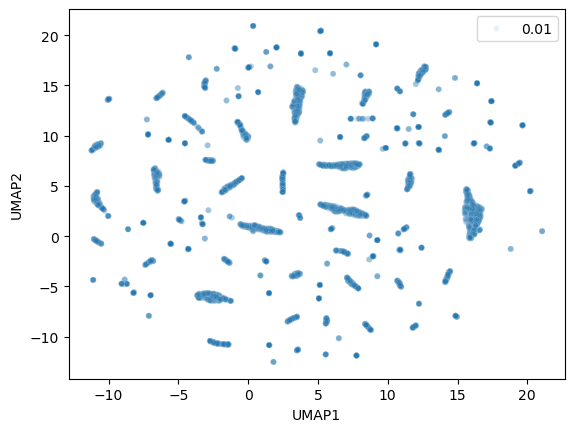

In [22]:
# Scatter plot of UMAP1 vs UMAP2

sns.scatterplot(data=Umap, x="UMAP1", y="UMAP2", size=0.01, alpha = 0.1)

# save the plot

plt.savefig(f"{output_dir}/UMAPTest.png")


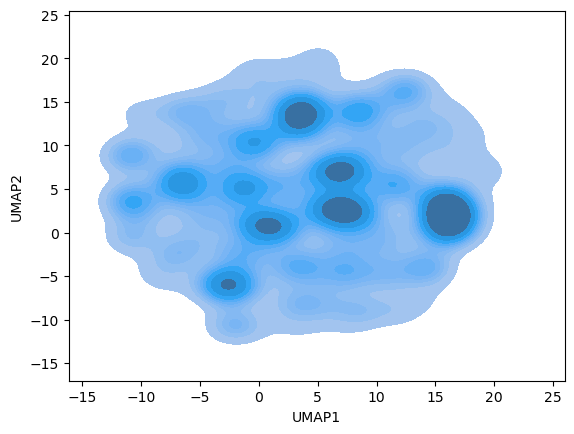

In [23]:
# Density plot of UMAP1 vs UMAP2

sns.kdeplot(data=Umap, x="UMAP1", y="UMAP2", fill=True)

# save the plot

plt.savefig(f"{output_dir}/UMAPTest_density.png")

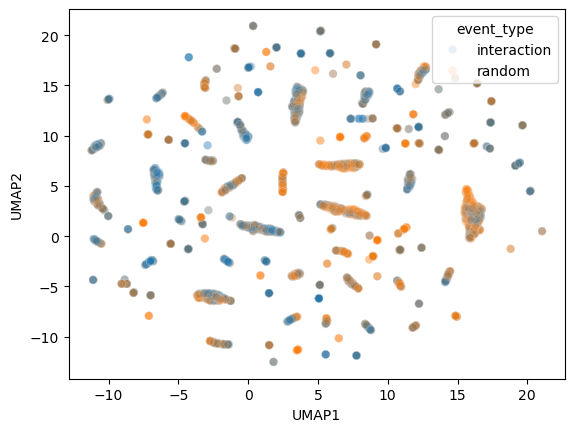

In [24]:
# Color code by event_type

sns.scatterplot(data=Umap, x="UMAP1", y="UMAP2", alpha = 0.1, hue="event_type")

# Save the plot

plt.savefig(f"{output_dir}/UMAP_event_types.png")

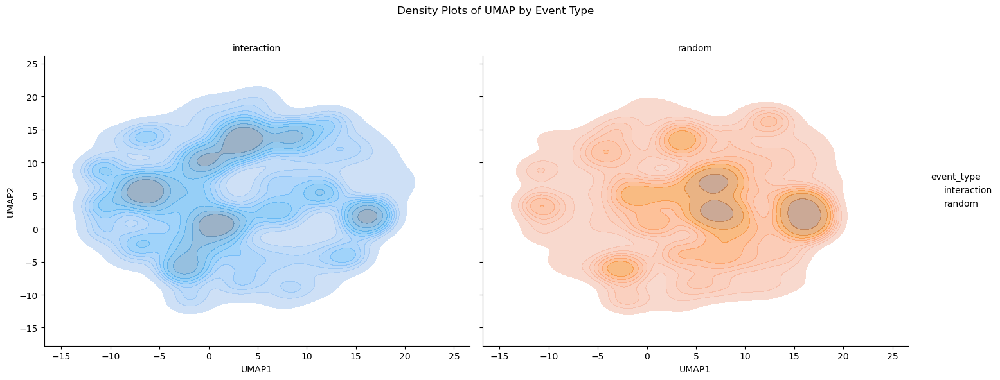

In [25]:
# Create a FacetGrid with two columns, one for each event_type
g = sns.FacetGrid(Umap, col="event_type", hue="event_type", sharex=True, sharey=True, height=6, aspect=1.2)

# Map the kdeplot to the FacetGrid
g.map(sns.kdeplot, "UMAP1", "UMAP2", fill=True, alpha=0.5)

# Add titles and adjust layout
g.set_titles(col_template="{col_name}")
g.add_legend()
plt.subplots_adjust(top=0.85)
g.fig.suptitle("Density Plots of UMAP by Event Type")

# Save the plot
plt.savefig(f"{output_dir}/UMAP_event_types_density.png")
plt.show()
plt.close()

# Checks

Umap as function of event duration

<Axes: xlabel='UMAP1', ylabel='UMAP2'>

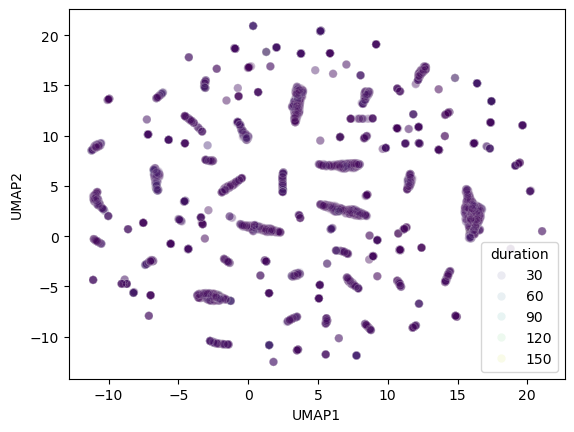

In [19]:
# Color code by duration

sns.scatterplot(data=Umap, x="UMAP1", y="UMAP2", alpha=0.1, hue="duration", palette="viridis")

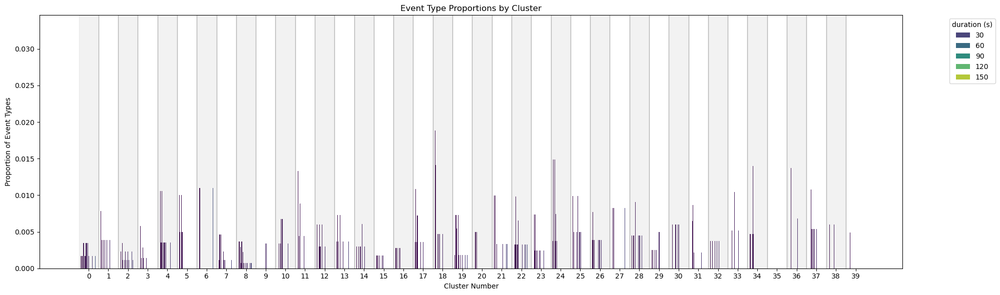

In [21]:
# Get unique clusters
unique_clusters = Umap["cluster"].unique()


# Initialize a DataFrame to store the proportions
proportions_df = pd.DataFrame()

# Process each cluster
for cluster_id in unique_clusters:
    cluster_data = Umap[Umap["cluster"] == cluster_id]

    # Count event types and calculate proportions
    event_counts = cluster_data["duration"].value_counts(normalize=True).reset_index()
    event_counts.columns = ["duration", "proportion"]
    event_counts["cluster"] = cluster_id

    # Append to the proportions DataFrame
    proportions_df = pd.concat([proportions_df, event_counts], ignore_index=True)

clusters = sorted(proportions_df["cluster"].unique())


# Plot event type proportions as bar plots
plt.figure(figsize=(20, 6))
sns.barplot(data=proportions_df, x="cluster", y="proportion", hue="duration", palette="viridis")
plt.title("Event Type Proportions by Cluster")
plt.xlabel("Cluster Number")
plt.ylabel("Proportion of Event Types")
plt.legend(title="duration (s)", bbox_to_anchor=(1.05, 1), loc="upper left")

# Add vertical lines between cluster groups
for i in range(len(clusters) - 1):
    plt.axvline(x=i + 0.5, color="gray", linestyle="-", alpha=0.5, linewidth=1)

# Add alternating background for easier visual grouping
for i in range(len(clusters)):
    if i % 2 == 0:  # Every other cluster gets a light background
        plt.axvspan(i - 0.5, i + 0.5, alpha=0.1, color="gray")


plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/duration_proportions_by_cluster.png")
plt.show()
plt.close()

# Clustering

In [26]:
Umap["cluster"].unique()

array([29, 36, 16, 39, 33,  8,  3, 14,  5, 20,  7, 12, 19, 15,  2, 17, 22,
       25, 27, 28, 31,  0, 37,  1, 21,  4, 26, 18, 13, 32, 23, 10, 11,  6,
       35, 30,  9, 24, 34, 38], dtype=int32)

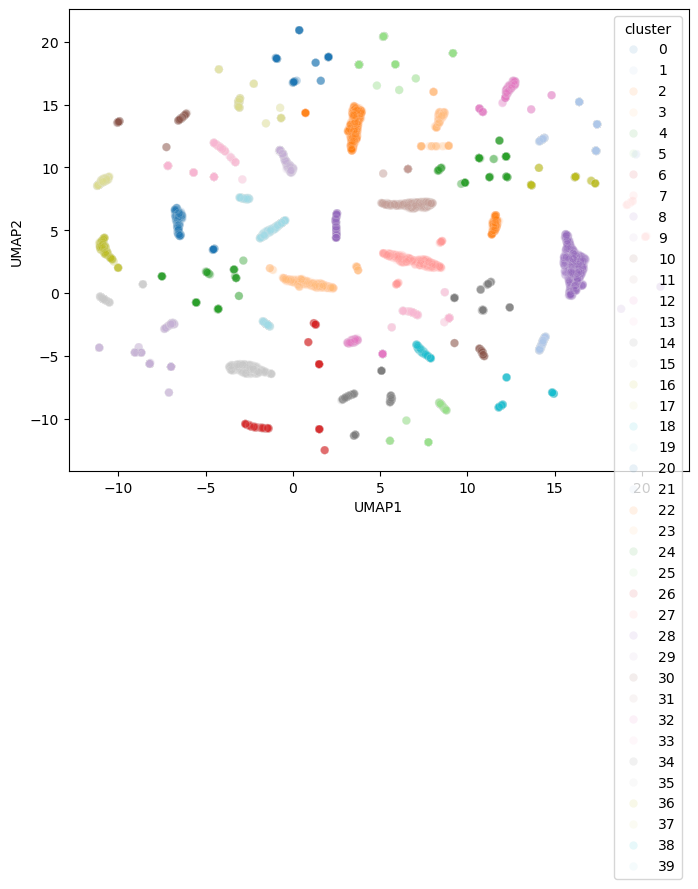

In [27]:

plt.figure(figsize=(8, 6))

sns.scatterplot(data=Umap, x="UMAP1", y="UMAP2", alpha = 0.1, hue="cluster", palette="tab20")

# Save the plot

plt.savefig(f"{output_dir}/UMAP_Clusters.png")

In [ ]:
# Same with density

plt.figure(figsize=(8, 6))

sns.kdeplot(data=Umap, x="UMAP1", y="UMAP2", fill=True, alpha=0.5, hue="cluster", palette="tab10")

plt.savefig(f"{output_dir}/UMAP_Clusters_density.png")

In [ ]:
# Get columns that do not have "centre" in their name

Umap.columns[~Umap.columns.str.contains("centre")]

# Looking into particular conditions

## Light

In [114]:
interaction_data = Umap[Umap["event_type"] == "interaction"].copy()

In [115]:
# Check Light values:

interaction_data["Light"].unique()

# Check how many values for each light level

interaction_data["Light"].value_counts()

Light
on     4567
off    2327
Name: count, dtype: int64

In [116]:
# Make a subset of the data with only "on" and "off" light values

Umap_light = interaction_data[interaction_data["Light"].isin(["off", "on"])]

<Axes: xlabel='UMAP1', ylabel='UMAP2'>

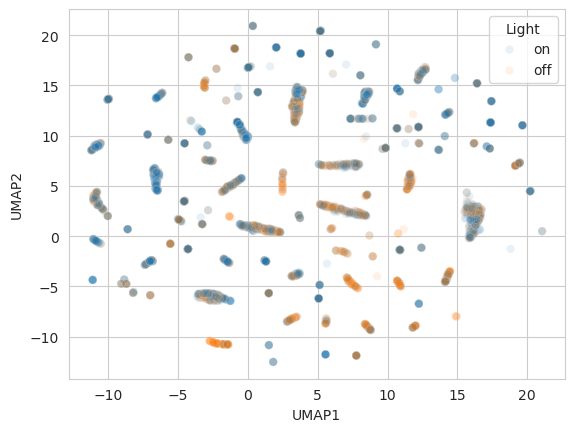

In [117]:
sns.scatterplot(
    data=Umap_light, x="UMAP1", y="UMAP2", alpha=0.1, hue="Light", palette="tab10"
)

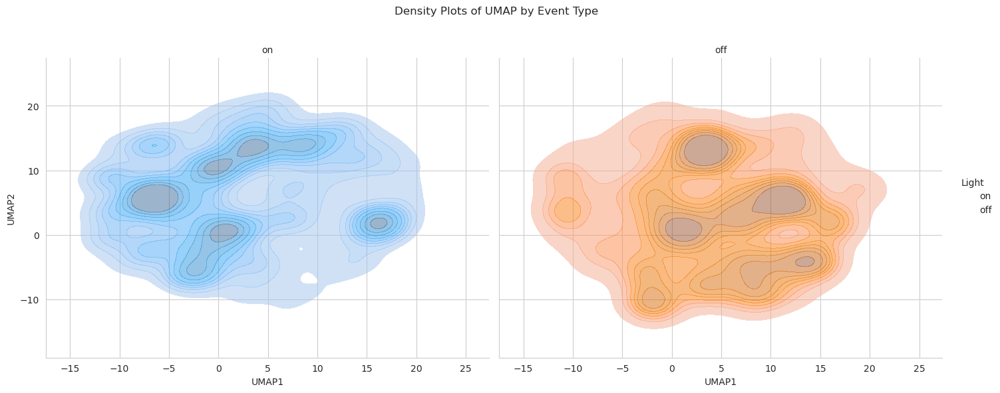

In [118]:
# Create a FacetGrid with two columns, one for each event_type
g = sns.FacetGrid(
    Umap_light, col="Light", hue="Light", sharex=True, sharey=True, height=6, aspect=1.2
)

# Map the kdeplot to the FacetGrid
g.map(sns.kdeplot, "UMAP1", "UMAP2", fill=True, alpha=0.5)

# Add titles and adjust layout
g.set_titles(col_template="{col_name}")
g.add_legend()
plt.subplots_adjust(top=0.85)
g.fig.suptitle("Density Plots of UMAP by Event Type")

# Save the plot
plt.savefig(f"{output_dir}/UMAP_LightConditions_Density.png")
plt.show()
plt.close()

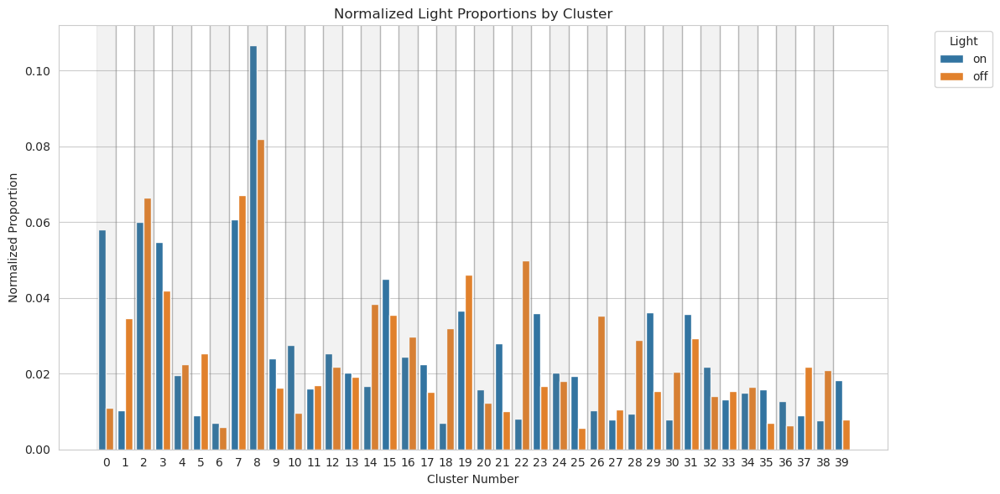

In [119]:
calculate_and_plot_normalized_proportions(
    data=Umap,
    group_by_column="cluster",
    metadata_column="Light",
    normalize_by_column="Light",
    output_dir=output_dir,
    title="Normalized Light Proportions by Cluster",
    xlabel="Cluster Number",
    ylabel="Normalized Proportion",
    save_filename="normalized_light_proportions_by_cluster.png",
)

In [275]:
from scipy.stats import chi2_contingency

# Downsample Light on to match Light off
light_off = interaction_data[interaction_data["Light"] == "off"]
light_on = interaction_data[interaction_data["Light"] == "on"].sample(n=len(light_off), random_state=42)
Umap_balanced = pd.concat([light_off, light_on])

contingency_table = pd.crosstab(Umap_balanced["cluster"], Umap_balanced["Light"])
chi2, p, dof, expected = chi2_contingency(contingency_table)
print(f"Overall association p-value: {p:.4f}")

Overall association p-value: 0.0000


In [276]:
contingency_tables = pd.crosstab(Umap_balanced["cluster"], Umap_balanced["Light"])

# for cluster in clusters:
#     cluster_data = contingency_table.loc[cluster]
#     other_data = contingency_table.drop(cluster).sum()
#     _, p = fisher_exact([cluster_data, other_data])
#     print(f"Cluster {cluster} vs others: p={p:.4f}")

In [277]:
residuals = (contingency_table - expected) / np.sqrt(expected)

residuals

Light,off,on
cluster,,
0,-8.512565,8.512565
1,4.978009,-4.978009
2,1.312785,-1.312785
3,-0.597614,0.597614
4,-0.845154,0.845154
5,4.160251,-4.160251
6,-0.773021,0.773021
7,3.815992,-3.815992
8,-2.959320,2.959320


In [278]:
clusters = sorted(contingency_table.index)
p_values = []

for cluster in clusters:
    cluster_data = contingency_table.loc[cluster]
    other_data = contingency_table.drop(cluster).sum()
    _, p = fisher_exact([cluster_data, other_data])
    p_values.append(p)

# Bonferroni correction
adjusted_alpha = 0.05 / len(clusters)
significant_clusters = [clusters[i] for i, p in enumerate(p_values) if p < adjusted_alpha]

print(f"Significant clusters (Bonferroni α={adjusted_alpha:.6f}): {significant_clusters}")

Significant clusters (Bonferroni α=0.001250): [0, 1, 5, 7, 8, 10, 14, 18, 21, 22, 23, 25, 26, 28, 29, 30, 37, 39]


In [279]:
# Generate significance annotations
significance_annotations = {}
for cluster, p_value in zip(clusters, p_values):
    if p_value < 0.001:
        significance_annotations[cluster] = "***"
    elif p_value < 0.01:
        significance_annotations[cluster] = "**"
    elif p_value < 0.05:
        significance_annotations[cluster] = "*"
    else:
        significance_annotations[cluster] = "n.s"

In [280]:
from statsmodels.stats.multitest import multipletests

# Benjamini-Hochberg FDR correction
rejected, corrected_p, _, _ = multipletests(p_values, alpha=0.05, method="fdr_bh")

significant_clusters_fdr = [clusters[i] for i, rejected in enumerate(rejected) if rejected]
print(f"FDR-significant clusters: {significant_clusters_fdr}")

FDR-significant clusters: [0, 1, 5, 7, 8, 9, 10, 13, 14, 15, 16, 18, 21, 22, 23, 25, 26, 27, 28, 29, 30, 33, 35, 37, 38, 39]


In [281]:
for cluster in clusters:
    cluster_data = contingency_table.loc[cluster]
    other_data = contingency_table.drop(cluster).sum()
    odds_ratio, _ = fisher_exact([cluster_data, other_data])
    print(f"Cluster {cluster}: OR={odds_ratio:.2f}")

Cluster 0: OR=0.15
Cluster 1: OR=4.11
Cluster 2: OR=1.23
Cluster 3: OR=0.90
Cluster 4: OR=0.75
Cluster 5: OR=3.83
Cluster 6: OR=0.71
Cluster 7: OR=2.44
Cluster 8: OR=0.57
Cluster 9: OR=0.65
Cluster 10: OR=0.29
Cluster 11: OR=1.93
Cluster 12: OR=0.67
Cluster 13: OR=0.38
Cluster 14: OR=2.76
Cluster 15: OR=0.63
Cluster 16: OR=1.56
Cluster 17: OR=0.98
Cluster 18: OR=11.29
Cluster 19: OR=1.34
Cluster 20: OR=0.82
Cluster 21: OR=0.43
Cluster 22: OR=9.33
Cluster 23: OR=0.40
Cluster 24: OR=0.82
Cluster 25: OR=0.25
Cluster 26: OR=6.62
Cluster 27: OR=1.87
Cluster 28: OR=9.43
Cluster 29: OR=0.38
Cluster 30: OR=4.58
Cluster 31: OR=1.00
Cluster 32: OR=1.00
Cluster 33: OR=3.86
Cluster 34: OR=1.14
Cluster 35: OR=0.45
Cluster 36: OR=0.70
Cluster 37: OR=3.27
Cluster 38: OR=2.64
Cluster 39: OR=0.39


In [282]:
odds_ratios = []
ci_lower = []
ci_upper = []

z = 1.96  # For 95% confidence interval

# Iterate over each cluster in the contingency table
for cluster in contingency_table.index:
    # Extract the 2x2 table for the current cluster
    cluster_data = contingency_table.loc[cluster]
    other_data = contingency_table.drop(cluster).sum()

    # Create a 2x2 table
    table = [[cluster_data["off"], cluster_data["on"]], [other_data["off"], other_data["on"]]]

    # Extract values from the table
    a, b = table[0]
    c, d = table[1]

    # Calculate odds ratio
    odds_ratio = (a * d) / (b * c)
    odds_ratios.append(odds_ratio)

    # Calculate standard error
    se = np.sqrt(1 / a + 1 / b + 1 / c + 1 / d)

    # Log-transform the odds ratio
    log_or = np.log(odds_ratio)

    # Compute CI in log space
    log_ci_lower = log_or - z * se
    log_ci_upper = log_or + z * se

    # Transform back to original scale
    ci_lower.append(np.exp(log_ci_lower))
    ci_upper.append(np.exp(log_ci_upper))

# Print results
for i, cluster in enumerate(contingency_table.index):
    print(f"Cluster {cluster}: OR={odds_ratios[i]:.2f}, CI=({ci_lower[i]:.2f}, {ci_upper[i]:.2f})")

Cluster 0: OR=0.15, CI=(0.10, 0.21)
Cluster 1: OR=4.11, CI=(2.71, 6.25)
Cluster 2: OR=1.23, CI=(1.00, 1.52)
Cluster 3: OR=0.90, CI=(0.72, 1.14)
Cluster 4: OR=0.75, CI=(0.46, 1.20)
Cluster 5: OR=3.83, CI=(2.38, 6.15)
Cluster 6: OR=0.71, CI=(0.38, 1.32)
Cluster 7: OR=2.44, CI=(1.76, 3.38)
Cluster 8: OR=0.57, CI=(0.44, 0.74)
Cluster 9: OR=0.65, CI=(0.45, 0.92)
Cluster 10: OR=0.29, CI=(0.19, 0.43)
Cluster 11: OR=1.93, CI=(0.96, 3.88)
Cluster 12: OR=0.67, CI=(0.44, 1.02)
Cluster 13: OR=0.38, CI=(0.20, 0.72)
Cluster 14: OR=2.76, CI=(1.86, 4.08)
Cluster 15: OR=0.63, CI=(0.46, 0.85)
Cluster 16: OR=1.56, CI=(1.07, 2.27)
Cluster 17: OR=0.98, CI=(0.68, 1.42)
Cluster 18: OR=11.29, CI=(4.89, 26.10)
Cluster 19: OR=1.34, CI=(0.97, 1.85)
Cluster 20: OR=0.82, CI=(0.52, 1.31)
Cluster 21: OR=0.43, CI=(0.28, 0.67)
Cluster 22: OR=9.33, CI=(5.78, 15.05)
Cluster 23: OR=0.40, CI=(0.29, 0.56)
Cluster 24: OR=0.82, CI=(0.54, 1.24)
Cluster 25: OR=0.25, CI=(0.15, 0.43)
Cluster 26: OR=6.62, CI=(3.90, 11.25)
Cluster

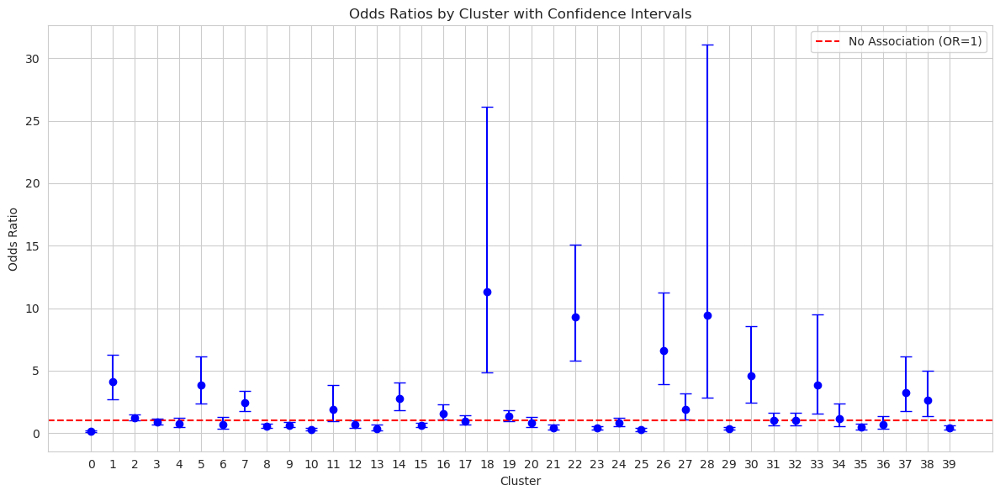

In [283]:
plt.figure(figsize=(12, 6))
for i, cluster in enumerate(clusters):
    plt.errorbar(
        i,
        odds_ratios[i],
        yerr=[[odds_ratios[i] - ci_lower[i]], [ci_upper[i] - odds_ratios[i]]],
        fmt="o",
        capsize=5,
        color="blue",
    )

plt.axhline(1, color="red", linestyle="--", label="No Association (OR=1)")
plt.xticks(range(len(clusters)), clusters)
plt.title("Odds Ratios by Cluster with Confidence Intervals")
plt.xlabel("Cluster")
plt.ylabel("Odds Ratio")
plt.legend()
plt.tight_layout()
plt.show()

An odds ratio (OR) of 12 means that the odds of an event occurring in one group are **12 times higher** than the odds of the event occurring in the comparison group.

### Quantitative Interpretation:
1. **Odds Ratio > 1**: The event is more likely in the first group compared to the second group.
   - For OR = 12, the event is **12 times more likely** in the first group.
   
2. **Odds Ratio = 1**: The event is equally likely in both groups (no association).

3. **Odds Ratio < 1**: The event is less likely in the first group compared to the second group.

### Example:
If you are comparing two light conditions (e.g., "on" vs. "off") for a specific cluster:
- OR = 12 means that the odds of the cluster being associated with "on" light are 12 times higher than with "off" light.

### Important Notes:
- **Odds vs. Probability**: Odds are not the same as probability. Odds are the ratio of the probability of an event occurring to it not occurring.
- **Confidence Intervals**: Always consider the confidence interval (CI) of the OR to assess the precision of the estimate. If the CI includes 1, the OR is not statistically significant.
- **Context**: The magnitude of the OR should be interpreted in the context of the study. An OR of 12 might indicate a strong association, but its importance depends on the domain and practical implications.

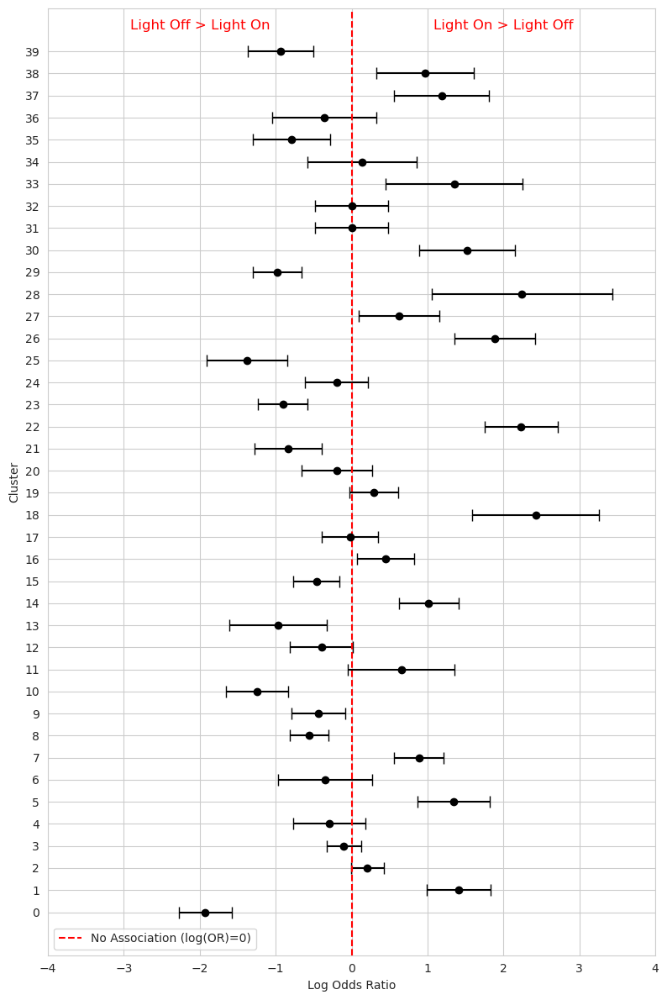

In [286]:
import numpy as np
import matplotlib.pyplot as plt

# Log-transform the odds ratios and confidence intervals
log_odds_ratios = np.log(odds_ratios)
log_ci_lower = np.log(ci_lower)
log_ci_upper = np.log(ci_upper)

# Plot the log-transformed odds ratios (rotated)
plt.figure(figsize=(8, 12))
for i, cluster in enumerate(clusters):
    plt.errorbar(
        log_odds_ratios[i],
        i,
        xerr=[[log_odds_ratios[i] - log_ci_lower[i]], [log_ci_upper[i] - log_odds_ratios[i]]],
        fmt="o",
        capsize=5,
        color="black",
    )

# Add a vertical line at 0 (log(OR=1))
plt.axvline(0, color="red", linestyle="--", label="No Association (log(OR)=0)")

# Add "Off" and "On" labels
plt.text(-2, len(clusters), "Light Off > Light On", color="red", fontsize=12, ha="center", rotation=0)
plt.text(2, len(clusters), "Light On > Light Off", color="red", fontsize=12, ha="center", rotation=0)

# Customize the plot
plt.yticks(range(len(clusters)), clusters)
plt.title("")
plt.ylabel("Cluster")
plt.xlabel("Log Odds Ratio")
plt.legend()
plt.tight_layout()

plt.xlim(-4,4)

plt.savefig(f"{output_dir}/log_odds_ratios_by_cluster.png")
plt.show()

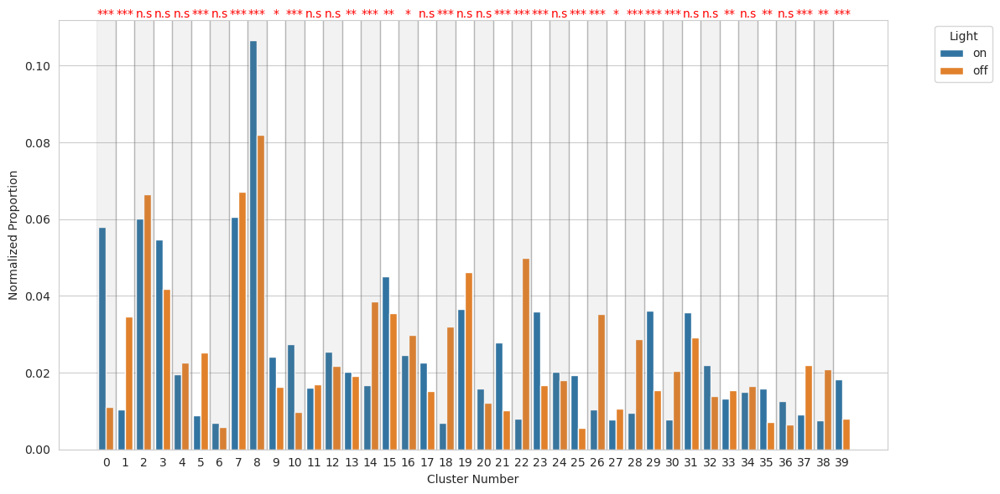

In [161]:
calculate_and_plot_normalized_proportions(
    data=Umap,
    group_by_column="cluster",
    metadata_column="Light",
    normalize_by_column="Light",
    output_dir=output_dir,
    significance_annotations=significance_annotations,
    title="",
    xlabel="Cluster Number",
    ylabel="Normalized Proportion",
    save_filename="normalized_light_proportions_by_cluster.png",
)

In [149]:
# Calculate the total count for each category in the normalize_by_column
total_counts = Umap["Light"].value_counts(normalize=False)

# Initialize a DataFrame to store the normalized proportions
proportions_df = pd.DataFrame()

# Process each normalization group (e.g., each light condition)
for normalize_group in Umap["Light"].unique():
    group_data = Umap[Umap["Light"] == normalize_group]

    # Get unique clusters within this group
    unique_clusters = group_data["cluster"].unique()

    # Process each cluster
    for cluster_id in unique_clusters:
        cluster_data = group_data[group_data["cluster"] == cluster_id]

        # Count metadata types and calculate proportions
        metadata_counts = cluster_data["Light"].value_counts(normalize=False).reset_index()
        metadata_counts.columns = ["Light", "proportion"]

        # Normalize by the total count of the category
        if normalize_group in total_counts:
            metadata_counts["normalized_proportion"] = metadata_counts["proportion"] / total_counts[normalize_group]
        else:
            metadata_counts["normalized_proportion"] = 0  # Handle missing groups gracefully

        metadata_counts["cluster"] = cluster_id
        metadata_counts["Light"] = normalize_group

        # Append to the proportions DataFrame
        proportions_df = pd.concat([proportions_df, metadata_counts], ignore_index=True)

clusters = sorted(Umap["cluster"].unique())

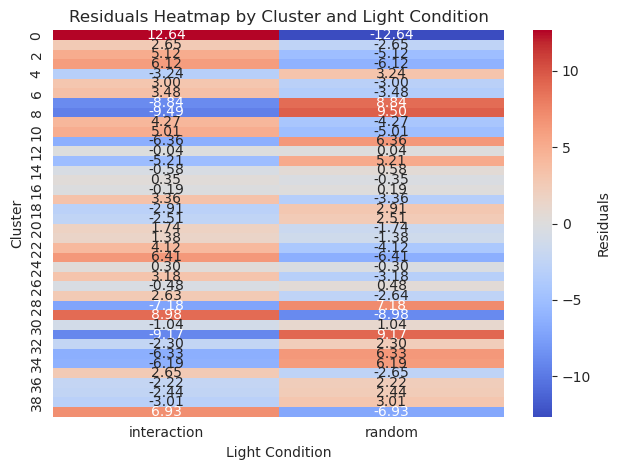

In [151]:
import seaborn as sns

# Example: Heatmap of residuals
sns.heatmap(residuals, annot=True, cmap="coolwarm", fmt=".2f", cbar_kws={"label": "Residuals"})
plt.title("Residuals Heatmap by Cluster and Light Condition")
plt.xlabel("Light Condition")
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

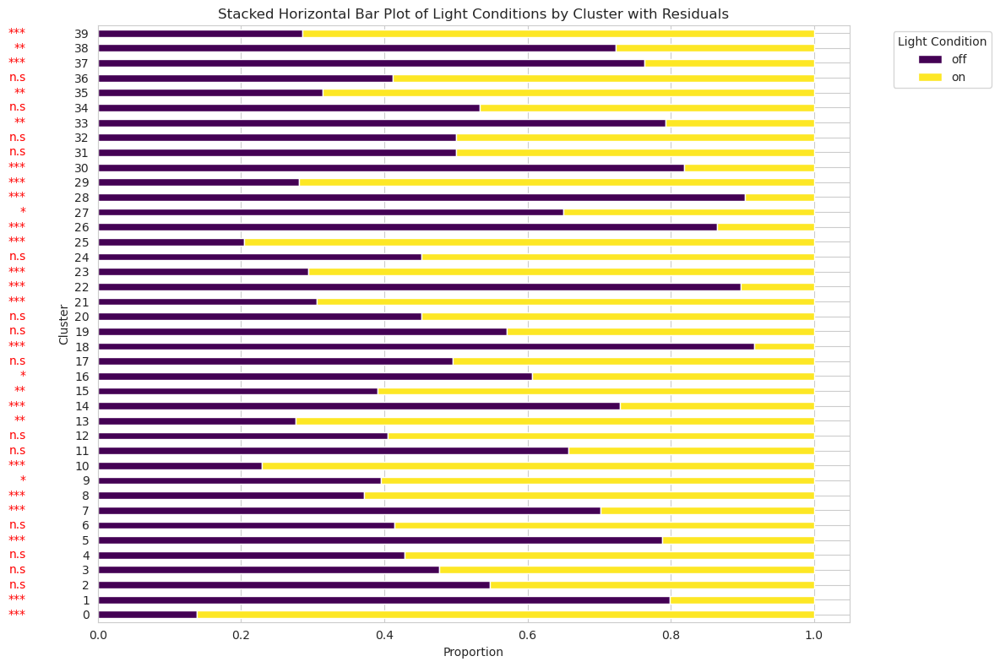

In [185]:
import matplotlib.pyplot as plt

# Normalize the contingency table to get proportions for Light conditions
proportions = contingency_table.div(contingency_table.sum(axis=1), axis=0)

# Plot the stacked bar plot with Light conditions stacked horizontally
proportions.plot(kind="barh", stacked=True, figsize=(12, 8), colormap="viridis")

# # Add residuals as black lines
# for i, cluster in enumerate(clusters):
#     cumulative_proportion = 0
#     for j, light in enumerate(proportions.columns):
#         cumulative_proportion += proportions.iloc[i, j]
#         # Draw a black line for the residual
#         plt.plot(
#             [cumulative_proportion, cumulative_proportion],
#             [i - 0.4, i + 0.4],  # Adjust the vertical range for the line
#             color="black",
#             linewidth=2 * abs(residuals.iloc[i, j]),  # Line thickness proportional to residual magnitude
#         )

# Add Fisher posthoc annotations next to cluster labels
for i, cluster in enumerate(clusters):
    plt.text(
        -0.1,  # Position slightly to the left of the bars
        i,
        significance_annotations.get(cluster, "n.s"),
        ha="right",
        va="center",
        color="red",
        fontsize=10,
    )

# Customize the plot
plt.title("Stacked Horizontal Bar Plot of Light Conditions by Cluster with Residuals")
plt.xlabel("Proportion")
plt.ylabel("Cluster")
plt.legend(title="Light Condition", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()

plt.savefig(f"{output_dir}/stacked_horizontal_bar_plot_light_conditions.png")
plt.show()

## Feeding State

In [289]:
# Check FeedingState values:

interaction_data["FeedingState"].unique()

# Check how many values for each light level

interaction_data["FeedingState"].value_counts()

FeedingState
starved_noWater    2967
starved            2292
fed                1635
Name: count, dtype: int64

In [290]:
# Rename the feedingstate that are "Fed" to "fed" and make a subset of the data with only "starved", "fed" and "starved_noWater"

interaction_data["FeedingState"] = interaction_data["FeedingState"].replace("Fed", "fed")

Umap_feeding = interaction_data[interaction_data["FeedingState"].isin(["starved", "fed", "starved_noWater"])]
Umap_feeding["FeedingState"].unique()

['starved_noWater', 'fed', 'starved']
Categories (3, object): ['fed', 'starved', 'starved_noWater']

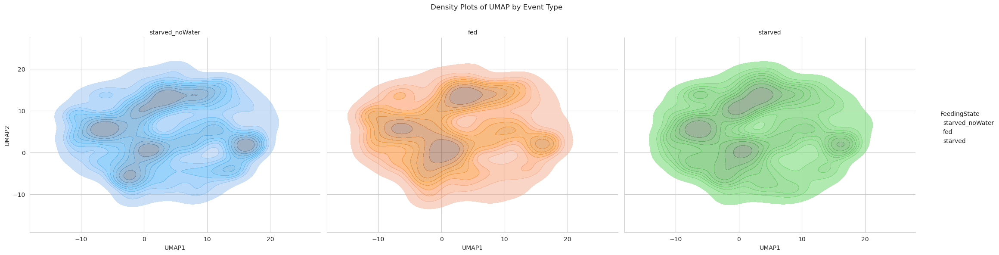

In [134]:
# Create a FacetGrid with two columns, one for each event_type
g = sns.FacetGrid(
    Umap_feeding,
    col="FeedingState",
    hue="FeedingState",
    sharex=True,
    sharey=True,
    height=6,
    aspect=1.2,
)

# Map the kdeplot to the FacetGrid
g.map(sns.kdeplot, "UMAP1", "UMAP2", fill=True, alpha=0.5)

# Add titles and adjust layout
g.set_titles(col_template="{col_name}")
g.add_legend()
plt.subplots_adjust(top=0.85)
g.fig.suptitle("Density Plots of UMAP by Event Type")

# Save the plot
plt.savefig(f"{output_dir}/UMAP_FeedingStateConditions_Density.png")
plt.show()
plt.close()

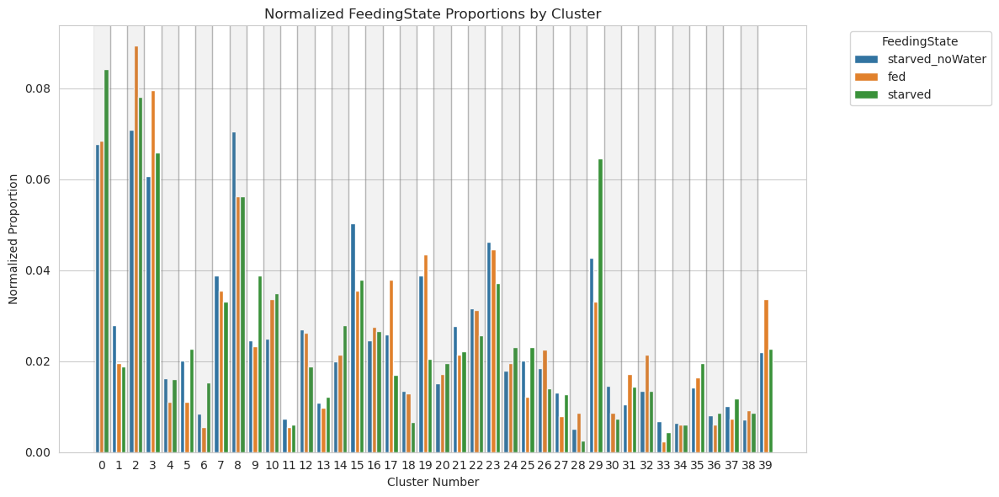

In [135]:
calculate_and_plot_normalized_proportions(
    data=Umap_feeding,
    group_by_column="cluster",
    metadata_column="FeedingState",
    normalize_by_column="FeedingState",
    output_dir=output_dir,
    title="Normalized FeedingState Proportions by Cluster",
    xlabel="Cluster Number",
    ylabel="Normalized Proportion",
    save_filename="normalized_FeedingState_proportions_by_cluster.png",
)

In [292]:
from scipy.stats import chi2_contingency


contingency_table = pd.crosstab(Umap_feeding["cluster"], Umap_feeding["FeedingState"])
chi2, p, dof, expected = chi2_contingency(contingency_table)
print(f"Overall association p-value: {p:.4f}")

Overall association p-value: 0.0000


In [293]:
from itertools import combinations
from statsmodels.stats.multitest import multipletests

# For each cluster, test all FeedingState pairs
clusters = sorted(contingency_table.index)
p_values = []

for cluster in clusters:
    cluster_data = contingency_table.loc[cluster]
    for state1, state2 in combinations(cluster_data.index, 2):
        table = [
            [cluster_data[state1], cluster_data[state2]],
            [contingency_table.drop(cluster).sum()[state1], contingency_table.drop(cluster).sum()[state2]],
        ]
        _, p = fisher_exact(table)
        p_values.append(p)

# Apply Benjamini-Hochberg FDR correction
rejected, corrected_p, _, _ = multipletests(p_values, alpha=0.05, method="fdr_bh")

print(f"FDR-corrected p-values: {corrected_p}")

FDR-corrected p-values: [2.50467976e-01 1.00000000e+00 1.58858996e-01 9.99162845e-01
 2.76608562e-01 1.85768702e-01 4.42383952e-01 1.60916165e-01
 5.69900419e-01 2.94315864e-01 1.52090825e-01 7.42342479e-01
 4.42383952e-01 4.42383952e-01 1.00000000e+00 1.01747299e-01
 1.58858996e-01 8.05721081e-01 8.60792596e-02 6.50084956e-01
 1.58858996e-01 9.05146676e-01 8.33769623e-01 5.51139369e-01
 1.00000000e+00 2.29213608e-01 1.89824655e-01 1.03000091e-01
 9.99162845e-01 7.32106471e-02 9.99162845e-01 2.76608562e-01
 1.86935725e-01 1.00000000e+00 8.08839161e-01 8.33769623e-01
 3.24750135e-01 9.99162845e-01 2.06183284e-01 8.00044619e-01
 9.99162845e-01 8.96619719e-01 4.42383952e-01 9.11599236e-01
 2.17959557e-01 9.05146676e-01 1.58858996e-01 1.85768702e-01
 9.99162845e-01 8.05721081e-01 8.60605289e-01 2.28973686e-03
 1.58858996e-01 1.60916165e-01 2.06183284e-01 9.99162845e-01
 1.51787777e-01 2.28973686e-03 7.25822210e-01 4.23006427e-03
 8.33769623e-01 8.33769623e-01 4.69129796e-01 9.99162845e-01


In [294]:
import statsmodels.api as sm

model = sm.MNLogit(Umap_feeding["FeedingState"], sm.add_constant(Umap_feeding["cluster"]))
result = model.fit()
print(result.summary())

Optimization terminated successfully.
         Current function value: 1.070212
         Iterations 5
                          MNLogit Regression Results                          
Dep. Variable:           FeedingState   No. Observations:                 6894
Model:                        MNLogit   Df Residuals:                     6890
Method:                           MLE   Df Model:                            2
Date:                Wed, 23 Apr 2025   Pseudo R-squ.:               3.051e-05
Time:                        12:09:40   Log-Likelihood:                -7378.0
converged:                       True   LL-Null:                       -7378.3
Covariance Type:            nonrobust   LLR p-value:                    0.7984
        FeedingState=starved       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                            0.3654      0.054      6.799      0.000

In [295]:
contingency_table = pd.crosstab(Umap_feeding["cluster"], Umap_feeding["FeedingState"])

In [296]:
annotations_feedingstate = {}
for cluster, p_value in zip(clusters, p_values):
    if p_value < 0.001:
        annotations_feedingstate[cluster] = "***"
    elif p_value < 0.01:
        annotations_feedingstate[cluster] = "**"
    elif p_value < 0.05:
        annotations_feedingstate[cluster] = "*"
    else:
        annotations_feedingstate[cluster] = "n.s"

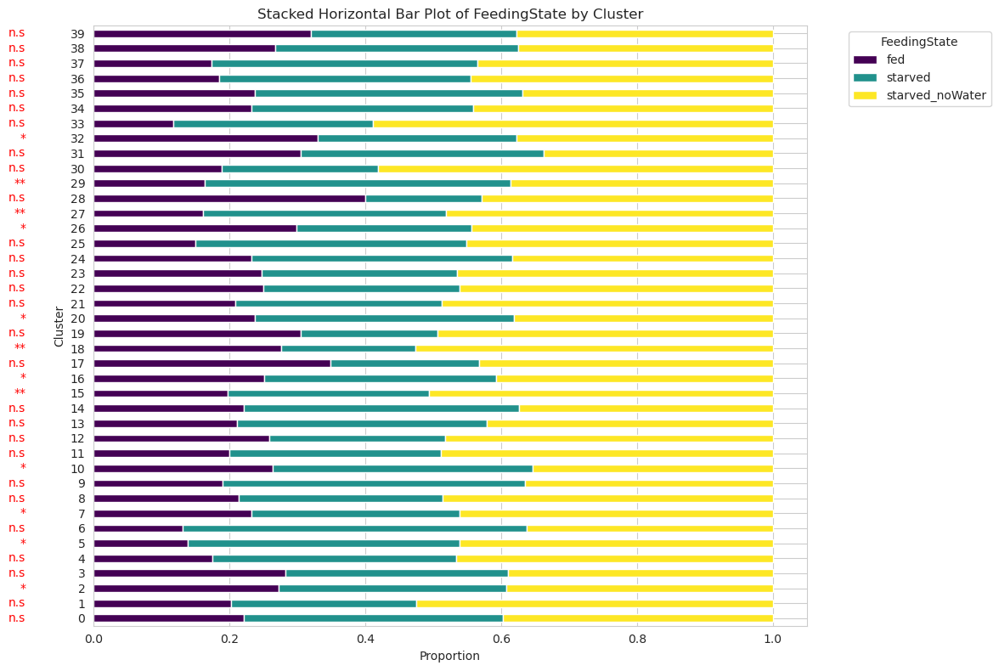

In [297]:
# Normalize the contingency table to get proportions
proportions = contingency_table.div(contingency_table.sum(axis=1), axis=0)

# Plot the stacked bar plot
proportions.plot(kind="barh", stacked=True, figsize=(12, 8), colormap="viridis")

# Add annotations for significance
for i, cluster in enumerate(clusters):
    plt.text(
        -0.1,
        i,
        annotations_feedingstate.get(cluster, "n.s"),
        ha="right",
        va="center",
        color="red",
        fontsize=10,
    )

# Customize the plot
plt.title("Stacked Horizontal Bar Plot of FeedingState by Cluster")
plt.xlabel("Proportion")
plt.ylabel("Cluster")
plt.legend(title="FeedingState", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/stacked_horizontal_bar_plot_feedingstate.png")
plt.show()

In [298]:
from scipy.stats import fisher_exact

# For each cluster, compute ORs against reference ("fed")
log_ors = {"starved": [], "starved_noWater": []}
ci_lowers = {"starved": [], "starved_noWater": []}
ci_uppers = {"starved": [], "starved_noWater": []}

for cluster in clusters:
    # Starved vs Fed
    table_starved = [
        [contingency_table.loc[cluster, "starved"], contingency_table.loc[cluster, "fed"]],
        [
            contingency_table.sum().loc["starved"] - contingency_table.loc[cluster, "starved"],
            contingency_table.sum().loc["fed"] - contingency_table.loc[cluster, "fed"],
        ],
    ]
    or_starved, p = fisher_exact(table_starved)

    # Starved_noWater vs Fed
    table_snw = [
        [contingency_table.loc[cluster, "starved_noWater"], contingency_table.loc[cluster, "fed"]],
        [
            contingency_table.sum().loc["starved_noWater"] - contingency_table.loc[cluster, "starved_noWater"],
            contingency_table.sum().loc["fed"] - contingency_table.loc[cluster, "fed"],
        ],
    ]
    or_snw, p = fisher_exact(table_snw)

    # Log-transform and store
    for key, or_val in zip(["starved", "starved_noWater"], [or_starved, or_snw]):
        log_or = np.log(or_val)
        se = np.sqrt(1 / table[0][0] + 1 / table[0][1] + 1 / table[1][0] + 1 / table[1][1])
        log_ors[key].append(log_or)
        ci_lowers[key].append(log_or - 1.96 * se)
        ci_uppers[key].append(log_or + 1.96 * se)

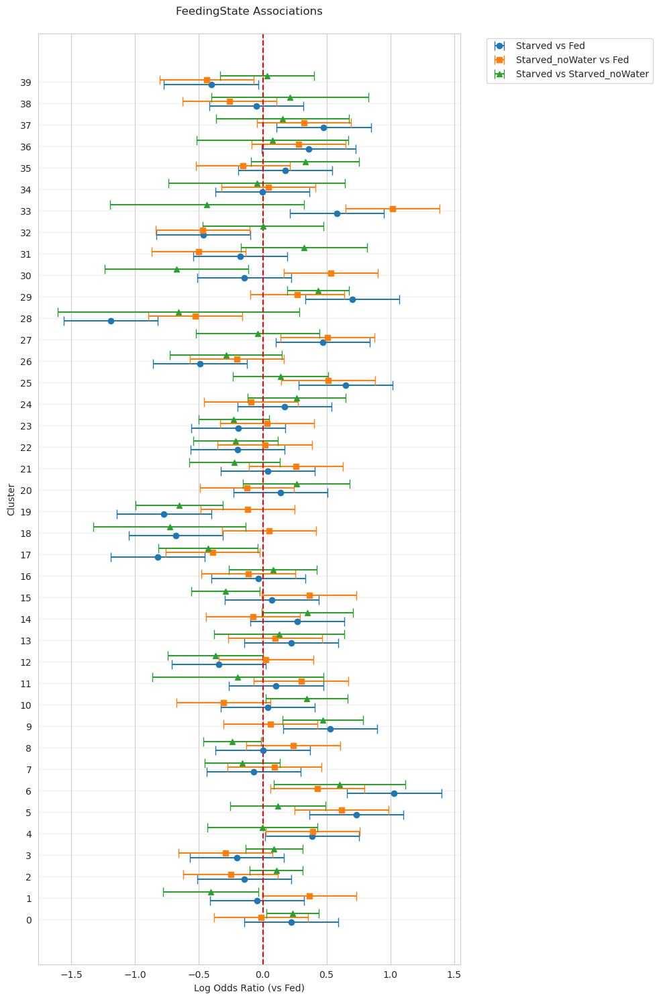

In [299]:
plt.figure(figsize=(10, 15))

# Starved vs Fed
plt.errorbar(
    log_ors["starved"],
    np.arange(len(clusters)) - 0.1,
    xerr=[
        np.array(log_ors["starved"]) - np.array(ci_lowers["starved"]),
        np.array(ci_uppers["starved"]) - np.array(log_ors["starved"]),
    ],
    fmt="o",
    label="Starved vs Fed",
    color="#1f77b4",
    capsize=5,
)

# Starved_noWater vs Fed
plt.errorbar(
    log_ors["starved_noWater"],
    np.arange(len(clusters)) + 0.1,
    xerr=[
        np.array(log_ors["starved_noWater"]) - np.array(ci_lowers["starved_noWater"]),
        np.array(ci_uppers["starved_noWater"]) - np.array(log_ors["starved_noWater"]),
    ],
    fmt="s",
    label="Starved_noWater vs Fed",
    color="#ff7f0e",
    capsize=5,
)

# Initialize lists for starved vs starved_noWater
log_ors["starved_vs_snw"] = []
ci_lowers["starved_vs_snw"] = []
ci_uppers["starved_vs_snw"] = []

for cluster in clusters:
    # Starved vs Starved_noWater
    table_snw_starved = [
        [contingency_table.loc[cluster, "starved"], contingency_table.loc[cluster, "starved_noWater"]],
        [
            contingency_table.sum().loc["starved"] - contingency_table.loc[cluster, "starved"],
            contingency_table.sum().loc["starved_noWater"] - contingency_table.loc[cluster, "starved_noWater"],
        ],
    ]
    or_snw_starved, p = fisher_exact(table_snw_starved)

    # Log-transform and store
    log_or = np.log(or_snw_starved)
    se = np.sqrt(
        1 / table_snw_starved[0][0]
        + 1 / table_snw_starved[0][1]
        + 1 / table_snw_starved[1][0]
        + 1 / table_snw_starved[1][1]
    )

    log_ors["starved_vs_snw"].append(log_or)
    ci_lowers["starved_vs_snw"].append(log_or - 1.96 * se)
    ci_uppers["starved_vs_snw"].append(log_or + 1.96 * se)

plt.errorbar(
    log_ors["starved_vs_snw"],
    np.arange(len(clusters)) + 0.3,
    xerr=[
        np.array(log_ors["starved_vs_snw"]) - np.array(ci_lowers["starved_vs_snw"]),
        np.array(ci_uppers["starved_vs_snw"]) - np.array(log_ors["starved_vs_snw"]),
    ],
    fmt="^",  # Triangle marker
    label="Starved vs Starved_noWater",
    color="#2ca02c",  # Viridis green
    capsize=5,
)


plt.axvline(0, color="red", linestyle="--")
plt.yticks(range(len(clusters)), clusters)
plt.xlabel("Log Odds Ratio (vs Fed)")
plt.ylabel("Cluster")
plt.legend(bbox_to_anchor=(1.05, 1))
plt.grid(axis="y", alpha=0.3)
plt.title("FeedingState Associations", pad=20)
plt.tight_layout()
plt.savefig("feedingstate_log_odds.png", dpi=300)

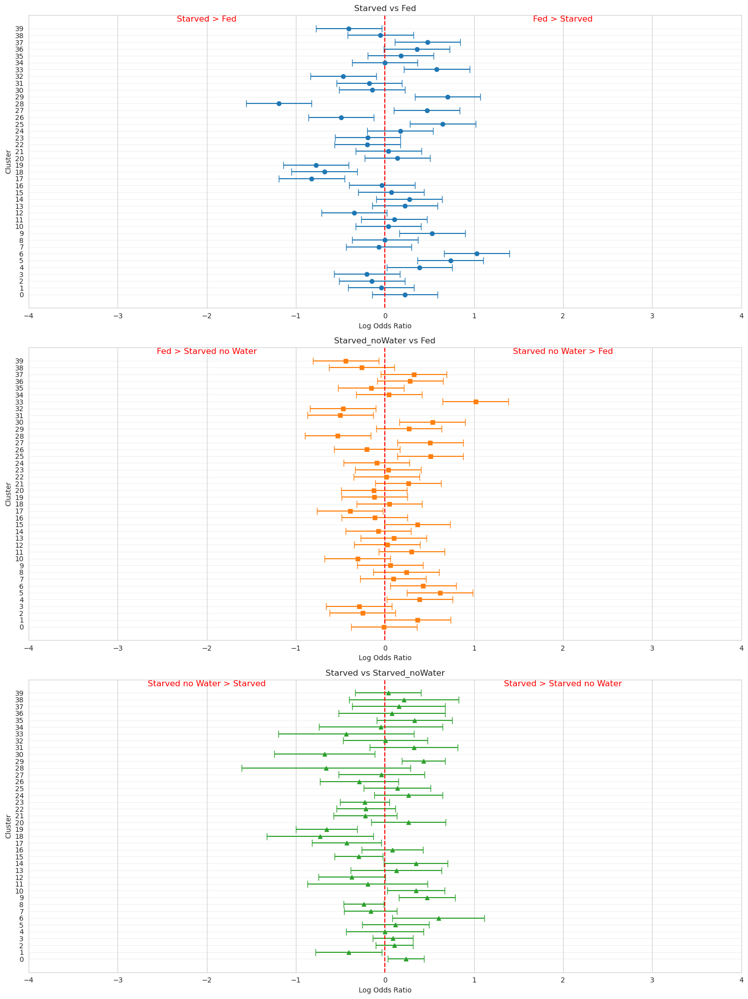

In [304]:
plt.figure(figsize=(15, 20))

# Subplot 1: Starved vs Fed
plt.subplot(3, 1, 1)
plt.errorbar(
    log_ors["starved"],
    np.arange(len(clusters)),
    xerr=[
        np.array(log_ors["starved"]) - np.array(ci_lowers["starved"]),
        np.array(ci_uppers["starved"]) - np.array(log_ors["starved"]),
    ],
    fmt="o",
    label="Starved vs Fed",
    color="#1f77b4",
    capsize=5,
)
# Add explanatory text for negative and positive values
plt.text(-2, len(clusters), "Starved > Fed", color="red", fontsize=12, ha="center", rotation=0)
plt.text(2, len(clusters), "Fed > Starved", color="red", fontsize=12, ha="center", rotation=0)

plt.xlim(-4, 4)
plt.axvline(0, color="red", linestyle="--")
plt.yticks(range(len(clusters)), clusters)
plt.xlabel("Log Odds Ratio")
plt.ylabel("Cluster")
plt.title("Starved vs Fed")
plt.grid(axis="y", alpha=0.3)
# Remove the legend from the first subplot
plt.legend()
plt.gca().get_legend().remove()

# Subplot 2: Starved_noWater vs Fed
plt.subplot(3, 1, 2)
plt.errorbar(
    log_ors["starved_noWater"],
    np.arange(len(clusters)),
    xerr=[
        np.array(log_ors["starved_noWater"]) - np.array(ci_lowers["starved_noWater"]),
        np.array(ci_uppers["starved_noWater"]) - np.array(log_ors["starved_noWater"]),
    ],
    fmt="s",
    label="Starved_noWater vs Fed",
    color="#ff7f0e",
    capsize=5,
)

# Add explanatory text for negative and positive values
plt.text(-2, len(clusters), "Fed > Starved no Water", color="red", fontsize=12, ha="center", rotation=0)
plt.text(2, len(clusters), "Starved no Water > Fed", color="red", fontsize=12, ha="center", rotation=0)

plt.xlim(-4, 4)
plt.axvline(0, color="red", linestyle="--")
plt.yticks(range(len(clusters)), clusters)
plt.xlabel("Log Odds Ratio")
plt.ylabel("Cluster")
plt.title("Starved_noWater vs Fed")
plt.grid(axis="y", alpha=0.3)
plt.legend()
plt.gca().get_legend().remove()

# Subplot 3: Starved vs Starved_noWater
plt.subplot(3, 1, 3)
plt.errorbar(
    log_ors["starved_vs_snw"],
    np.arange(len(clusters)),
    xerr=[
        np.array(log_ors["starved_vs_snw"]) - np.array(ci_lowers["starved_vs_snw"]),
        np.array(ci_uppers["starved_vs_snw"]) - np.array(log_ors["starved_vs_snw"]),
    ],
    fmt="^",
    label="Starved vs Starved_noWater",
    color="#2ca02c",
    capsize=5,
)

# Add explanatory text for negative and positive values
plt.text(-2, len(clusters), "Starved no Water > Starved", color="red", fontsize=12, ha="center", rotation=0)
plt.text(2, len(clusters), "Starved > Starved no Water", color="red", fontsize=12, ha="center", rotation=0)

plt.xlim(-4, 4)
plt.axvline(0, color="red", linestyle="--")
plt.yticks(range(len(clusters)), clusters)
plt.xlabel("Log Odds Ratio")
plt.ylabel("Cluster")
plt.title("Starved vs Starved_noWater")
plt.grid(axis="y", alpha=0.3)
plt.legend()
plt.gca().get_legend().remove()

plt.tight_layout()
plt.savefig("feedingstate_log_odds_subplots.png", dpi=300)
plt.show()

<Axes: xlabel='FeedingState', ylabel='cluster'>

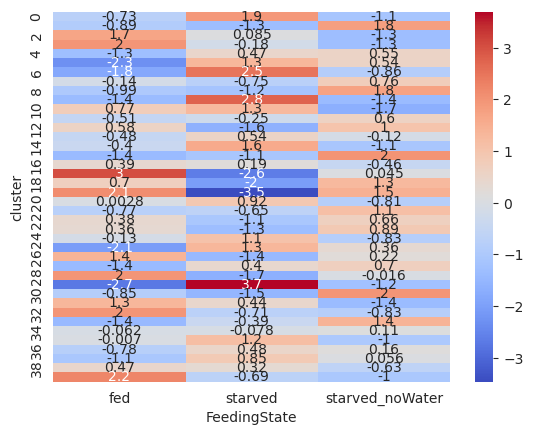

In [245]:
residuals = (contingency_table - expected) / np.sqrt(expected)
sns.heatmap(residuals, annot=True, cmap="coolwarm")  # Highlight |residuals| > 2[9]

In [246]:
# Example for starved vs. fed
log_odds = np.log(odds_ratios)
plt.errorbar(log_odds, clusters, xerr=ci_log_odds, fmt="o")
plt.axvline(0, linestyle="--", color="grey")
plt.xlabel("Log Odds Ratio (Starved vs. Fed)")

NameError: name 'ci_log_odds' is not defined

In [218]:
print(type(result.params))

<class 'pandas.core.frame.DataFrame'>


In [223]:
import numpy as np

conf = result.conf_int()
conf.columns = ["lower", "upper"]
conf = conf.apply(np.exp)  # Exponentiate to get odds ratio scale
print(conf)

                       lower     upper
FeedingState                          
starved         1   0.850341  2.123460
                2   0.985320  1.525538
                3   0.918739  1.468504
                4   1.170356  3.610277
                5   1.690254  4.937529
...                      ...       ...
starved_noWater 35  0.959221  2.522622
                36  1.147706  5.018707
                37  1.279969  4.882932
                38  0.721721  2.715731
                39  0.825279  1.692390

[78 rows x 2 columns]


In [230]:
# Inspect column names
print("Odds Ratios Columns:", odds_ratios_reset.columns)
print("Confidence Intervals Columns:", conf_reset.columns)

# Adjust merge keys based on actual column names
merge_keys = ["FeedingState", "index"]  # Update this if column names differ
if all(key in odds_ratios_reset.columns for key in merge_keys) and all(key in conf_reset.columns for key in merge_keys):
    merged_data = pd.merge(odds_ratios_reset, conf_reset, on=merge_keys)
else:
    raise KeyError(f"Merge keys {merge_keys} not found in both DataFrames.")

Odds Ratios Columns: Index(['index', 0, 1], dtype='object')
Confidence Intervals Columns: Index(['FeedingState', 'level_1', 'lower', 'upper'], dtype='object')


KeyError: "Merge keys ['FeedingState', 'index'] not found in both DataFrames."

In [ ]:

# Extract the necessary columns for plotting
odds_ratios = merged_data["odds_ratios"]
ci_lower = merged_data["lower"]
ci_upper = merged_data["upper"]
categories = merged_data["index"]

# Plot the data
plt.figure(figsize=(10, 6))
plt.errorbar(
    odds_ratios,
    range(len(categories)),
    xerr=[odds_ratios - ci_lower, ci_upper - odds_ratios],
    fmt="o",
    capsize=5,
    color="blue",
)

# Add a vertical line at OR=1 (no effect)
plt.axvline(1, color="red", linestyle="--", label="No Association (OR=1)")

# Customize the plot
plt.yticks(range(len(categories)), categories)
plt.xlabel("Odds Ratio")
plt.title("Odds Ratios with 95% Confidence Intervals")
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.legend()
plt.tight_layout()

# Show the plot
plt.show()

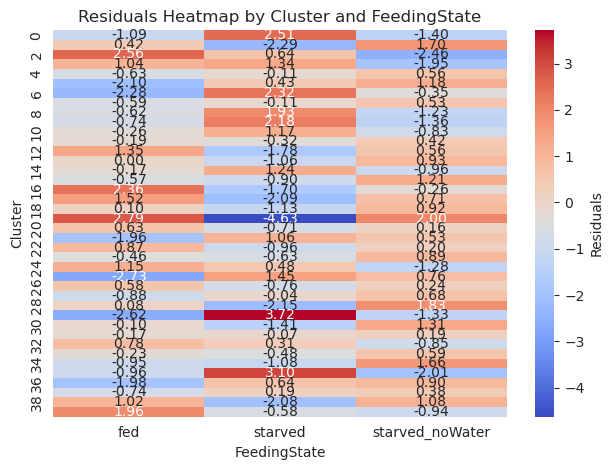

In [201]:
residuals = (contingency_table - expected) / np.sqrt(expected)
sns.heatmap(residuals, annot=True, cmap="coolwarm", fmt=".2f", cbar_kws={"label": "Residuals"})
plt.title("Residuals Heatmap by Cluster and FeedingState")
plt.xlabel("FeedingState")
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

## Ball direction

In [402]:
interaction_data = Umap[Umap["event_type"] == "interaction"].copy()

In [403]:
Umap["direction"].unique()

array([ 1,  0, -1])

<Axes: xlabel='UMAP1', ylabel='UMAP2'>

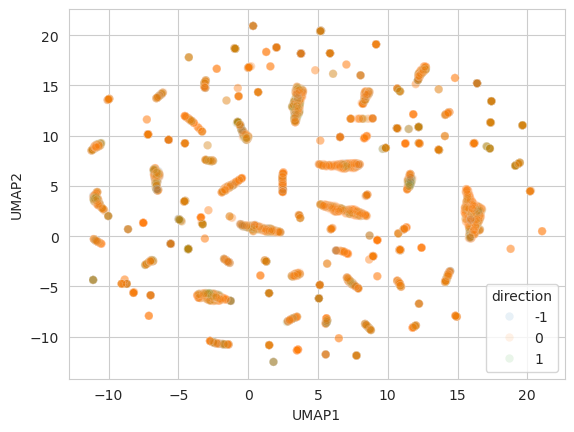

In [404]:
sns.scatterplot(data=Umap, x="UMAP1", y="UMAP2", alpha=0.1, hue="direction", palette="tab10")

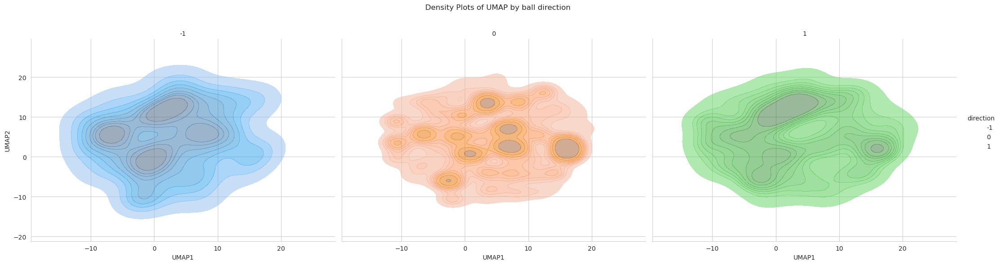

In [405]:
# Create a FacetGrid with two columns, one for each direction
g = sns.FacetGrid(
    Umap,
    col="direction",
    hue="direction",
    sharex=True,
    sharey=True,
    height=6,
    aspect=1.2,
)

# Map the kdeplot to the FacetGrid
g.map(sns.kdeplot, "UMAP1", "UMAP2", fill=True, alpha=0.5)

# Add titles and adjust layout
g.set_titles(col_template="{col_name}")
g.add_legend()
plt.subplots_adjust(top=0.85)
g.fig.suptitle("Density Plots of UMAP by ball direction")

# Save the plot
plt.savefig(f"{output_dir}/UMAP_Direction_Density.png")
plt.show()
plt.close()

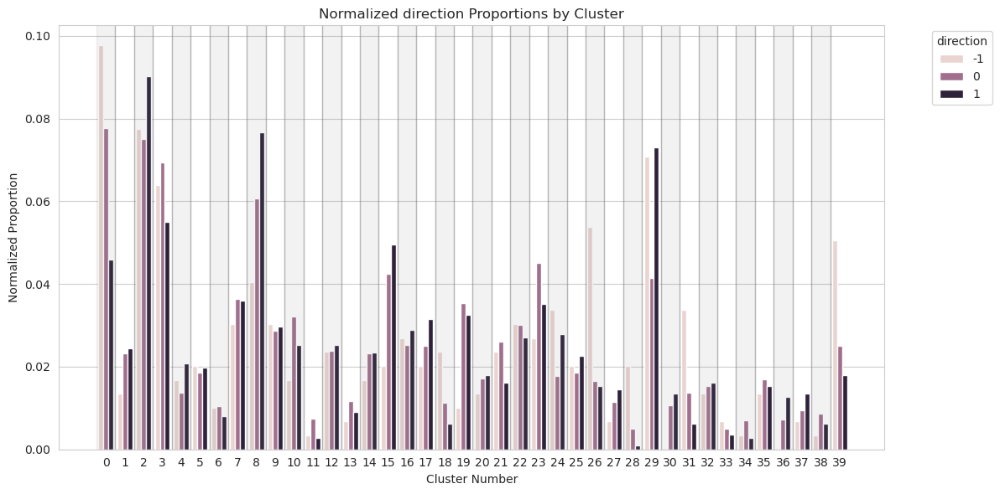

In [406]:
calculate_and_plot_normalized_proportions(
    data=Umap_feeding,
    group_by_column="cluster",
    metadata_column="direction",
    normalize_by_column="direction",
    output_dir=output_dir,
    title="Normalized direction Proportions by Cluster",
    xlabel="Cluster Number",
    ylabel="Normalized Proportion",
    save_filename="normalized_direction_proportions_by_cluster.png",
)

In [407]:
from scipy.stats import chi2_contingency


contingency_table = pd.crosstab(Umap["cluster"], Umap["direction"])
chi2, p, dof, expected = chi2_contingency(contingency_table)
print(f"Overall association p-value: {p:.4f}")

Overall association p-value: 0.0000


In [408]:
from itertools import combinations
from statsmodels.stats.multitest import multipletests

# For each cluster, test all FeedingState pairs
clusters = sorted(contingency_table.index)
p_values = []

for cluster in clusters:
    cluster_data = contingency_table.loc[cluster]
    for state1, state2 in combinations(cluster_data.index, 2):
        table = [
            [cluster_data[state1], cluster_data[state2]],
            [contingency_table.drop(cluster).sum()[state1], contingency_table.drop(cluster).sum()[state2]],
        ]
        _, p = fisher_exact(table)
        p_values.append(p)

# Apply Benjamini-Hochberg FDR correction
rejected, corrected_p, _, _ = multipletests(p_values, alpha=0.05, method="fdr_bh")

print(f"FDR-corrected p-values: {corrected_p}")

FDR-corrected p-values: [1.09264643e-02 9.80899141e-02 6.93562086e-01 1.00000000e+00
 6.70919280e-01 1.99306453e-01 8.01006067e-01 4.21142688e-01
 1.47402102e-03 9.08951903e-01 9.32393337e-01 9.08951903e-01
 9.08951903e-01 9.08951903e-01 9.41662639e-01 6.78059425e-01
 1.00000000e+00 2.57891110e-01 6.70919280e-01 9.08951903e-01
 9.08951903e-01 5.25960135e-02 1.00000000e+00 3.71883608e-04
 1.11729226e-04 5.82125158e-02 3.22282845e-03 6.78059425e-01
 9.08951903e-01 9.19184851e-02 9.08951903e-01 8.27230362e-01
 9.08951903e-01 5.49133854e-01 2.99222815e-01 3.54858654e-04
 8.94379084e-01 7.60594526e-01 7.69632330e-01 7.69632330e-01
 5.50324718e-01 7.54259728e-03 1.00000000e+00 1.00000000e+00
 1.00000000e+00 6.22474143e-02 4.55529646e-02 6.50833041e-01
 1.00000000e+00 9.08951903e-01 9.08951903e-01 5.50324718e-01
 9.08951903e-01 4.55529646e-02 2.80289146e-01 1.60901205e-02
 4.55529646e-02 2.50257872e-03 3.33082020e-02 6.76704959e-01
 1.00000000e+00 9.41662639e-01 6.78059425e-01 3.04960475e-01


In [410]:
annotations_direction = {}
for cluster, p_value in zip(clusters, p_values):
    if p_value < 0.001:
        annotations_feedingstate[cluster] = "***"
    elif p_value < 0.01:
        annotations_feedingstate[cluster] = "**"
    elif p_value < 0.05:
        annotations_feedingstate[cluster] = "*"
    else:
        annotations_feedingstate[cluster] = "n.s"

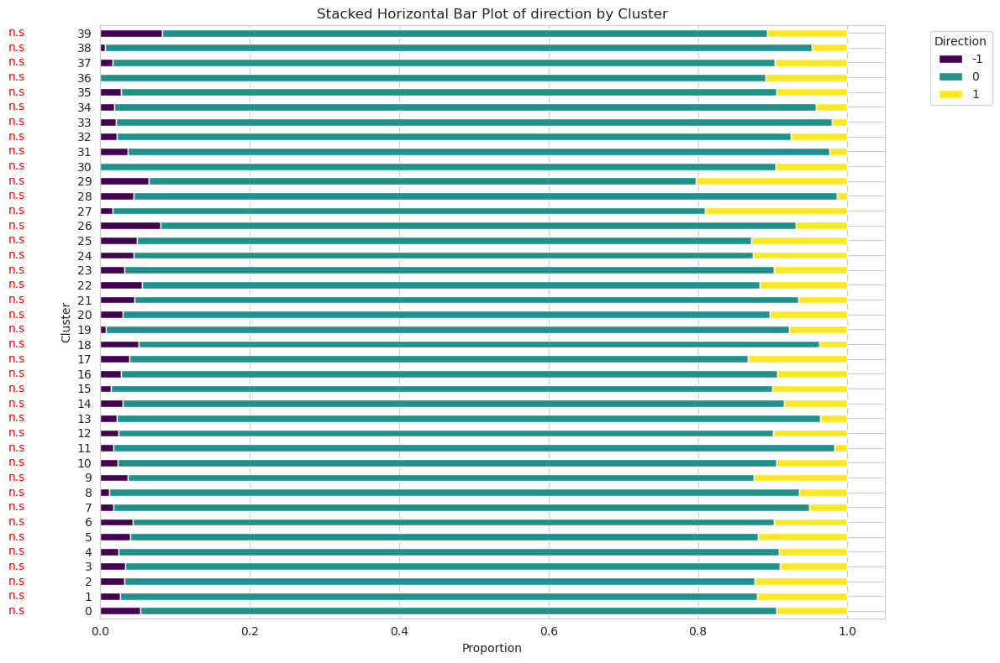

In [411]:
# Normalize the contingency table to get proportions
proportions = contingency_table.div(contingency_table.sum(axis=1), axis=0)

# Plot the stacked bar plot
proportions.plot(kind="barh", stacked=True, figsize=(12, 8), colormap="viridis")

# Add annotations for significance
for i, cluster in enumerate(clusters):
    plt.text(
        -0.1,
        i,
        annotations_direction.get(cluster, "n.s"),
        ha="right",
        va="center",
        color="red",
        fontsize=10,
    )

# Customize the plot
plt.title("Stacked Horizontal Bar Plot of direction by Cluster")
plt.xlabel("Proportion")
plt.ylabel("Cluster")
plt.legend(title="Direction", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/stacked_horizontal_bar_plot_direction.png")
plt.show()

## Only directions that work

In [413]:
Moved = Umap[Umap["direction"] != 0].copy()
Moved["direction"].unique()

array([ 1, -1])

In [414]:
contingency_table = pd.crosstab(Moved["cluster"], Moved["direction"])
chi2, p, dof, expected = chi2_contingency(contingency_table)
print(f"Overall association p-value: {p:.4f}")

Overall association p-value: 0.0000


In [415]:
for cluster in clusters:
    cluster_data = contingency_table.loc[cluster]
    other_data = contingency_table.drop(cluster).sum()
    _, p = fisher_exact([cluster_data, other_data])
    print(f"Cluster {cluster} vs others: p={p:.4f}")

Cluster 0 vs others: p=0.0302
Cluster 1 vs others: p=0.3522
Cluster 2 vs others: p=0.1825
Cluster 3 vs others: p=0.8003
Cluster 4 vs others: p=0.6885
Cluster 5 vs others: p=1.0000
Cluster 6 vs others: p=0.7499
Cluster 7 vs others: p=1.0000
Cluster 8 vs others: p=0.0142
Cluster 9 vs others: p=0.7396
Cluster 10 vs others: p=0.5584
Cluster 11 vs others: p=0.1222
Cluster 12 vs others: p=0.4690
Cluster 13 vs others: p=0.2619
Cluster 14 vs others: p=1.0000
Cluster 15 vs others: p=0.0091
Cluster 16 vs others: p=0.7293
Cluster 17 vs others: p=0.7396
Cluster 18 vs others: p=0.0027
Cluster 19 vs others: p=0.0058
Cluster 20 vs others: p=0.8257
Cluster 21 vs others: p=0.0459
Cluster 22 vs others: p=0.2666
Cluster 23 vs others: p=1.0000
Cluster 24 vs others: p=1.0000
Cluster 25 vs others: p=0.8469
Cluster 26 vs others: p=0.0001
Cluster 27 vs others: p=0.0393
Cluster 28 vs others: p=0.0001
Cluster 29 vs others: p=0.8196
Cluster 30 vs others: p=0.0171
Cluster 31 vs others: p=0.0001
Cluster 32 vs othe

In [416]:
residuals = (contingency_table - expected) / np.sqrt(expected)

residuals

direction,-1,1
cluster,,
0,1.908084,-1.120141
1,-0.877787,0.515305
2,-1.122109,0.658735
3,0.204096,-0.119815
4,-0.501298,0.294287
5,-0.070394,0.041325
6,0.366013,-0.214868
7,-0.031295,0.018372
8,-2.023924,1.188145


In [417]:
clusters = sorted(contingency_table.index)
p_values = []

for cluster in clusters:
    cluster_data = contingency_table.loc[cluster]
    other_data = contingency_table.drop(cluster).sum()
    _, p = fisher_exact([cluster_data, other_data])
    p_values.append(p)

# Bonferroni correction
adjusted_alpha = 0.05 / len(clusters)
significant_clusters = [clusters[i] for i, p in enumerate(p_values) if p < adjusted_alpha]

print(f"Significant clusters (Bonferroni α={adjusted_alpha:.6f}): {significant_clusters}")

Significant clusters (Bonferroni α=0.001250): [26, 28, 31]


In [418]:
from statsmodels.stats.multitest import multipletests

# Benjamini-Hochberg FDR correction
rejected, corrected_p, _, _ = multipletests(p_values, alpha=0.05, method="fdr_bh")

significant_clusters_fdr = [clusters[i] for i, rejected in enumerate(rejected) if rejected]
print(f"FDR-significant clusters: {significant_clusters_fdr}")

FDR-significant clusters: [18, 19, 26, 28, 31]


In [419]:
# Generate significance annotations
significance_annotations = {}
for cluster, p_value in zip(clusters, p_values):
    if p_value < 0.001:
        significance_annotations[cluster] = "***"
    elif p_value < 0.01:
        significance_annotations[cluster] = "**"
    elif p_value < 0.05:
        significance_annotations[cluster] = "*"
    else:
        significance_annotations[cluster] = "n.s"

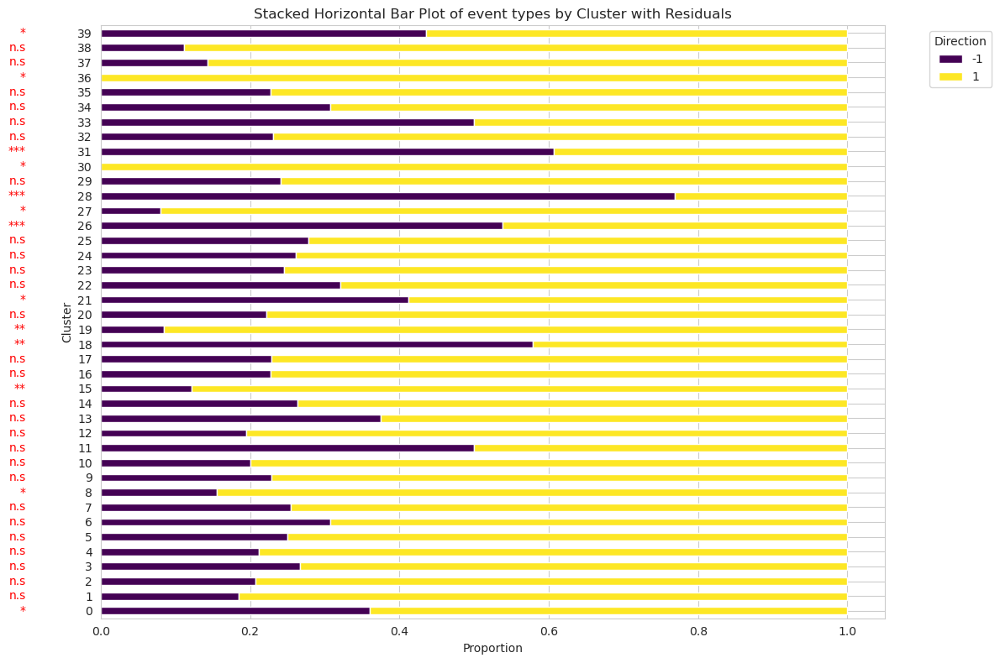

In [420]:
import matplotlib.pyplot as plt

# Normalize the contingency table to get proportions for Light conditions
proportions = contingency_table.div(contingency_table.sum(axis=1), axis=0)

# Plot the stacked bar plot with Light conditions stacked horizontally
proportions.plot(kind="barh", stacked=True, figsize=(12, 8), colormap="viridis")

# Add Fisher posthoc annotations next to cluster labels
for i, cluster in enumerate(clusters):
    plt.text(
        -0.1,  # Position slightly to the left of the bars
        i,
        significance_annotations.get(cluster, "n.s"),
        ha="right",
        va="center",
        color="red",
        fontsize=10,
    )

# Customize the plot
plt.title("Stacked Horizontal Bar Plot of event types by Cluster with Residuals")
plt.xlabel("Proportion")
plt.ylabel("Cluster")
plt.legend(title="Direction", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()

plt.savefig(f"{output_dir}/stacked_horizontal_bar_plot_direction.png")
plt.show()

In [421]:
for cluster in clusters:
    cluster_data = contingency_table.loc[cluster]
    other_data = contingency_table.drop(cluster).sum()
    odds_ratio, _ = fisher_exact([cluster_data, other_data])
    print(f"Cluster {cluster}: OR={odds_ratio:.2f}")

Cluster 0: OR=1.69
Cluster 1: OR=0.65
Cluster 2: OR=0.74
Cluster 3: OR=1.06
Cluster 4: OR=0.78
Cluster 5: OR=0.97
Cluster 6: OR=1.29
Cluster 7: OR=0.99
Cluster 8: OR=0.52
Cluster 9: OR=0.86
Cluster 10: OR=0.72
Cluster 11: OR=2.92
Cluster 12: OR=0.70
Cluster 13: OR=1.75
Cluster 14: OR=1.04
Cluster 15: OR=0.39
Cluster 16: OR=0.85
Cluster 17: OR=0.86
Cluster 18: OR=4.07
Cluster 19: OR=0.26
Cluster 20: OR=0.83
Cluster 21: OR=2.07
Cluster 22: OR=1.39
Cluster 23: OR=0.94
Cluster 24: OR=1.02
Cluster 25: OR=1.12
Cluster 26: OR=3.51
Cluster 27: OR=0.25
Cluster 28: OR=9.89
Cluster 29: OR=0.91
Cluster 30: OR=0.00
Cluster 31: OR=4.63
Cluster 32: OR=0.87
Cluster 33: OR=2.92
Cluster 34: OR=1.29
Cluster 35: OR=0.85
Cluster 36: OR=0.00
Cluster 37: OR=0.48
Cluster 38: OR=0.36
Cluster 39: OR=2.29


In [424]:
odds_ratios = []
ci_lower = []
ci_upper = []

z = 1.96  # For 95% confidence interval

# Iterate over each cluster in the contingency table
for cluster in contingency_table.index:
    # Extract the 2x2 table for the current cluster
    cluster_data = contingency_table.loc[cluster]
    print(cluster_data)
    other_data = contingency_table.drop(cluster).sum()

    # Create a 2x2 table
    table = [[cluster_data[1], cluster_data[-1]], [other_data[1], other_data[-1]]]

    # Extract values from the table
    a, b = table[0]
    c, d = table[1]

    # Calculate odds ratio
    odds_ratio = (a * d) / (b * c)
    odds_ratios.append(odds_ratio)

    # Calculate standard error
    se = np.sqrt(1 / a + 1 / b + 1 / c + 1 / d)

    # Log-transform the odds ratio
    log_or = np.log(odds_ratio)

    # Compute CI in log space
    log_ci_lower = log_or - z * se
    log_ci_upper = log_or + z * se

    # Transform back to original scale
    ci_lower.append(np.exp(log_ci_lower))
    ci_upper.append(np.exp(log_ci_upper))

# Print results
for i, cluster in enumerate(contingency_table.index):
    print(f"Cluster {cluster}: OR={odds_ratios[i]:.2f}, CI=({ci_lower[i]:.2f}, {ci_upper[i]:.2f})")

direction
-1    31
 1    55
Name: 0, dtype: int64
direction
-1     7
 1    31
Name: 1, dtype: int64
direction
-1     28
 1    107
Name: 2, dtype: int64
direction
-1    23
 1    63
Name: 3, dtype: int64
direction
-1     7
 1    26
Name: 4, dtype: int64
direction
-1     8
 1    24
Name: 5, dtype: int64
direction
-1    4
 1    9
Name: 6, dtype: int64
direction
-1    15
 1    44
Name: 7, dtype: int64
direction
-1    16
 1    87
Name: 8, dtype: int64
direction
-1    11
 1    37
Name: 9, dtype: int64
direction
-1     7
 1    28
Name: 10, dtype: int64
direction
-1    4
 1    4
Name: 11, dtype: int64
direction
-1     8
 1    33
Name: 12, dtype: int64
direction
-1     6
 1    10
Name: 13, dtype: int64
direction
-1    10
 1    28
Name: 14, dtype: int64
direction
-1     8
 1    58
Name: 15, dtype: int64
direction
-1    10
 1    34
Name: 16, dtype: int64
direction
-1    11
 1    37
Name: 17, dtype: int64
direction
-1    11
 1     8
Name: 18, dtype: int64
direction
-1     4
 1    43
Name: 19, dtype

/tmp/ipykernel_209427/4136187973.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  odds_ratio = (a * d) / (b * c)
/tmp/ipykernel_209427/4136187973.py:26: RuntimeWarning: divide by zero encountered in scalar divide
  se = np.sqrt(1 / a + 1 / b + 1 / c + 1 / d)
/tmp/ipykernel_209427/4136187973.py:32: RuntimeWarning: invalid value encountered in scalar subtract
  log_ci_lower = log_or - z * se
/tmp/ipykernel_209427/4136187973.py:22: RuntimeWarning: divide by zero encountered in scalar divide
  odds_ratio = (a * d) / (b * c)
/tmp/ipykernel_209427/4136187973.py:26: RuntimeWarning: divide by zero encountered in scalar divide
  se = np.sqrt(1 / a + 1 / b + 1 / c + 1 / d)
/tmp/ipykernel_209427/4136187973.py:32: RuntimeWarning: invalid value encountered in scalar subtract
  log_ci_lower = log_or - z * se


/tmp/ipykernel_209427/1058896694.py:15: RuntimeWarning: invalid value encountered in scalar subtract
  xerr=[[log_odds_ratios[i] - log_ci_lower[i]], [log_ci_upper[i] - log_odds_ratios[i]]],


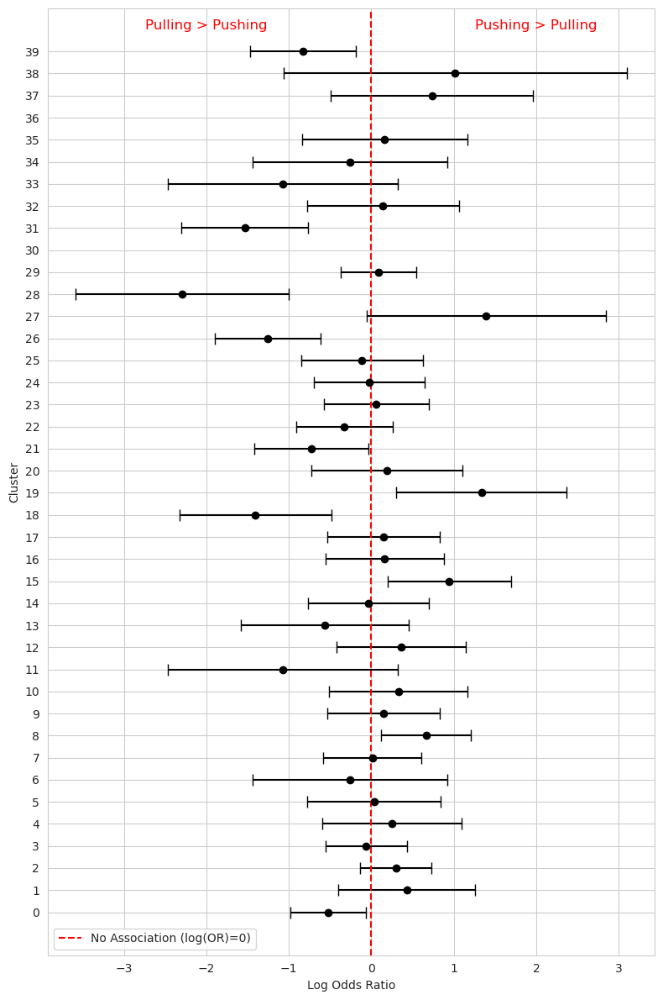

In [427]:
import numpy as np
import matplotlib.pyplot as plt

# Log-transform the odds ratios and confidence intervals
log_odds_ratios = np.log(odds_ratios)
log_ci_lower = np.log(ci_lower)
log_ci_upper = np.log(ci_upper)

# Plot the log-transformed odds ratios (rotated)
plt.figure(figsize=(8, 12))
for i, cluster in enumerate(clusters):
    plt.errorbar(
        log_odds_ratios[i],
        i,
        xerr=[[log_odds_ratios[i] - log_ci_lower[i]], [log_ci_upper[i] - log_odds_ratios[i]]],
        fmt="o",
        capsize=5,
        color="black",
    )

# Add a vertical line at 0 (log(OR=1))
plt.axvline(0, color="red", linestyle="--", label="No Association (log(OR)=0)")

# Add "Off" and "On" labels
plt.text(-2, len(clusters), "Pulling > Pushing", color="red", fontsize=12, ha="center", rotation=0)
plt.text(2, len(clusters), "Pushing > Pulling", color="red", fontsize=12, ha="center", rotation=0)

# Customize the plot
plt.yticks(range(len(clusters)), clusters)
plt.title("")
plt.ylabel("Cluster")
plt.xlabel("Log Odds Ratio")
plt.legend()
plt.tight_layout()

# plt.xlim(-4, 4)

plt.savefig(f"{output_dir}/Direction_log_odds_ratios_by_cluster.png")
plt.show()

## Event type

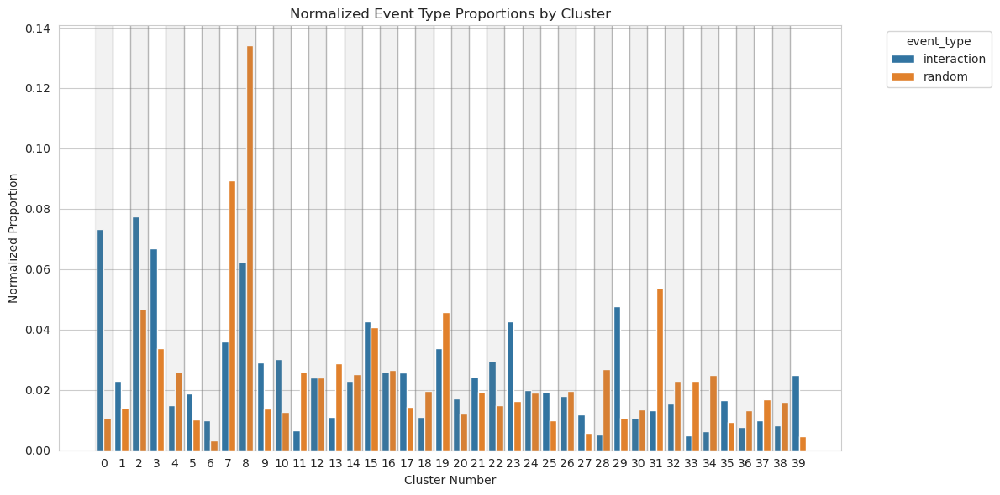

In [305]:
calculate_and_plot_normalized_proportions(
    data=Umap,
    group_by_column="cluster",
    metadata_column="event_type",
    normalize_by_column="event_type",
    output_dir=output_dir,
    title="Normalized Event Type Proportions by Cluster",
    xlabel="Cluster Number",
    ylabel="Normalized Proportion",
    save_filename="normalized_event_type_proportions_by_cluster.png",
)

In [309]:
from scipy.stats import chi2_contingency

contingency_table = pd.crosstab(Umap["cluster"], Umap["event_type"])
chi2, p, dof, expected = chi2_contingency(contingency_table)
print(f"Overall association p-value: {p:.4f}")

Overall association p-value: 0.0000


In [310]:
for cluster in clusters:
    cluster_data = contingency_table.loc[cluster]
    other_data = contingency_table.drop(cluster).sum()
    _, p = fisher_exact([cluster_data, other_data])
    print(f"Cluster {cluster} vs others: p={p:.4f}")

Cluster 0 vs others: p=0.0000
Cluster 1 vs others: p=0.0002
Cluster 2 vs others: p=0.0000
Cluster 3 vs others: p=0.0000
Cluster 4 vs others: p=0.0000
Cluster 5 vs others: p=0.0000
Cluster 6 vs others: p=0.0000
Cluster 7 vs others: p=0.0000
Cluster 8 vs others: p=0.0000
Cluster 9 vs others: p=0.0000
Cluster 10 vs others: p=0.0000
Cluster 11 vs others: p=0.0000
Cluster 12 vs others: p=0.9558
Cluster 13 vs others: p=0.0000
Cluster 14 vs others: p=0.4047
Cluster 15 vs others: p=0.6397
Cluster 16 vs others: p=0.7906
Cluster 17 vs others: p=0.0000
Cluster 18 vs others: p=0.0000
Cluster 19 vs others: p=0.0003
Cluster 20 vs others: p=0.0155
Cluster 21 vs others: p=0.0547
Cluster 22 vs others: p=0.0000
Cluster 23 vs others: p=0.0000
Cluster 24 vs others: p=0.7119
Cluster 25 vs others: p=0.0000
Cluster 26 vs others: p=0.4911
Cluster 27 vs others: p=0.0002
Cluster 28 vs others: p=0.0000
Cluster 29 vs others: p=0.0000
Cluster 30 vs others: p=0.1400
Cluster 31 vs others: p=0.0000
Cluster 32 vs othe

In [311]:
residuals = (contingency_table - expected) / np.sqrt(expected)

residuals

event_type,interaction,random
cluster,,
0,12.642006,-12.642923
1,2.650734,-2.650926
2,5.116040,-5.116411
3,6.118268,-6.118711
4,-3.237297,3.237532
5,2.999166,-2.999383
6,3.483256,-3.483509
7,-8.843664,8.844306
8,-9.494524,9.495213


In [312]:
clusters = sorted(contingency_table.index)
p_values = []

for cluster in clusters:
    cluster_data = contingency_table.loc[cluster]
    other_data = contingency_table.drop(cluster).sum()
    _, p = fisher_exact([cluster_data, other_data])
    p_values.append(p)

# Bonferroni correction
adjusted_alpha = 0.05 / len(clusters)
significant_clusters = [clusters[i] for i, p in enumerate(p_values) if p < adjusted_alpha]

print(f"Significant clusters (Bonferroni α={adjusted_alpha:.6f}): {significant_clusters}")

Significant clusters (Bonferroni α=0.001250): [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 17, 18, 19, 22, 23, 25, 27, 28, 29, 31, 32, 33, 34, 35, 37, 38, 39]


In [313]:
from statsmodels.stats.multitest import multipletests

# Benjamini-Hochberg FDR correction
rejected, corrected_p, _, _ = multipletests(p_values, alpha=0.05, method="fdr_bh")

significant_clusters_fdr = [clusters[i] for i, rejected in enumerate(rejected) if rejected]
print(f"FDR-significant clusters: {significant_clusters_fdr}")

FDR-significant clusters: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 17, 18, 19, 20, 22, 23, 25, 27, 28, 29, 31, 32, 33, 34, 35, 36, 37, 38, 39]


In [314]:
# Generate significance annotations
significance_annotations = {}
for cluster, p_value in zip(clusters, p_values):
    if p_value < 0.001:
        significance_annotations[cluster] = "***"
    elif p_value < 0.01:
        significance_annotations[cluster] = "**"
    elif p_value < 0.05:
        significance_annotations[cluster] = "*"
    else:
        significance_annotations[cluster] = "n.s"

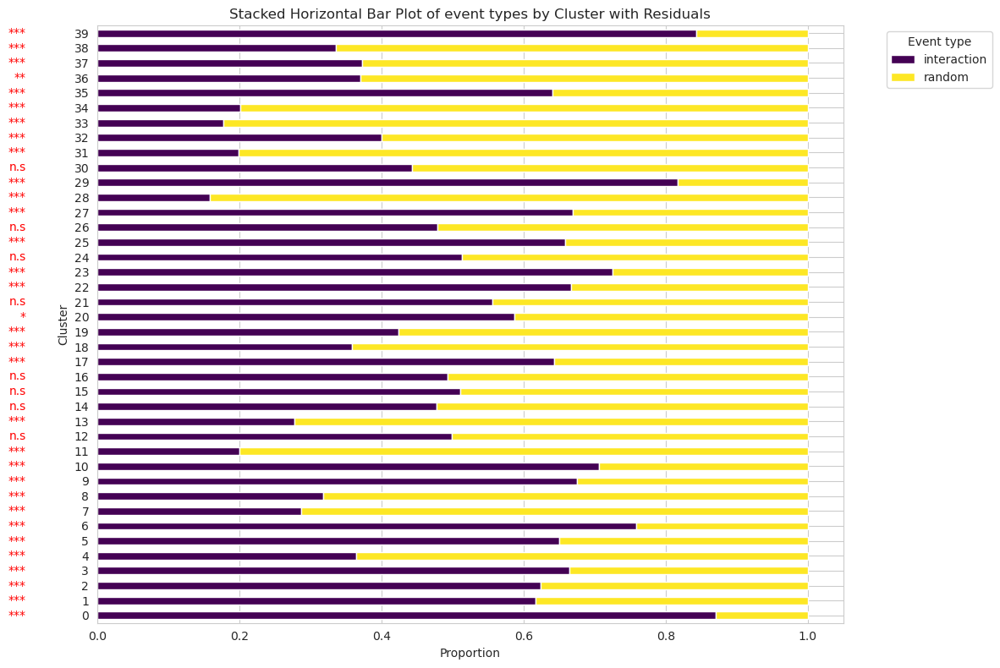

In [320]:
import matplotlib.pyplot as plt

# Normalize the contingency table to get proportions for Light conditions
proportions = contingency_table.div(contingency_table.sum(axis=1), axis=0)

# Plot the stacked bar plot with Light conditions stacked horizontally
proportions.plot(kind="barh", stacked=True, figsize=(12, 8), colormap="viridis")

# Add Fisher posthoc annotations next to cluster labels
for i, cluster in enumerate(clusters):
    plt.text(
        -0.1,  # Position slightly to the left of the bars
        i,
        significance_annotations.get(cluster, "n.s"),
        ha="right",
        va="center",
        color="red",
        fontsize=10,
    )

# Customize the plot
plt.title("Stacked Horizontal Bar Plot of event types by Cluster with Residuals")
plt.xlabel("Proportion")
plt.ylabel("Cluster")
plt.legend(title="Event type", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()

plt.savefig(f"{output_dir}/stacked_horizontal_bar_plot_event_type.png")
plt.show()

In [315]:
for cluster in clusters:
    cluster_data = contingency_table.loc[cluster]
    other_data = contingency_table.drop(cluster).sum()
    odds_ratio, _ = fisher_exact([cluster_data, other_data])
    print(f"Cluster {cluster}: OR={odds_ratio:.2f}")

Cluster 0: OR=7.20
Cluster 1: OR=1.63
Cluster 2: OR=1.71
Cluster 3: OR=2.05
Cluster 4: OR=0.57
Cluster 5: OR=1.87
Cluster 6: OR=3.16
Cluster 7: OR=0.38
Cluster 8: OR=0.43
Cluster 9: OR=2.12
Cluster 10: OR=2.45
Cluster 11: OR=0.25
Cluster 12: OR=0.99
Cluster 13: OR=0.38
Cluster 14: OR=0.91
Cluster 15: OR=1.04
Cluster 16: OR=0.97
Cluster 17: OR=1.82
Cluster 18: OR=0.55
Cluster 19: OR=0.73
Cluster 20: OR=1.43
Cluster 21: OR=1.26
Cluster 22: OR=2.03
Cluster 23: OR=2.71
Cluster 24: OR=1.05
Cluster 25: OR=1.95
Cluster 26: OR=0.92
Cluster 27: OR=2.04
Cluster 28: OR=0.18
Cluster 29: OR=4.62
Cluster 30: OR=0.79
Cluster 31: OR=0.24
Cluster 32: OR=0.66
Cluster 33: OR=0.21
Cluster 34: OR=0.25
Cluster 35: OR=1.79
Cluster 36: OR=0.58
Cluster 37: OR=0.59
Cluster 38: OR=0.50
Cluster 39: OR=5.49


In [317]:
odds_ratios = []
ci_lower = []
ci_upper = []

z = 1.96  # For 95% confidence interval

# Iterate over each cluster in the contingency table
for cluster in contingency_table.index:
    # Extract the 2x2 table for the current cluster
    cluster_data = contingency_table.loc[cluster]
    other_data = contingency_table.drop(cluster).sum()

    # Create a 2x2 table
    table = [[cluster_data["interaction"], cluster_data["random"]], [other_data["interaction"], other_data["random"]]]

    # Extract values from the table
    a, b = table[0]
    c, d = table[1]

    # Calculate odds ratio
    odds_ratio = (a * d) / (b * c)
    odds_ratios.append(odds_ratio)

    # Calculate standard error
    se = np.sqrt(1 / a + 1 / b + 1 / c + 1 / d)

    # Log-transform the odds ratio
    log_or = np.log(odds_ratio)

    # Compute CI in log space
    log_ci_lower = log_or - z * se
    log_ci_upper = log_or + z * se

    # Transform back to original scale
    ci_lower.append(np.exp(log_ci_lower))
    ci_upper.append(np.exp(log_ci_upper))

# Print results
for i, cluster in enumerate(contingency_table.index):
    print(f"Cluster {cluster}: OR={odds_ratios[i]:.2f}, CI=({ci_lower[i]:.2f}, {ci_upper[i]:.2f})")

Cluster 0: OR=7.20, CI=(5.64, 9.20)
Cluster 1: OR=1.63, CI=(1.26, 2.10)
Cluster 2: OR=1.71, CI=(1.48, 1.97)
Cluster 3: OR=2.05, CI=(1.74, 2.41)
Cluster 4: OR=0.57, CI=(0.44, 0.72)
Cluster 5: OR=1.87, CI=(1.40, 2.51)
Cluster 6: OR=3.16, CI=(1.95, 5.11)
Cluster 7: OR=0.38, CI=(0.33, 0.44)
Cluster 8: OR=0.43, CI=(0.38, 0.48)
Cluster 9: OR=2.12, CI=(1.65, 2.70)
Cluster 10: OR=2.45, CI=(1.90, 3.15)
Cluster 11: OR=0.25, CI=(0.18, 0.34)
Cluster 12: OR=0.99, CI=(0.80, 1.24)
Cluster 13: OR=0.38, CI=(0.29, 0.49)
Cluster 14: OR=0.91, CI=(0.73, 1.13)
Cluster 15: OR=1.04, CI=(0.88, 1.23)
Cluster 16: OR=0.97, CI=(0.79, 1.20)
Cluster 17: OR=1.82, CI=(1.42, 2.33)
Cluster 18: OR=0.55, CI=(0.42, 0.73)
Cluster 19: OR=0.73, CI=(0.61, 0.87)
Cluster 20: OR=1.43, CI=(1.08, 1.90)
Cluster 21: OR=1.26, CI=(1.00, 1.58)
Cluster 22: OR=2.03, CI=(1.60, 2.58)
Cluster 23: OR=2.71, CI=(2.17, 3.37)
Cluster 24: OR=1.05, CI=(0.83, 1.34)
Cluster 25: OR=1.95, CI=(1.45, 2.61)
Cluster 26: OR=0.92, CI=(0.72, 1.17)
Cluster 27:

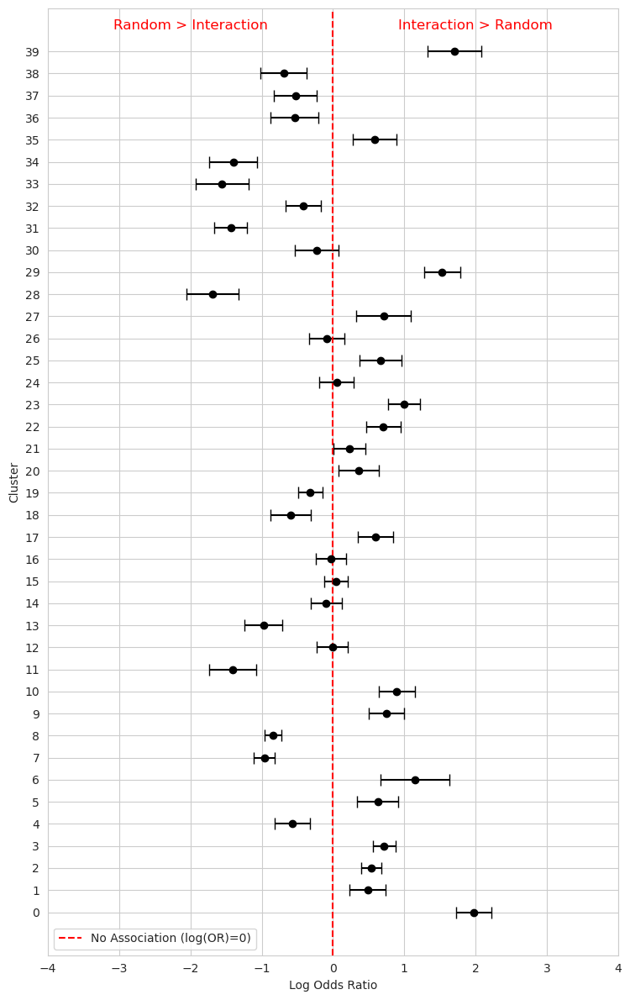

In [319]:
import numpy as np
import matplotlib.pyplot as plt

# Log-transform the odds ratios and confidence intervals
log_odds_ratios = np.log(odds_ratios)
log_ci_lower = np.log(ci_lower)
log_ci_upper = np.log(ci_upper)

# Plot the log-transformed odds ratios (rotated)
plt.figure(figsize=(8, 12))
for i, cluster in enumerate(clusters):
    plt.errorbar(
        log_odds_ratios[i],
        i,
        xerr=[[log_odds_ratios[i] - log_ci_lower[i]], [log_ci_upper[i] - log_odds_ratios[i]]],
        fmt="o",
        capsize=5,
        color="black",
    )

# Add a vertical line at 0 (log(OR=1))
plt.axvline(0, color="red", linestyle="--", label="No Association (log(OR)=0)")

# Add "Off" and "On" labels
plt.text(-2, len(clusters), "Random > Interaction", color="red", fontsize=12, ha="center", rotation=0)
plt.text(2, len(clusters), "Interaction > Random", color="red", fontsize=12, ha="center", rotation=0)

# Customize the plot
plt.yticks(range(len(clusters)), clusters)
plt.title("")
plt.ylabel("Cluster")
plt.xlabel("Log Odds Ratio")
plt.legend()
plt.tight_layout()

plt.xlim(-4, 4)

plt.savefig(f"{output_dir}/Event_Type_log_odds_ratios_by_cluster.png")
plt.show()

/tmp/ipykernel_209427/1807203520.py:50: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:black'` for the same effect.

  sns.stripplot(
/tmp/ipykernel_209427/1807203520.py:50: FutureWarning: Use "auto" to set automatic grayscale colors. From v0.14.0, "gray" will default to matplotlib's definition.
  sns.stripplot(


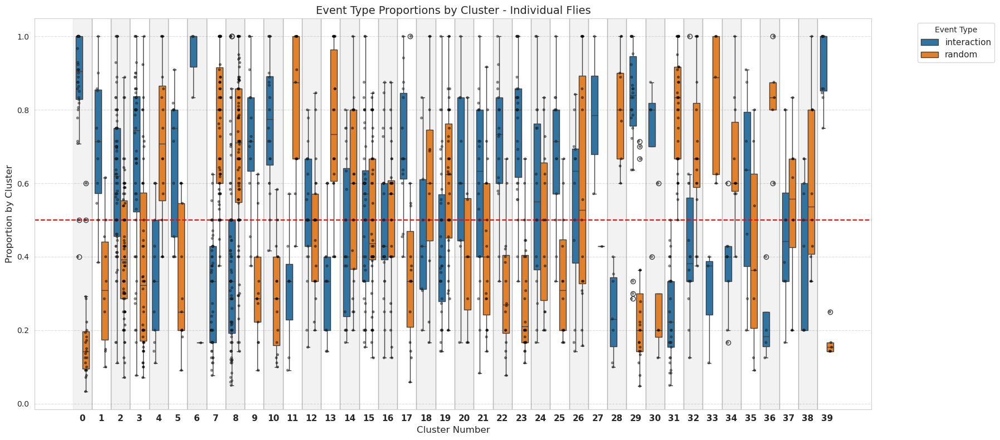

In [321]:
# Get unique clusters
unique_clusters = Umap["cluster"].unique()

# Initialize a DataFrame to store the individual fly proportions
fly_proportions_df = pd.DataFrame()

# Process each cluster and fly combination
for cluster_id in unique_clusters:
    cluster_data = Umap[Umap["cluster"] == cluster_id]

    # Get unique flies in this cluster
    unique_flies = cluster_data["fly"].unique()

    for fly_id in unique_flies:
        # Get data for this specific fly and cluster
        fly_cluster_data = cluster_data[cluster_data["fly"] == fly_id]

        # Only process if we have enough data points for this fly
        if len(fly_cluster_data) >= 5:  # Minimum threshold to calculate meaningful proportion
            # Count direction types and calculate proportions
            event_type_counts = fly_cluster_data["event_type"].value_counts(normalize=True).reset_index()
            event_type_counts.columns = ["event_type", "proportion"]
            event_type_counts["cluster"] = cluster_id
            event_type_counts["fly"] = fly_id

            # Append to the proportions DataFrame
            fly_proportions_df = pd.concat([fly_proportions_df, event_type_counts], ignore_index=True)

# Get unique event types and specify their order
event_types = sorted(fly_proportions_df["event_type"].unique())
clusters = sorted(fly_proportions_df["cluster"].unique())

# Create figure with more width to accommodate separations
plt.figure(figsize=(18, 8))  # Increased width

# Set style for better grid visibility
sns.set_style("whitegrid")

# Add boxplot with explicit order
ax = sns.boxplot(
    data=fly_proportions_df,
    x="cluster",
    y="proportion",
    hue="event_type",
    hue_order=event_types,
    width=0.7  # Slightly narrower boxes
)

# Add stripplot with the SAME order
sns.stripplot(
    data=fly_proportions_df,
    x="cluster",
    y="proportion",
    hue="event_type",
    hue_order=event_types,
    color='black',
    dodge=True,
    size=3,
    alpha=0.5,
    edgecolor='gray',
    linewidth=0.5
)

# Add vertical lines between cluster groups
for i in range(len(clusters)-1):
    plt.axvline(x=i+0.5, color='gray', linestyle='-', alpha=0.5, linewidth=1)

# Add alternating background for easier visual grouping
for i in range(len(clusters)):
    if i % 2 == 0:  # Every other cluster gets a light background
        plt.axvspan(i-0.5, i+0.5, alpha=0.1, color='gray')

# Set proper grid
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.grid(axis='x', visible=False)  # Remove default x grid

plt.axhline(0.5, color='red', linestyle='--', label="Equal proportion")
plt.title("Event Type Proportions by Cluster - Individual Flies", fontsize=14)
plt.xlabel("Cluster Number", fontsize=12)
plt.ylabel("Proportion by Cluster", fontsize=12)

# Improve x-axis labels
plt.xticks(range(len(clusters)), [str(c) for c in clusters], fontsize=11, fontweight='bold')

# Create a better legend (only keep one set)
handles, labels = plt.gca().get_legend_handles_labels()
plt.legend(handles[:len(event_types)], labels[:len(event_types)],
           title="Event Type", bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=11)

plt.tight_layout()
# Save the plot
plt.savefig(f"{output_dir}/proportions_by_cluster_individual_flies.png")
plt.show()
plt.close()

## By light conditions

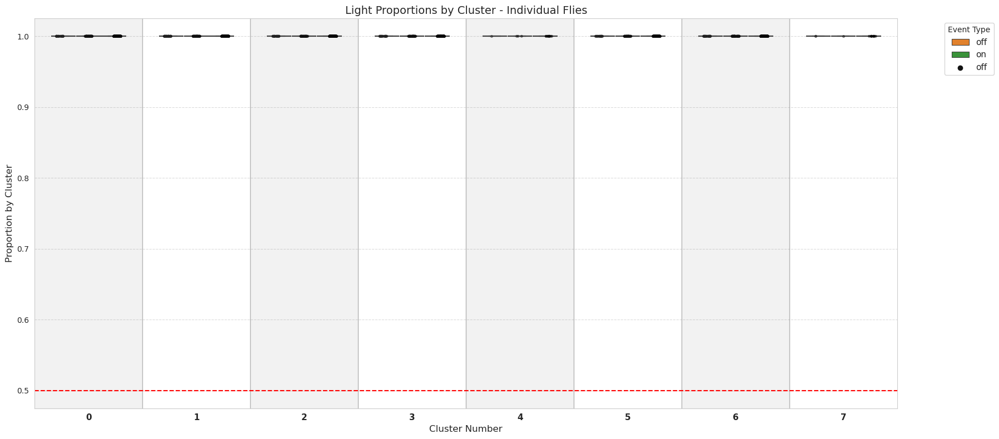

In [109]:
# Get unique clusters
unique_clusters = Umap["cluster"].unique()

# Initialize a DataFrame to store the individual fly proportions
fly_proportions_df = pd.DataFrame()

# Process each cluster and fly combination
for cluster_id in unique_clusters:
    cluster_data = Umap[Umap["cluster"] == cluster_id]

    # Get unique flies in this cluster
    unique_flies = cluster_data["fly"].unique()

    for fly_id in unique_flies:
        # Get data for this specific fly and cluster
        fly_cluster_data = cluster_data[cluster_data["fly"] == fly_id]

        # Only process if we have enough data points for this fly
        if (
            len(fly_cluster_data) >= 5
        ):  # Minimum threshold to calculate meaningful proportion
            # Count direction types and calculate proportions
            event_type_counts = (
                fly_cluster_data["Light"]
                .value_counts(normalize=True)
                .reset_index()
            )
            event_type_counts.columns = ["Light", "proportion"]
            event_type_counts["cluster"] = cluster_id
            event_type_counts["fly"] = fly_id

            # Append to the proportions DataFrame
            fly_proportions_df = pd.concat(
                [fly_proportions_df, event_type_counts], ignore_index=True
            )

# Get unique event types and specify their order
event_types = sorted(fly_proportions_df["Light"].unique())
clusters = sorted(fly_proportions_df["cluster"].unique())

# Create figure with more width to accommodate separations
plt.figure(figsize=(18, 8))  # Increased width

# Set style for better grid visibility
sns.set_style("whitegrid")

# Add boxplot with explicit order
ax = sns.boxplot(
    data=fly_proportions_df,
    x="cluster",
    y="proportion",
    hue="Light",
    hue_order=event_types,
    width=0.7,  # Slightly narrower boxes
)

# Add stripplot with the SAME order
sns.stripplot(
    data=fly_proportions_df,
    x="cluster",
    y="proportion",
    hue="Light",
    hue_order=event_types,
    color="black",
    dodge=True,
    size=3,
    alpha=0.5,
    edgecolor="gray",
    linewidth=0.5,
)

# Add vertical lines between cluster groups
for i in range(len(clusters) - 1):
    plt.axvline(x=i + 0.5, color="gray", linestyle="-", alpha=0.5, linewidth=1)

# Add alternating background for easier visual grouping
for i in range(len(clusters)):
    if i % 2 == 0:  # Every other cluster gets a light background
        plt.axvspan(i - 0.5, i + 0.5, alpha=0.1, color="gray")

# Set proper grid
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.grid(axis="x", visible=False)  # Remove default x grid

plt.axhline(0.5, color="red", linestyle="--", label="Equal proportion")
plt.title("Light Proportions by Cluster - Individual Flies", fontsize=14)
plt.xlabel("Cluster Number", fontsize=12)
plt.ylabel("Proportion by Cluster", fontsize=12)

# Improve x-axis labels
plt.xticks(
    range(len(clusters)), [str(c) for c in clusters], fontsize=11, fontweight="bold"
)

# Create a better legend (only keep one set)
handles, labels = plt.gca().get_legend_handles_labels()
plt.legend(
    handles[: len(event_types)],
    labels[: len(event_types)],
    title="Event Type",
    bbox_to_anchor=(1.05, 1),
    loc="upper left",
    fontsize=11,
)

plt.tight_layout()
# Save the plot
plt.savefig(f"{output_dir}/proportions_by_light_individual_flies.png")
plt.show()
plt.close()

# Check clusters composition for ligh conditions

In [ ]:
# With the Light subset, compare the event type proportions between light on and light off conditions

# Get unique clusters
unique_clusters = Umap_light["cluster"].unique()

# Initialize a DataFrame to store the proportions
proportions_df_Light = pd.DataFrame()

# Process each cluster
for cluster_id in unique_clusters:
    cluster_data = Umap_light[Umap_light["cluster"] == cluster_id]

    # Count event types and calculate proportions
    event_counts = (
        cluster_data.groupby("Light")["event_type"]
        .value_counts(normalize=True)
        .reset_index(name="proportion")
    )
    event_counts["cluster"] = cluster_id

    # Append to the proportions DataFrame
    proportions_df_Light = pd.concat(
        [proportions_df_Light, event_counts], ignore_index=True
    )

# Plot event type proportions as bar plots
plt.figure(figsize=(12, 6))
sns.barplot(data=proportions_df_Light, x="cluster", y="proportion", hue="Light")
plt.axhline(0.5, color="red", linestyle="--")
plt.title("Event Type Proportions by Cluster")
plt.xlabel("Cluster Number")
plt.ylabel("Proportion of Event Types")
plt.legend(title="Light Condition", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()

# Save the plot
# plt.savefig(f"{output_dir}/event_type_proportions_by_cluster.png")
plt.show()
plt.close()

# Individual features plotting

Let's check which features might be dominant in pulling apart the events

In [ ]:
# Load the transformed data

Transformed = pd.read_feather("/mnt/upramdya_data/MD/MultiMazeRecorder/Datasets/250220_StdContacts_Ctrl_Data/Transformed/230704_FeedingState_1_AM_Videos_Tracked_standardized_contacts_Transformed.feather")

In [41]:
Transformed["unique_id"] = Transformed["fly"].astype(str) + "_" + Transformed["event_type"] + "_" + Transformed["event_id"].astype(str)

In [ ]:
# Get one cluster and the corresponding transformed data

cluster_0 = Umap[Umap["cluster"] == 0]

cluster_0_transformed = Transformed[Transformed["unique_id"].isin(cluster_0["unique_id"])]
cluster_0_transformed.head()

In [ ]:
# Replace Nans with 9999

cluster_0_transformed = cluster_0_transformed.fillna(9999)

In [ ]:
# Get the list of features

feature_groups=['tracking', 'frame']

# Feature selection configuration
feature_config = {
    'tracking': [r'_frame\d+_x$', r'_frame\d+_y$'],
    'frame': [r'_frame\d+_velocity$', r'_frame\d+_angle$']
}


print("Excluding ball features...")

# Remove features that have "centre" in their name
feature_config['tracking'] = [f for f in feature_config['tracking'] if 'centre' not in f]
feature_config['frame'] = [f for f in feature_config['frame'] if 'centre' not in f]

# Create combined regex pattern
regex_parts = []
for group in feature_groups:
    regex_parts.extend(feature_config.get(group, []))
feature_pattern = '|'.join(regex_parts)

# Extract features and metadata
feature_columns = cluster_0_transformed.filter(regex=feature_pattern).columns
if len(feature_columns) == 0:
    raise ValueError("No features found matching the selected feature groups")

features = cluster_0_transformed[feature_columns].values
event_indices = cluster_0_transformed['event_id'] if 'event_id' in cluster_0_transformed.columns else pd.Series([None]*len(cluster_0_transformed))
metadata = cluster_0_transformed.drop(columns=feature_columns).drop(columns=['event_id'], errors='ignore')

In [ ]:
x_fly_pattern = r"^x_.*_fly$"
y_fly_pattern = r"^y_.*_fly$"


In [ ]:
# Now using cluster 0 interaction data we could plot each keypoint position over time, which are x_bodypart and y_bodypart columns in the interaction data
keypoints = cluster_0_interactions.filter(regex=f"{x_fly_pattern}|{y_fly_pattern}")
keypoints.head()

In [ ]:
# Add the adjusted frame column

keypoints["adjusted_frame"] = cluster_0_interactions["adjusted_frame"]

In [ ]:
keypoints

In [ ]:
# Now for each column plot average value over adjusted_frame

# For instance, get the x_Abdomen_fly

sns.lineplot(data=keypoints, x="adjusted_frame", y="x_Lfront_fly", estimator="mean")

# Clusters over time and interaction 

First we're gonna select one condition of starvation and light to minimise variability

In [9]:
Umap["Light"].unique()

array(['on', 'off', ''], dtype=object)

In [10]:
Umap["FeedingState"].unique()

array(['starved', 'starved_noWater', 'fed', 'Fed', ''], dtype=object)

In [360]:
Subset = Umap[Umap["Light"].isin(["on"])] #& Umap["FeedingState"].isin(["starved_noWater"])]


In [361]:
bin_metric(Subset, "start_time", 30)

/tmp/ipykernel_209427/2928321926.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f"binned_{metric}"] = pd.cut(df[column], bins=bins, labels=False)


,UMAP1,UMAP2,index,fly,event_id,event_type,Head_fly_frame0_x,Head_fly_frame1_x,Head_fly_frame2_x,Head_fly_frame3_x,...,Orientation,Light,Crossing,BallType,Peak,Used_to,cluster,unique_id,Light_weight,binned_start_time
0,-0.115999,9.883710,0,230706_FeedingState_3_PM_Flipped_Videos_Tracke...,0,interaction,1.387779e-17,0.000000e+00,6.938894e-18,0.000000e+00,...,std,on,NaN,NaN,NaN,NaN,29,230706_FeedingState_3_PM_Flipped_Videos_Tracke...,1.509581,0
1,13.634604,8.619156,1,230706_FeedingState_3_PM_Flipped_Videos_Tracke...,0,random,0.000000e+00,0.000000e+00,-4.440892e-16,0.000000e+00,...,std,on,NaN,NaN,NaN,NaN,36,230706_FeedingState_3_PM_Flipped_Videos_Tracke...,1.509581,23
2,-10.949207,3.646374,2,230706_FeedingState_3_PM_Flipped_Videos_Tracke...,1,interaction,0.000000e+00,0.000000e+00,0.000000e+00,-1.110223e-16,...,std,on,NaN,NaN,NaN,NaN,16,230706_FeedingState_3_PM_Flipped_Videos_Tracke...,1.509581,0
3,-1.566023,-2.413436,3,230706_FeedingState_3_PM_Flipped_Videos_Tracke...,1,random,0.000000e+00,-5.551115e-17,-2.775558e-17,-2.775558e-17,...,std,on,NaN,NaN,NaN,NaN,39,230706_FeedingState_3_PM_Flipped_Videos_Tracke...,1.509581,27
4,-0.344359,10.057284,4,230706_FeedingState_3_PM_Flipped_Videos_Tracke...,2,interaction,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,std,on,NaN,NaN,NaN,NaN,29,230706_FeedingState_3_PM_Flipped_Videos_Tracke...,1.509581,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13782,6.522211,7.087311,199,230705_FeedingState_2_AM_Videos_Tracked_arena9...,99,random,0.000000e+00,6.938894e-18,0.000000e+00,0.000000e+00,...,std,on,NaN,NaN,NaN,NaN,31,230705_FeedingState_2_AM_Videos_Tracked_arena9...,1.509581,26
13783,3.545790,-3.675150,200,230705_FeedingState_2_AM_Videos_Tracked_arena9...,100,interaction,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,std,on,NaN,NaN,NaN,NaN,32,230705_FeedingState_2_AM_Videos_Tracked_arena9...,1.509581,21
13784,-10.803743,3.462929,201,230705_FeedingState_2_AM_Videos_Tracked_arena9...,100,random,-8.881784e-16,-8.881784e-16,-8.881784e-16,8.881784e-16,...,std,on,NaN,NaN,NaN,NaN,16,230705_FeedingState_2_AM_Videos_Tracked_arena9...,1.509581,13
13785,17.416340,13.425472,202,230705_FeedingState_2_AM_Videos_Tracked_arena9...,101,interaction,1.110223e-16,0.000000e+00,1.110223e-16,0.000000e+00,...,std,on,NaN,NaN,NaN,NaN,21,230705_FeedingState_2_AM_Videos_Tracked_arena9...,1.509581,21


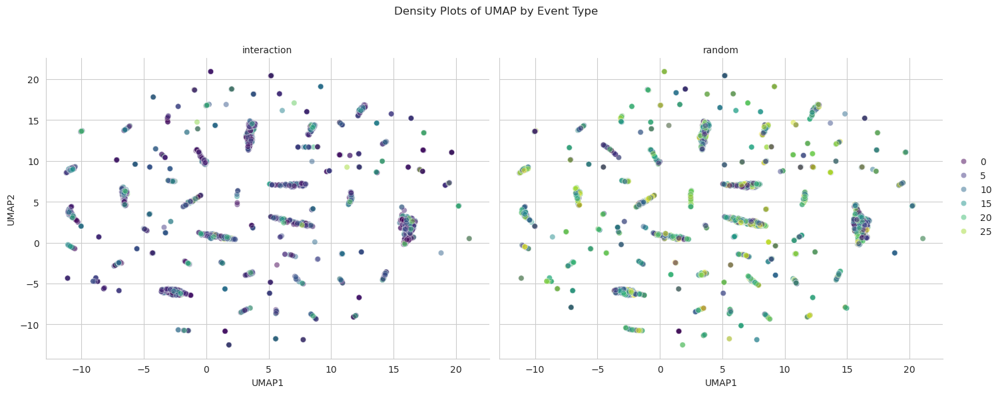

In [362]:
# Plot side by side the umap values of event_type interaction and random with hue being the binned_end_distance
# Create a FacetGrid with two columns, one for each event_type
g = sns.FacetGrid(
    Subset,
    col="event_type",
    sharex=True,
    sharey=True,
    height=6,
    aspect=1.2,
)

# Map the scatterplot to the FacetGrid
g.map_dataframe(
    sns.scatterplot,
    x="UMAP1",
    y="UMAP2",
    hue="binned_start_time",
    alpha=0.5,
    palette="viridis",
)

# Add titles and adjust layout
g.set_titles(col_template="{col_name}")
g.add_legend()
plt.subplots_adjust(top=0.85)
g.fig.suptitle("Density Plots of UMAP by Event Type")

# Save the plot
plt.savefig(f"{output_dir}/UMAP_event_types_overtime_starttime.png")
plt.show()
plt.close()

In [365]:
# Calculate cluster proportions over time by event type
cluster_proportions = Subset.groupby(["event_type", "binned_start_time", "cluster"]).size().reset_index(name="count")

# Calculate totals for proportions
totals = (cluster_proportions
         .groupby(['event_type', 'binned_start_time'])['count']
         .sum()
         .reset_index(name='total'))

# Merge and calculate proportions
cluster_proportions = cluster_proportions.merge(totals, on=["event_type", "binned_start_time"])
cluster_proportions["proportion"] = cluster_proportions["count"] / cluster_proportions["total"]

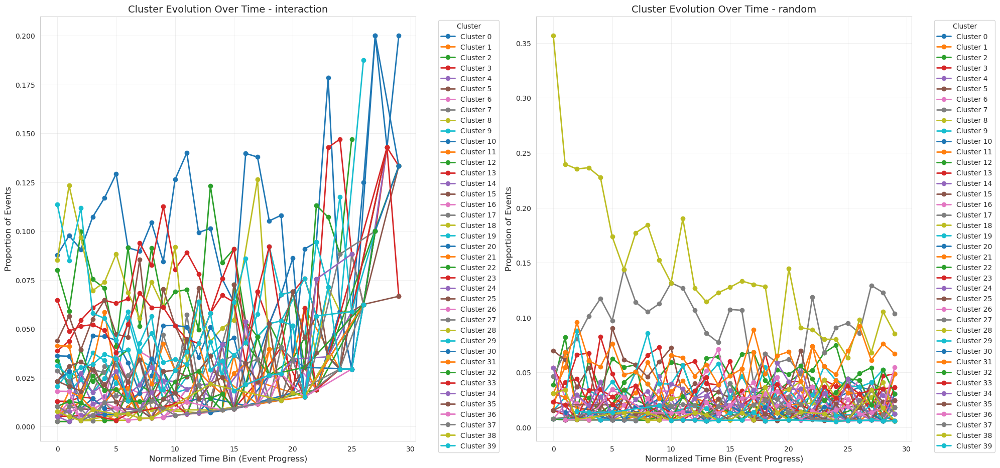

In [366]:
plt.figure(figsize=(20, 10))

for i, event_type in enumerate(Subset["event_type"].unique()):
    plt.subplot(1, 2, i + 1)

    # Filter to just this event type
    event_data = cluster_proportions[cluster_proportions["event_type"] == event_type]

    # Plot a line for each cluster
    for cluster in sorted(Subset["cluster"].unique()):
        cluster_data = event_data[event_data["cluster"] == cluster]
        if not cluster_data.empty:
            plt.plot(
                cluster_data["binned_start_time"],
                cluster_data["proportion"],
                marker="o",
                linewidth=2,
                label=f"Cluster {cluster}",
            )

    plt.title(f"Cluster Evolution Over Time - {event_type}", fontsize=14)
    plt.xlabel("Normalized Time Bin (Event Progress)", fontsize=12)
    plt.ylabel("Proportion of Events", fontsize=12)
    plt.grid(True, alpha=0.3)
    plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc="upper left")

plt.tight_layout()
plt.savefig(f"{output_dir}/cluster_evolution_line_plots.png")
plt.show()

In [367]:
# Calculate cluster proportions over time by event type AND fly
fly_cluster_proportions = (
    Subset.groupby(["fly", "event_type", "binned_start_time", "cluster"])
    .size()
    .reset_index(name="count")
)

# Calculate totals for proportions (per fly and time bin)
fly_totals = (
    fly_cluster_proportions.groupby(["fly", "event_type", "binned_start_time"])["count"].sum().reset_index(name="total")
)

# Merge and calculate proportions
fly_cluster_proportions = fly_cluster_proportions.merge(fly_totals, on=["fly", "event_type", "binned_start_time"])
fly_cluster_proportions["proportion"] = (
    fly_cluster_proportions["count"] / fly_cluster_proportions["total"]
)

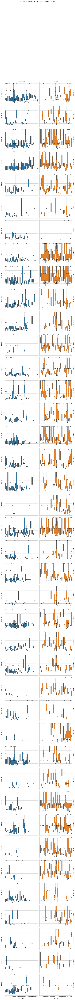

In [368]:
# Create a facet grid of box plots
g = sns.FacetGrid(
    fly_cluster_proportions,
    col="event_type",
    hue="event_type",
    row="cluster",
    margin_titles=True,
    height=3,
    aspect=1.5,
    palette="tab10",
)

# Map the box plot
g.map_dataframe(sns.boxplot, x="binned_start_time", y="proportion")

# Add strip plot to show individual fly points
g.map_dataframe(
    sns.stripplot,
    x="binned_start_time",
    y="proportion",
    color="black",
    size=2,
    alpha=0.5,
    jitter=True,
)

# Add titles and labels
g.set_axis_labels("Time Bin", "Proportion")
g.set_titles(col_template="{col_name}", row_template="Cluster {row_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Cluster Distribution by Fly Over Time", fontsize=16)

plt.savefig(f"{output_dir}/cluster_evolution_by_fly_box_plots.png")
plt.show()

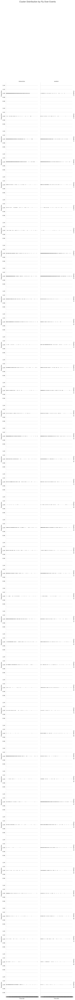

In [377]:
# Calculate cluster proportions over time by event type AND fly
fly_cluster_proportions = (
    Subset.groupby(["fly", "event_type", "event_id", "cluster"]).size().reset_index(name="count")
)

# Calculate totals for proportions (per fly and time bin)
fly_totals = fly_cluster_proportions.groupby(["fly", "event_type", "event_id"])["count"].sum().reset_index(name="total")

# Merge and calculate proportions
fly_cluster_proportions = fly_cluster_proportions.merge(fly_totals, on=["fly", "event_type", "event_id"])
fly_cluster_proportions["proportion"] = fly_cluster_proportions["count"] / fly_cluster_proportions["total"]

# Create a facet grid of box plots
g = sns.FacetGrid(
    fly_cluster_proportions,
    col="event_type",
    hue="event_type",
    row="cluster",
    margin_titles=True,
    height=3,
    aspect=1.5,
    palette="tab10",
)

# Map the box plot
g.map_dataframe(sns.boxplot, x="event_id", y="proportion")

# Add strip plot to show individual fly points
g.map_dataframe(
    sns.stripplot,
    x="event_id",
    y="proportion",
    color="black",
    size=2,
    alpha=0.5,
    jitter=True,
)

# Add titles and labels
g.set_axis_labels("Time Bin", "Proportion")
g.set_titles(col_template="{col_name}", row_template="Cluster {row_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Cluster Distribution by Fly Over Events", fontsize=16)

plt.savefig(f"{output_dir}/cluster_evolution_by_fly_box_plots_byEvents.png")
plt.show()

/tmp/ipykernel_209427/172481734.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Subset_interaction["cluster"] = Subset_interaction["cluster"].astype("category")


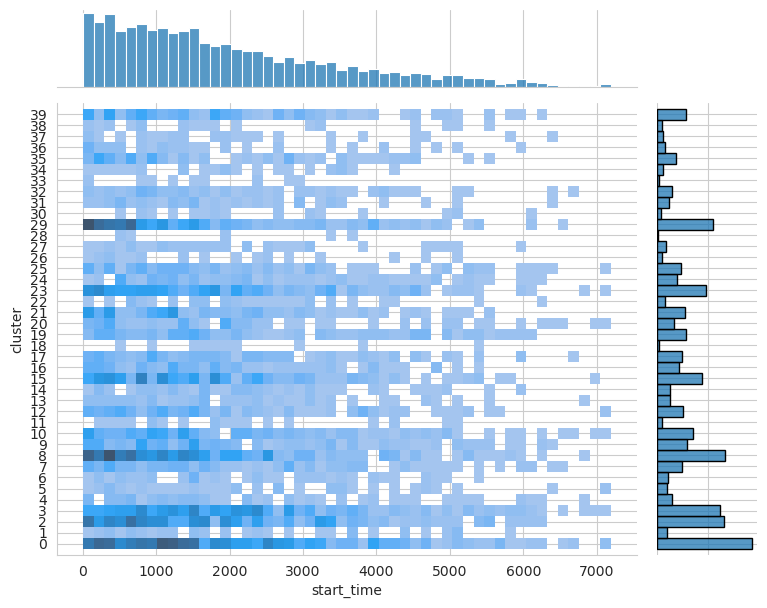

In [378]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

margin_start = 4
margin_end = 4

# Filter the subset for interaction events
Subset_interaction = Subset[Subset["event_type"] == "interaction"]

# Convert cluster to categorical for better plotting
Subset_interaction["cluster"] = Subset_interaction["cluster"].astype("category")

# Define the number of bins for x and y axes
x_bins = 50  # Number of bins for the x-axis (start)
y_bins = 20  # Number of bins for the y-axis (cluster)

# Create the jointplot with kind="hist"
g = sns.jointplot(
    data=Subset_interaction,
    x="start_time",
    y="cluster",
    kind="hist",
    height=8,
    bins=(x_bins, y_bins),  # Set the number of bins for x and y axes
)

# Set aspect ratio AFTER plot creation
g.ax_joint.set_aspect("auto")
g.fig.subplots_adjust(left=0.15, right=0.85)  # Compensate for aspect ratio

# Find min and max cluster values for proper range setting
# cluster_min = Subset_interaction["cluster"].min()
# cluster_max = Subset_interaction["cluster"].max()

# Clear and recreate the y-marginal histogram with precise bins
g.ax_marg_y.clear()
bins = np.arange(0 - margin_start, 7 + margin_end, 1)  # This creates exact bin edges

# Use sns.histplot with the new bins
sns.histplot(
    y=Subset_interaction["cluster"],
    bins=bins,
    ax=g.ax_marg_y,
    kde=False,
    edgecolor="black",
    linewidth=1,
)

# Set y-axis limits
g.ax_joint.set_ylim(cluster_min - 1, cluster_max + 1)

# Set y-ticks to match cluster values
g.ax_joint.set_yticks(np.arange(cluster_min, cluster_max + 1))
g.ax_joint.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"{int(x)}"))

# Completely disable ticks on the marginal plot
g.ax_marg_y.tick_params(
    axis="both",
    which="both",
    length=0,
    width=0,
    labelleft=False,
    left=False,
    labelbottom=False,
    bottom=False,
)

# Remove the spines for a cleaner look on the marginal plot
for spine in g.ax_marg_y.spines.values():
    spine.set_visible(False)

# Remove axis labels from the marginal plot
g.ax_marg_y.set_xlabel("")
g.ax_marg_y.set_ylabel("")

# Do the same for the top histogram
g.ax_marg_x.set_xlabel("")
g.ax_marg_x.set_ylabel("")

# Optional: Fine-tune the figure size if needed
g.fig.set_size_inches(10, 6)  # Adjust these values as needed

# Save the plot
plt.savefig(f"{output_dir}/cluster_evolution_jointplot_Interaction_Hist.png")
plt.show()

/tmp/ipykernel_209427/2947707238.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Subset_interaction["cluster"] = Subset_interaction["cluster"].astype("category")


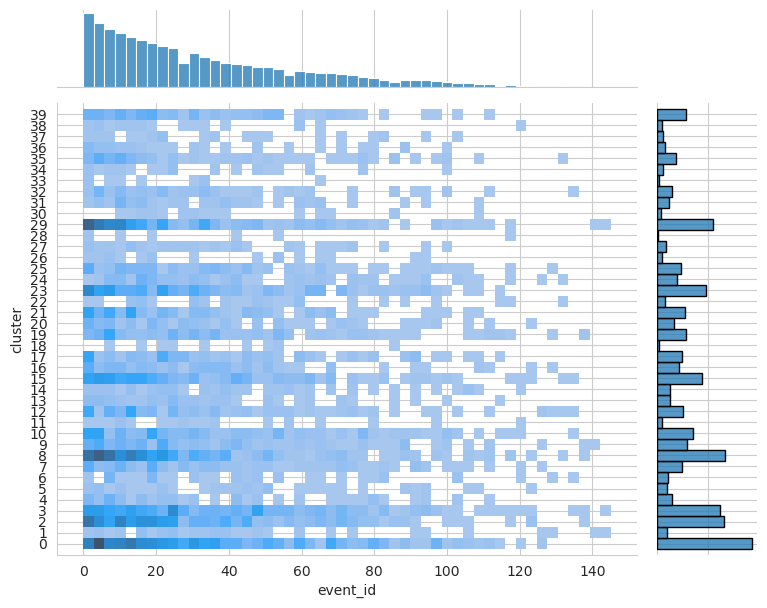

In [379]:
margin_start = 4
margin_end = 4

# Filter the subset for interaction events
Subset_interaction = Subset[Subset["event_type"] == "interaction"]

# Convert cluster to categorical for better plotting
Subset_interaction["cluster"] = Subset_interaction["cluster"].astype("category")

# Define the number of bins for x and y axes
x_bins = 50  # Number of bins for the x-axis (start)
y_bins = 20  # Number of bins for the y-axis (cluster)

# Create the jointplot with kind="hist"
g = sns.jointplot(
    data=Subset_interaction,
    x="event_id",
    y="cluster",
    kind="hist",
    height=8,
    bins=(x_bins, y_bins),  # Set the number of bins for x and y axes
)

# Set aspect ratio AFTER plot creation
g.ax_joint.set_aspect("auto")
g.fig.subplots_adjust(left=0.15, right=0.85)  # Compensate for aspect ratio

# Find min and max cluster values for proper range setting
# cluster_min = Subset_interaction["cluster"].min()
# cluster_max = Subset_interaction["cluster"].max()

# Clear and recreate the y-marginal histogram with precise bins
g.ax_marg_y.clear()
bins = np.arange(0 - margin_start, 7 + margin_end, 1)  # This creates exact bin edges

# Use sns.histplot with the new bins
sns.histplot(
    y=Subset_interaction["cluster"],
    bins=bins,
    ax=g.ax_marg_y,
    kde=False,
    edgecolor="black",
    linewidth=1,
)

# Set y-axis limits
g.ax_joint.set_ylim(cluster_min - 1, cluster_max + 1)

# Set y-ticks to match cluster values
g.ax_joint.set_yticks(np.arange(cluster_min, cluster_max + 1))
g.ax_joint.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"{int(x)}"))

# Completely disable ticks on the marginal plot
g.ax_marg_y.tick_params(
    axis="both",
    which="both",
    length=0,
    width=0,
    labelleft=False,
    left=False,
    labelbottom=False,
    bottom=False,
)

# Remove the spines for a cleaner look on the marginal plot
for spine in g.ax_marg_y.spines.values():
    spine.set_visible(False)

# Remove axis labels from the marginal plot
g.ax_marg_y.set_xlabel("")
g.ax_marg_y.set_ylabel("")

# Do the same for the top histogram
g.ax_marg_x.set_xlabel("")
g.ax_marg_x.set_ylabel("")

# Optional: Fine-tune the figure size if needed
g.fig.set_size_inches(10, 6)  # Adjust these values as needed

# Save the plot
plt.savefig(f"{output_dir}/cluster_evolution_jointplot_Interaction_Hist_byEvents.png")
plt.show()

/tmp/ipykernel_209427/2961545201.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Subset_random["cluster"] = Subset_random["cluster"].astype("category")


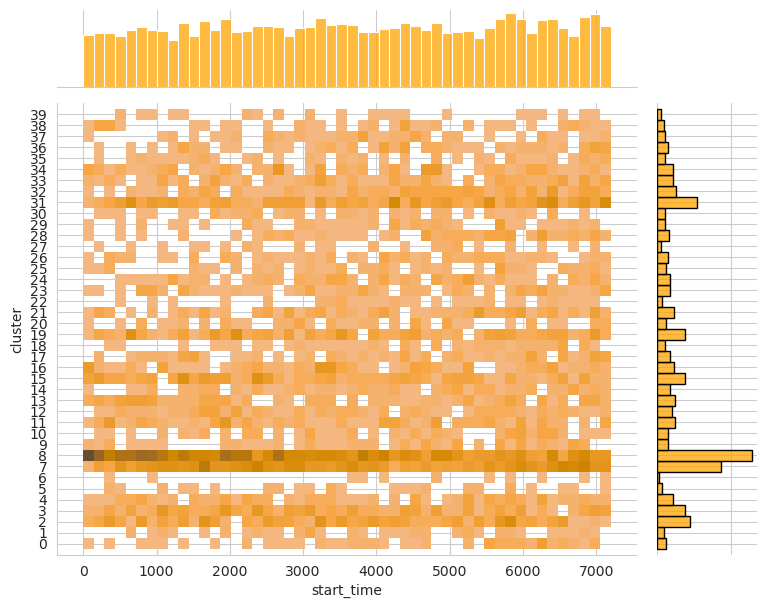

In [380]:
margin_start = 4
margin_end = 4

# Filter the subset for interaction events
Subset_random = Subset[Subset["event_type"] == "random"]

# Convert cluster to categorical for better plotting
Subset_random["cluster"] = Subset_random["cluster"].astype("category")

# Define the number of bins for x and y axes
x_bins = 50  # Number of bins for the x-axis (start)
y_bins = 20  # Number of bins for the y-axis (cluster)

# Create the jointplot with kind="hist"
g = sns.jointplot(
    data=Subset_random,
    x="start_time",
    y="cluster",
    kind="hist",
    height=8,
    bins=(x_bins, y_bins),  # Set the number of bins for x and y axes
    color="orange"
)

# Set aspect ratio AFTER plot creation
g.ax_joint.set_aspect("auto")
g.fig.subplots_adjust(left=0.15, right=0.85)  # Compensate for aspect ratio

# Find min and max cluster values for proper range setting
# cluster_min = Subset_interaction["cluster"].min()
# cluster_max = Subset_interaction["cluster"].max()

# Clear and recreate the y-marginal histogram with precise bins
g.ax_marg_y.clear()
bins = np.arange(0 - margin_start, 7 + margin_end, 1)  # This creates exact bin edges

# Use sns.histplot with the new bins
sns.histplot(
    y=Subset_random["cluster"],
    bins=bins,
    ax=g.ax_marg_y,
    kde=False,
    edgecolor="black",
    linewidth=1,
    color="orange"
)

# Set y-axis limits
g.ax_joint.set_ylim(cluster_min - 1, cluster_max + 1)

# Set y-ticks to match cluster values
g.ax_joint.set_yticks(np.arange(cluster_min, cluster_max + 1))
g.ax_joint.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"{int(x)}"))

# Completely disable ticks on the marginal plot
g.ax_marg_y.tick_params(
    axis="both",
    which="both",
    length=0,
    width=0,
    labelleft=False,
    left=False,
    labelbottom=False,
    bottom=False,
)

# Remove the spines for a cleaner look on the marginal plot
for spine in g.ax_marg_y.spines.values():
    spine.set_visible(False)

# Remove axis labels from the marginal plot
g.ax_marg_y.set_xlabel("")
g.ax_marg_y.set_ylabel("")

# Do the same for the top histogram
g.ax_marg_x.set_xlabel("")
g.ax_marg_x.set_ylabel("")

# Optional: Fine-tune the figure size if needed
g.fig.set_size_inches(10, 6)  # Adjust these values as needed

# Save the plot
plt.savefig(f"{output_dir}/cluster_evolution_jointplot_Random_Hist.png")
plt.show()

/tmp/ipykernel_209427/1879990596.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Subset_random["cluster"] = Subset_random["cluster"].astype("category")


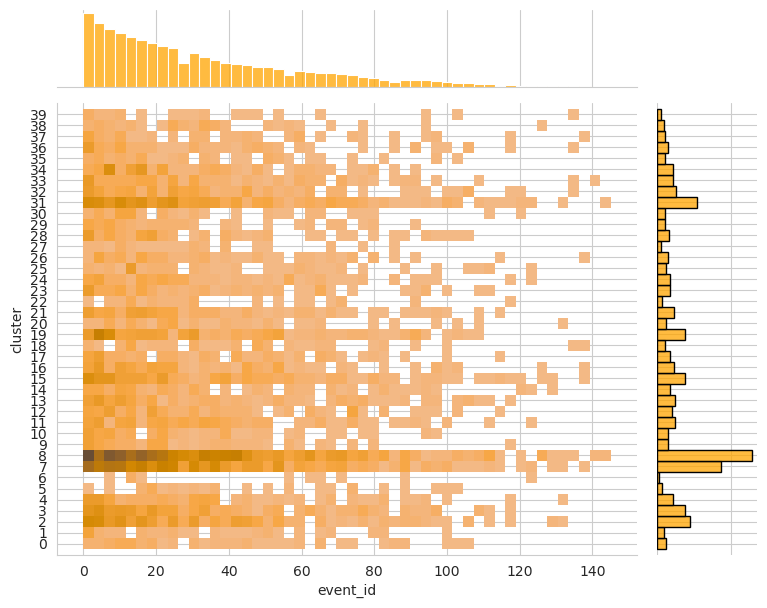

In [383]:
margin_start = 4
margin_end = 4

# Filter the subset for interaction events
Subset_random = Subset[Subset["event_type"] == "random"]

# Convert cluster to categorical for better plotting
Subset_random["cluster"] = Subset_random["cluster"].astype("category")

# Define the number of bins for x and y axes
x_bins = 50  # Number of bins for the x-axis (start)
y_bins = 20  # Number of bins for the y-axis (cluster)

# Create the jointplot with kind="hist"
g = sns.jointplot(
    data=Subset_random,
    x="event_id",
    y="cluster",
    kind="hist",
    height=8,
    bins=(x_bins, y_bins),  # Set the number of bins for x and y axes
    color="orange",
)

# Set aspect ratio AFTER plot creation
g.ax_joint.set_aspect("auto")
g.fig.subplots_adjust(left=0.15, right=0.85)  # Compensate for aspect ratio

# Find min and max cluster values for proper range setting
# cluster_min = Subset_interaction["cluster"].min()
# cluster_max = Subset_interaction["cluster"].max()

# Clear and recreate the y-marginal histogram with precise bins
g.ax_marg_y.clear()
bins = np.arange(0 - margin_start, 7 + margin_end, 1)  # This creates exact bin edges

# Use sns.histplot with the new bins
sns.histplot(
    y=Subset_random["cluster"], bins=bins, ax=g.ax_marg_y, kde=False, edgecolor="black", linewidth=1, color="orange"
)

# Set y-axis limits
g.ax_joint.set_ylim(cluster_min - 1, cluster_max + 1)

# Set y-ticks to match cluster values
g.ax_joint.set_yticks(np.arange(cluster_min, cluster_max + 1))
g.ax_joint.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"{int(x)}"))

# Completely disable ticks on the marginal plot
g.ax_marg_y.tick_params(
    axis="both",
    which="both",
    length=0,
    width=0,
    labelleft=False,
    left=False,
    labelbottom=False,
    bottom=False,
)

# Remove the spines for a cleaner look on the marginal plot
for spine in g.ax_marg_y.spines.values():
    spine.set_visible(False)

# Remove axis labels from the marginal plot
g.ax_marg_y.set_xlabel("")
g.ax_marg_y.set_ylabel("")

# Do the same for the top histogram
g.ax_marg_x.set_xlabel("")
g.ax_marg_x.set_ylabel("")

# Optional: Fine-tune the figure size if needed
g.fig.set_size_inches(10, 6)  # Adjust these values as needed

# Save the plot
plt.savefig(f"{output_dir}/cluster_evolution_jointplot_Random_Hist_byEvents.png")
plt.show()

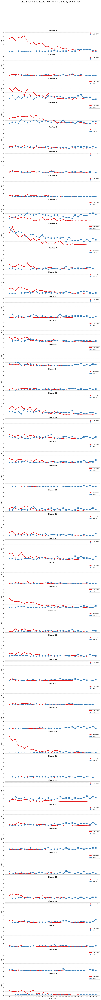

In [384]:
# Get all unique values from your dataset
clusters = sorted(Subset['cluster'].unique())
event_types = sorted(Subset['event_type'].unique())

# Count occurrences for each cluster, event_type, event_id combination
counts = Subset.groupby(['cluster', 'event_type', 'binned_start_time']).size().reset_index(name='count')

# Find global maximum count for consistent y-axis scaling
max_count = counts['count'].max()

# Create a color palette for event types
colors = sns.color_palette("Set1", len(event_types))
event_type_colors = dict(zip(event_types, colors))

# Additional styling options for better differentiation
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', '^', 'D', '*', 'p', 'h']

# Ensure we have enough styles
if len(event_types) > len(line_styles):
    line_styles = line_styles * (len(event_types) // len(line_styles) + 1)
if len(event_types) > len(markers):
    markers = markers * (len(event_types) // len(markers) + 1)

# Create mappings
event_type_styles = dict(zip(event_types, line_styles[:len(event_types)]))
event_type_markers = dict(zip(event_types, markers[:len(event_types)]))

# Create the figure and axes grid - one subplot per cluster
fig, axes = plt.subplots(len(clusters), 1,
                       figsize=(12, 3 * len(clusters)),
                       sharex=True, sharey=True)  # Share both axes

# Ensure axes is always an array
if len(clusters) == 1:
    axes = np.array([axes])

# Get all unique event_ids across all event types
all_event_ids = sorted(Subset["binned_start_time"].unique())

# Plot each cluster
for i, cluster in enumerate(clusters):
    ax = axes[i]

    # Loop through each event type and plot on the same axes with different colors and styles
    for j, event_type in enumerate(event_types):
        # Get data for this cluster and event type
        facet_data = counts[(counts['cluster'] == cluster) &
                         (counts['event_type'] == event_type)]

        # Sort by event_id for proper plotting
        facet_data = facet_data.sort_values("binned_start_time")

        # Plot if there's data
        if len(facet_data) > 0:
            # Use line plot with markers to show evolution
            ax.plot(
                facet_data["binned_start_time"],
                facet_data["count"],
                marker=event_type_markers[event_type],
                markersize=8,
                linestyle=event_type_styles[event_type],
                linewidth=2.5,
                color=event_type_colors[event_type],
                label=f"{event_type}",
            )

    # Set labels and title for subplot
    ax.set_title(f"Cluster {cluster}", fontsize=14, fontweight='bold')
    ax.set_ylabel("Count", fontsize=12)
    if i == len(clusters) - 1:
        ax.set_xlabel("Start time", fontsize=12)

    # Add grid for readability
    ax.grid(True, linestyle='--', alpha=0.7)

    # Set y-axis limits to be the same for all subplots
    ax.set_ylim(0, max(1, max_count * 1.1))  # Add 10% padding

    # Set x-axis to include all event IDs
    ax.set_xticks(all_event_ids)

    # Add legend to each subplot
    ax.legend(loc='upper right')

# Adjust layout
plt.tight_layout()
fig.subplots_adjust(top=0.95)
fig.suptitle('Distribution of Clusters Across start times by Event Type', fontsize=18)
plt.savefig(f"{output_dir}/Cluster_evolution_by_event_type.png")

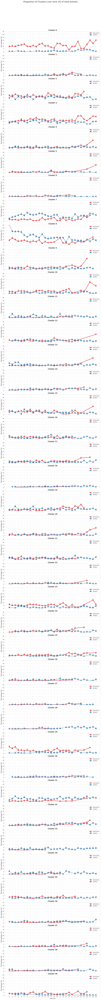

In [385]:
# Get all unique values from your dataset
clusters = sorted(Subset['cluster'].unique())

# IMPORTANT FIX: Use the correct column for event_types
# If you have an actual event_type column:
event_types = sorted(Subset['event_type'].unique())
# OR if you want to just use the time bins as your "event types":
# event_types = sorted(Subset['binned_start'].unique())

# Count occurrences for each cluster, event_type, binned_start combination
counts = Subset.groupby(['cluster', 'event_type', 'binned_start_time']).size().reset_index(name='count')

# Calculate total events for each binned_start and event_type combination
totals = Subset.groupby(["event_type", "binned_start_time"]).size().reset_index(name="total")

# Merge totals with counts to calculate proportions
counts = counts.merge(totals, on=["event_type", "binned_start_time"], how="left")
counts['proportion'] = counts['count'] / counts['total'] * 100  # Convert to percentage

# Create a color palette for event types
colors = sns.color_palette("Set1", len(event_types))
event_type_colors = dict(zip(event_types, colors))

# Additional styling options for better differentiation
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', '^', 'D', '*', 'p', 'h']

# Ensure we have enough styles
if len(event_types) > len(line_styles):
    line_styles = line_styles * (len(event_types) // len(line_styles) + 1)
if len(event_types) > len(markers):
    markers = markers * (len(event_types) // len(markers) + 1)

# Create mappings
event_type_styles = dict(zip(event_types, line_styles[:len(event_types)]))
event_type_markers = dict(zip(event_types, markers[:len(event_types)]))

# Create the figure and axes grid - one subplot per cluster
fig, axes = plt.subplots(len(clusters), 1,
                       figsize=(12, 3 * len(clusters)),
                       sharex=True, sharey=True)  # Share both axes

# Ensure axes is always an array
if len(clusters) == 1:
    axes = np.array([axes])

# Get all unique binned_start values
all_bins = sorted(Subset["binned_start_time"].unique())

# Plot each cluster
for i, cluster in enumerate(clusters):
    ax = axes[i]
    legend_handles = []  # Track if we actually add any plots

    # Loop through each event type and plot on the same axes with different colors and styles
    for j, event_type in enumerate(event_types):
        # Get data for this cluster and event type
        facet_data = counts[(counts['cluster'] == cluster) &
                         (counts['event_type'] == event_type)]

        # Sort by binned_start for proper plotting
        facet_data = facet_data.sort_values("binned_start_time")

        # Plot if there's data
        if len(facet_data) > 0:
            # Use line plot with markers to show evolution, using the proportion
            (line,) = ax.plot(
                facet_data["binned_start_time"],
                facet_data["proportion"],
                marker=event_type_markers[event_type],
                markersize=8,
                linestyle=event_type_styles[event_type],
                linewidth=2.5,
                color=event_type_colors[event_type],
                label=f"{event_type}",
            )

            legend_handles.append(line)

            # Option: Add text labels showing the raw counts for context
            for idx, row in facet_data.iterrows():
                ax.annotate(
                    f"{int(row['count'])}",
                    (row["binned_start_time"], row["proportion"]),
                    textcoords="offset points",
                    xytext=(0, 5),
                    ha="center",
                    fontsize=8,
                )

    # Set labels and title for subplot
    ax.set_title(f"Cluster {cluster}", fontsize=14, fontweight='bold')
    ax.set_ylabel("Percentage (%)", fontsize=12)
    if i == len(clusters) - 1:
        ax.set_xlabel("Time bin", fontsize=12)

    # Add grid for readability
    ax.grid(True, linestyle='--', alpha=0.7)

    # Set y-axis limits to 0-30%
    ax.set_ylim(0, 35)

    # Set x-axis to include all bins
    ax.set_xticks(all_bins)

    # Only add legend if we have plotted data
    if legend_handles:
        ax.legend(loc='upper right')

# Adjust layout
plt.tight_layout()
fig.subplots_adjust(top=0.95)
fig.suptitle('Proportion of Clusters over time (% of total events)', fontsize=18)

plt.savefig(f"{output_dir}/Cluster_evolution_by_event_type_proportions.png")
plt.show()
plt.close()

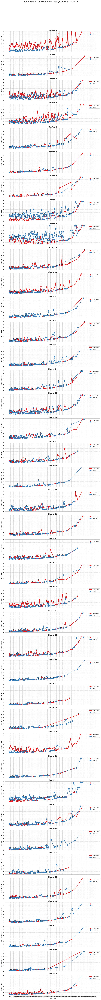

In [386]:
# Get all unique values from your dataset
clusters = sorted(Subset["cluster"].unique())

# IMPORTANT FIX: Use the correct column for event_types
# If you have an actual event_type column:
event_types = sorted(Subset["event_type"].unique())
# OR if you want to just use the time bins as your "event types":
# event_types = sorted(Subset['binned_start'].unique())

# Count occurrences for each cluster, event_type, binned_start combination
counts = Subset.groupby(["cluster", "event_type", "event_id"]).size().reset_index(name="count")

# Calculate total events for each binned_start and event_type combination
totals = Subset.groupby(["event_type", "event_id"]).size().reset_index(name="total")

# Merge totals with counts to calculate proportions
counts = counts.merge(totals, on=["event_type", "event_id"], how="left")
counts["proportion"] = counts["count"] / counts["total"] * 100  # Convert to percentage

# Create a color palette for event types
colors = sns.color_palette("Set1", len(event_types))
event_type_colors = dict(zip(event_types, colors))

# Additional styling options for better differentiation
line_styles = ["-", "--", "-.", ":"]
markers = ["o", "s", "^", "D", "*", "p", "h"]

# Ensure we have enough styles
if len(event_types) > len(line_styles):
    line_styles = line_styles * (len(event_types) // len(line_styles) + 1)
if len(event_types) > len(markers):
    markers = markers * (len(event_types) // len(markers) + 1)

# Create mappings
event_type_styles = dict(zip(event_types, line_styles[: len(event_types)]))
event_type_markers = dict(zip(event_types, markers[: len(event_types)]))

# Create the figure and axes grid - one subplot per cluster
fig, axes = plt.subplots(len(clusters), 1, figsize=(12, 3 * len(clusters)), sharex=True, sharey=True)  # Share both axes

# Ensure axes is always an array
if len(clusters) == 1:
    axes = np.array([axes])

# Get all unique binned_start values
all_bins = sorted(Subset["event_id"].unique())

# Plot each cluster
for i, cluster in enumerate(clusters):
    ax = axes[i]
    legend_handles = []  # Track if we actually add any plots

    # Loop through each event type and plot on the same axes with different colors and styles
    for j, event_type in enumerate(event_types):
        # Get data for this cluster and event type
        facet_data = counts[(counts["cluster"] == cluster) & (counts["event_type"] == event_type)]

        # Sort by binned_start for proper plotting
        facet_data = facet_data.sort_values("event_id")

        # Plot if there's data
        if len(facet_data) > 0:
            # Use line plot with markers to show evolution, using the proportion
            (line,) = ax.plot(
                facet_data["event_id"],
                facet_data["proportion"],
                marker=event_type_markers[event_type],
                markersize=8,
                linestyle=event_type_styles[event_type],
                linewidth=2.5,
                color=event_type_colors[event_type],
                label=f"{event_type}",
            )

            legend_handles.append(line)

            # Option: Add text labels showing the raw counts for context
            for idx, row in facet_data.iterrows():
                ax.annotate(
                    f"{int(row['count'])}",
                    (row["event_id"], row["proportion"]),
                    textcoords="offset points",
                    xytext=(0, 5),
                    ha="center",
                    fontsize=8,
                )

    # Set labels and title for subplot
    ax.set_title(f"Cluster {cluster}", fontsize=14, fontweight="bold")
    ax.set_ylabel("Percentage (%)", fontsize=12)
    if i == len(clusters) - 1:
        ax.set_xlabel("Time bin", fontsize=12)

    # Add grid for readability
    ax.grid(True, linestyle="--", alpha=0.7)

    # Set y-axis limits to 0-30%
    ax.set_ylim(0, 35)

    # Set x-axis to include all bins
    ax.set_xticks(all_bins)

    # Only add legend if we have plotted data
    if legend_handles:
        ax.legend(loc="upper right")

# Adjust layout
plt.tight_layout()
fig.subplots_adjust(top=0.95)
fig.suptitle("Proportion of Clusters over time (% of total events)", fontsize=18)

plt.savefig(f"{output_dir}/Cluster_evolution_by_event_type_proportions_byEvents.png")
plt.show()
plt.close()

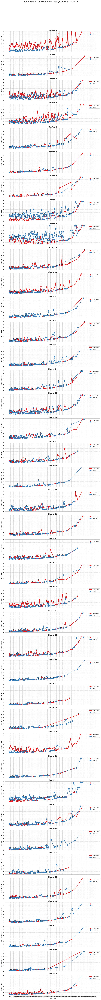

In [387]:
Umap_Lighton = Umap[Umap["Light"].isin(["on"])]

# Get all unique values from your dataset
clusters = sorted(Umap_Lighton["cluster"].unique())

# IMPORTANT FIX: Use the correct column for event_types
# If you have an actual event_type column:
event_types = sorted(Umap_Lighton["event_type"].unique())
# OR if you want to just use the time bins as your "event types":
# event_types = sorted(Subset['binned_start'].unique())

# Count occurrences for each cluster, event_type, binned_start combination
counts = Umap_Lighton.groupby(["cluster", "event_type", "event_id"]).size().reset_index(name="count")

# Calculate total events for each binned_start and event_type combination
totals = Umap_Lighton.groupby(["event_type", "event_id"]).size().reset_index(name="total")

# Merge totals with counts to calculate proportions
counts = counts.merge(totals, on=["event_type", "event_id"], how="left")
counts["proportion"] = counts["count"] / counts["total"] * 100  # Convert to percentage

# Create a color palette for event types
colors = sns.color_palette("Set1", len(event_types))
event_type_colors = dict(zip(event_types, colors))

# Additional styling options for better differentiation
line_styles = ["-", "--", "-.", ":"]
markers = ["o", "s", "^", "D", "*", "p", "h"]

# Ensure we have enough styles
if len(event_types) > len(line_styles):
    line_styles = line_styles * (len(event_types) // len(line_styles) + 1)
if len(event_types) > len(markers):
    markers = markers * (len(event_types) // len(markers) + 1)

# Create mappings
event_type_styles = dict(zip(event_types, line_styles[: len(event_types)]))
event_type_markers = dict(zip(event_types, markers[: len(event_types)]))

# Create the figure and axes grid - one subplot per cluster
fig, axes = plt.subplots(len(clusters), 1, figsize=(12, 3 * len(clusters)), sharex=True, sharey=True)  # Share both axes

# Ensure axes is always an array
if len(clusters) == 1:
    axes = np.array([axes])

# Get all unique binned_start values
all_bins = sorted(Umap_Lighton["event_id"].unique())

# Plot each cluster
for i, cluster in enumerate(clusters):
    ax = axes[i]
    legend_handles = []  # Track if we actually add any plots

    # Loop through each event type and plot on the same axes with different colors and styles
    for j, event_type in enumerate(event_types):
        # Get data for this cluster and event type
        facet_data = counts[(counts["cluster"] == cluster) & (counts["event_type"] == event_type)]

        # Sort by binned_start for proper plotting
        facet_data = facet_data.sort_values("event_id")

        # Plot if there's data
        if len(facet_data) > 0:
            # Use line plot with markers to show evolution, using the proportion
            (line,) = ax.plot(
                facet_data["event_id"],
                facet_data["proportion"],
                marker=event_type_markers[event_type],
                markersize=8,
                linestyle=event_type_styles[event_type],
                linewidth=2.5,
                color=event_type_colors[event_type],
                label=f"{event_type}",
            )

            legend_handles.append(line)

            # Option: Add text labels showing the raw counts for context
            for idx, row in facet_data.iterrows():
                ax.annotate(
                    f"{int(row['count'])}",
                    (row["event_id"], row["proportion"]),
                    textcoords="offset points",
                    xytext=(0, 5),
                    ha="center",
                    fontsize=8,
                )

    # Set labels and title for subplot
    ax.set_title(f"Cluster {cluster}", fontsize=14, fontweight="bold")
    ax.set_ylabel("Percentage (%)", fontsize=12)
    if i == len(clusters) - 1:
        ax.set_xlabel("Time bin", fontsize=12)

    # Add grid for readability
    ax.grid(True, linestyle="--", alpha=0.7)

    # Set y-axis limits to 0-30%
    ax.set_ylim(0, 35)

    # Set x-axis to include all bins
    ax.set_xticks(all_bins)

    # Only add legend if we have plotted data
    if legend_handles:
        ax.legend(loc="upper right")

# Adjust layout
plt.tight_layout()
fig.subplots_adjust(top=0.95)
fig.suptitle("Proportion of Clusters over time (% of total events)", fontsize=18)

plt.savefig(f"{output_dir}/Cluster_evolution_by_event_type_proportions_byEvents_PoolFeedingState.png")
plt.show()
plt.close()

## Checking clusters "efficiency"

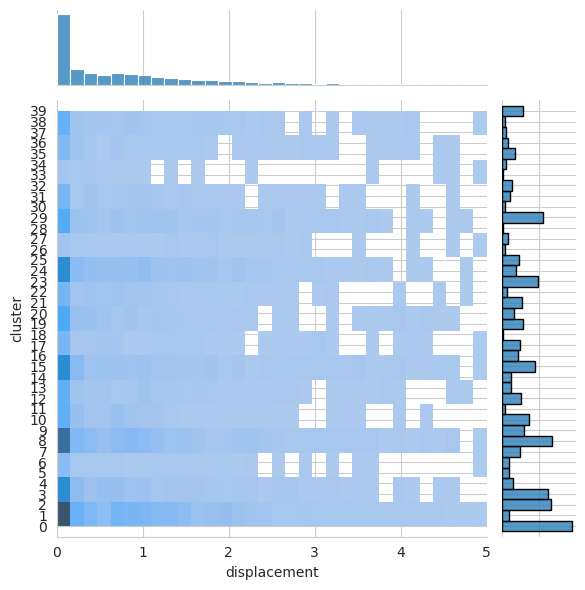

In [388]:
Subset_interaction = Subset[Subset["event_type"] == "interaction"]

# Create the jointplot and save the grid object
g = sns.jointplot(data=Subset_interaction, x=np.log1p(Subset_interaction["displacement"]), y="cluster", kind="hist")

# Find min and max cluster values for proper range setting
cluster_min = Subset_interaction["cluster"].min()
cluster_max = Subset_interaction["cluster"].max()

# Clear and recreate the y-marginal histogram with precise bins
g.ax_marg_y.clear()
clusters = sorted(Subset_interaction["cluster"].unique())
bins = np.arange(min(clusters)-0.5, max(clusters)+1.5, 1)

# Use sns.histplot for better styling
sns.histplot(y=Subset_interaction["cluster"], bins=bins, ax=g.ax_marg_y,
             kde=False, edgecolor='black', linewidth=1)

# Set the y-axis limits on main plot
g.ax_joint.set_ylim(cluster_min-1, cluster_max+1)

# Set the y-ticks on main plot
g.ax_joint.set_xlim(0, 5)

# Set the y-ticks on main plot
g.ax_joint.set_yticks(range(cluster_min, cluster_max+1))
g.ax_joint.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"{int(x)}"))

# Completely disable ticks on the marginal plot
g.ax_marg_y.tick_params(axis='both', which='both', length=0, width=0,
                        labelleft=False, left=False,
                        labelbottom=False, bottom=False)

# Remove the spines for a cleaner look on the marginal plot
for spine in g.ax_marg_y.spines.values():
    spine.set_visible(False)

# Remove axis labels from the marginal plot
g.ax_marg_y.set_xlabel('')
g.ax_marg_y.set_ylabel('')

# Do the same for the top histogram
g.ax_marg_x.set_xlabel('')
g.ax_marg_x.set_ylabel('')

plt.savefig(f"{output_dir}/cluster_efficiency_jointplot_Interaction.png")

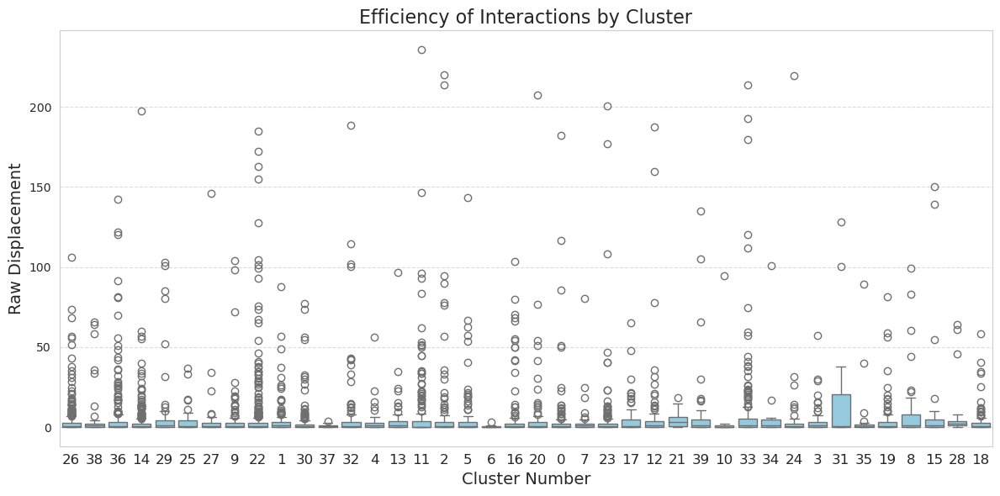

In [389]:
# Let's rank the clusters by the median efficiency of interactions

Subset_positive = Subset_interaction#[Subset_interaction["displacement"] > 0]

# Rank the clusters by median efficiency

cluster_ranking = Subset_positive.groupby("cluster")["displacement"].median().sort_values(ascending=False)

# Get the order of the clusters

cluster_order = cluster_ranking.index

# Make a boxplot of the raw_displacement by cluster
plt.figure(figsize=(12, 6))

sns.boxplot(data=Subset_positive, x="cluster", y="displacement", color="skyblue")

plt.title("Efficiency of Interactions by Cluster", fontsize=16)
plt.xlabel("Cluster Number", fontsize=14)
plt.ylabel("Raw Displacement", fontsize=14)

plt.xticks(range(len(cluster_order)), cluster_order, fontsize=12)

plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()

/tmp/ipykernel_209427/1057314208.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Subset_interaction["log_displacement"] = np.log1p(Subset_interaction["displacement"])


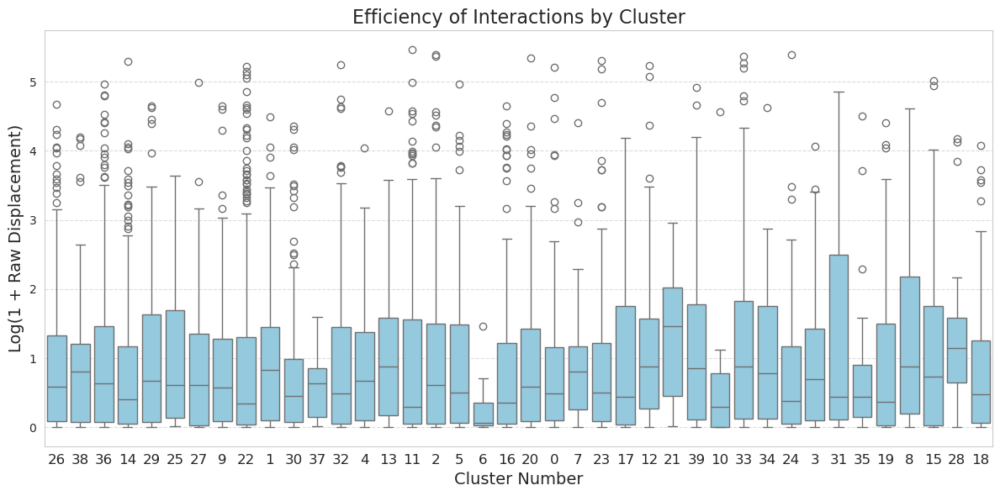

In [390]:
# Log version

Subset_interaction["log_displacement"] = np.log1p(Subset_interaction["displacement"])

# Make a boxplot of the log_displacement by cluster

plt.figure(figsize=(12, 6))

sns.boxplot(data=Subset_interaction, x="cluster", y="log_displacement", color="skyblue")

plt.title("Efficiency of Interactions by Cluster", fontsize=16)

plt.xlabel("Cluster Number", fontsize=14)

plt.ylabel("Log(1 + Raw Displacement)", fontsize=14)

plt.xticks(range(len(cluster_order)), cluster_order, fontsize=12)

plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()

/tmp/ipykernel_209427/4225100830.py:2: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(


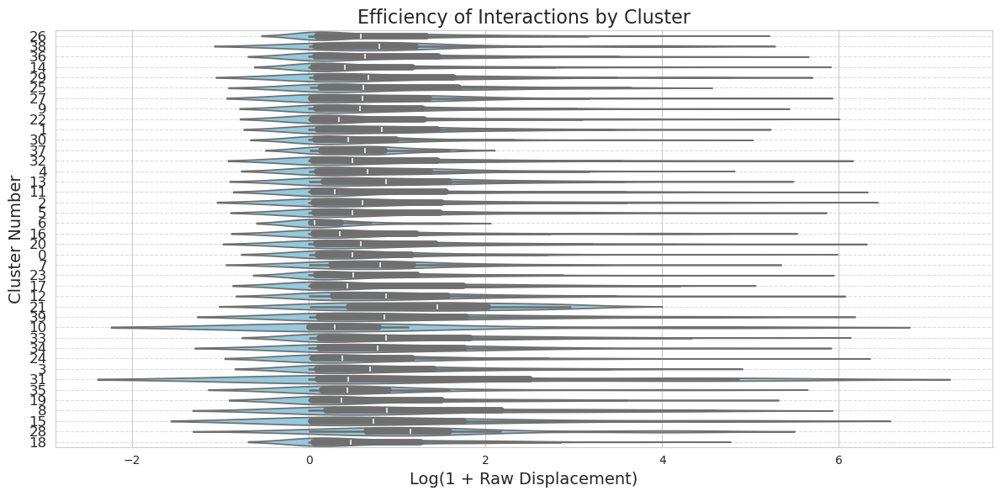

In [391]:
plt.figure(figsize=(12, 6))
sns.violinplot(
    data=Subset_interaction, x="log_displacement", y="cluster", color="skyblue", orient="h", scale="width", width=0.8
)
plt.title("Efficiency of Interactions by Cluster", fontsize=16)
plt.ylabel("Cluster Number", fontsize=14)
plt.xlabel("Log(1 + Raw Displacement)", fontsize=14)
plt.yticks(range(len(cluster_order)), cluster_order, fontsize=12)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()

Cluster 29: [ 5.33851208 11.03508387]
Cluster 16: [ 5.03331185 17.7004215 ]
Cluster 8: [ 5.49972564 10.52268168]
Cluster 5: [2.18614939 6.08425853]
Cluster 12: [ 4.02033    12.14720507]
Cluster 17: [ 3.32623815 10.00424089]
Cluster 7: [2.60865152 7.90832183]
Cluster 19: [3.91129382 9.25693482]
Cluster 0: [2.70552612 4.38248926]
Cluster 15: [ 4.94129318 11.13945524]
Cluster 37: [ 2.63856527 30.90636006]
Cluster 1: [ 2.85700928 11.12081936]
Cluster 20: [ 3.16658089 12.74636086]
Cluster 3: [2.70310016 5.834513  ]
Cluster 22: [1.66570113 9.01365379]
Cluster 39: [2.04871579 4.55352873]
Cluster 2: [4.0260493  7.75477691]
Cluster 36: [ 4.79279506 18.52561067]
Cluster 4: [ 4.13754747 13.28063752]
Cluster 14: [2.64295039 8.33314115]
Cluster 13: [1.54685666 5.14790389]
Cluster 27: [ 4.01291801 22.38862162]
Cluster 23: [2.49251072 7.30718561]
Cluster 10: [2.16007691 5.13381175]
Cluster 32: [2.36188212 6.3475696 ]
Cluster 31: [ 1.58937365 14.03696134]
Cluster 25: [ 3.72418141 11.66199296]
Cluster 

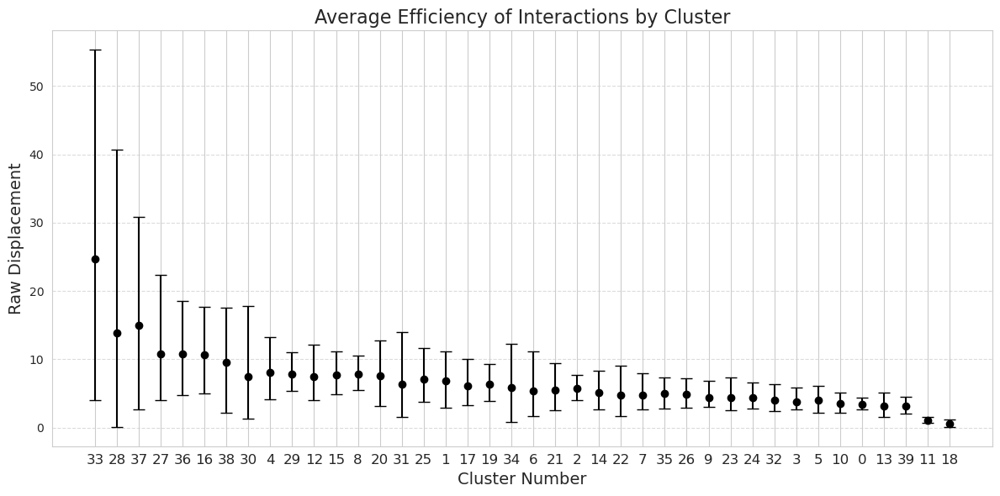

In [392]:
# Let's compute bootstrapped confidence intervals for average efficiency of interactions per cluster

clusters_bs_ci = {}

for cluster in Subset_interaction["cluster"].unique():
    cluster_data = Subset_interaction[Subset_interaction["cluster"] == cluster]

    bs_ci = Processing.draw_bs_ci(cluster_data["displacement"], np.mean)

    clusters_bs_ci[cluster] = bs_ci

    print(f"Cluster {cluster}: {bs_ci}")

# Rank the clusters by the average efficiency of interactions

cluster_ranking = {cluster: np.mean(ci) for cluster, ci in clusters_bs_ci.items()}

cluster_order = [cluster for cluster, _ in sorted(cluster_ranking.items(), key=lambda x: x[1], reverse=True)]


# Let's plot the average efficiency of interactions per cluster with bootstrapped confidence intervals

plt.figure(figsize=(12, 6))

# Plot the bootstrapped confidence intervals
for cluster in cluster_order:
    low, high = clusters_bs_ci[cluster]
    mean_value = Subset_interaction[Subset_interaction["cluster"] == cluster]["displacement"].mean()
    plt.errorbar(cluster_order.index(cluster), mean_value, yerr=[[mean_value - low], [high - mean_value]], fmt='o', color='black', capsize=5)

plt.title("Average Efficiency of Interactions by Cluster", fontsize=16)
plt.xlabel("Cluster Number", fontsize=14)
plt.ylabel("Raw Displacement", fontsize=14)
plt.xticks(range(len(cluster_order)), cluster_order, fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/average_efficiency_interactions_by_cluster.png")
plt.show()

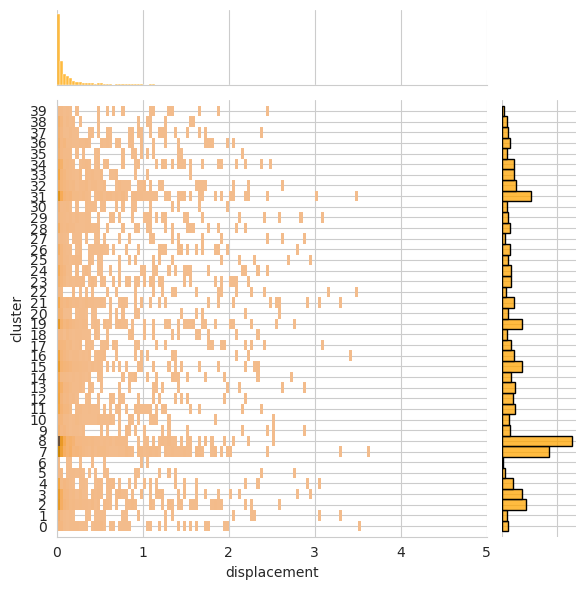

In [393]:
# Create the jointplot and save the grid object
g = sns.jointplot(data=Subset_random, x=np.log1p(Subset_random["displacement"]), y="cluster", kind="hist", color="orange")


# Clear and recreate the y-marginal histogram with precise bins
g.ax_marg_y.clear()
clusters = sorted(Subset_random["cluster"].unique())
bins = np.arange(min(clusters)-0.5, max(clusters)+1.5, 1)

# Use sns.histplot for better styling
sns.histplot(y=Subset_random["cluster"], bins=bins, ax=g.ax_marg_y,
             kde=False, edgecolor='black', linewidth=1, color="orange")

# Set the y-axis limits on main plot
g.ax_joint.set_ylim(cluster_min-1, cluster_max+1)

# Set the x-axis limits on main plot

g.ax_joint.set_xlim(0, 5)

# Set the y-ticks on main plot
g.ax_joint.set_yticks(range(cluster_min, cluster_max+1))
g.ax_joint.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"{int(x)}"))

# Completely disable ticks on the marginal plot
g.ax_marg_y.tick_params(axis='both', which='both', length=0, width=0,
                        labelleft=False, left=False,
                        labelbottom=False, bottom=False)

# Remove the spines for a cleaner look on the marginal plot
for spine in g.ax_marg_y.spines.values():
    spine.set_visible(False)

# Remove axis labels from the marginal plot
g.ax_marg_y.set_xlabel('')
g.ax_marg_y.set_ylabel('')

# Do the same for the top histogram
g.ax_marg_x.set_xlabel('')
g.ax_marg_x.set_ylabel('')

plt.savefig(f"{output_dir}/cluster_efficiency_jointplot_Random.png")

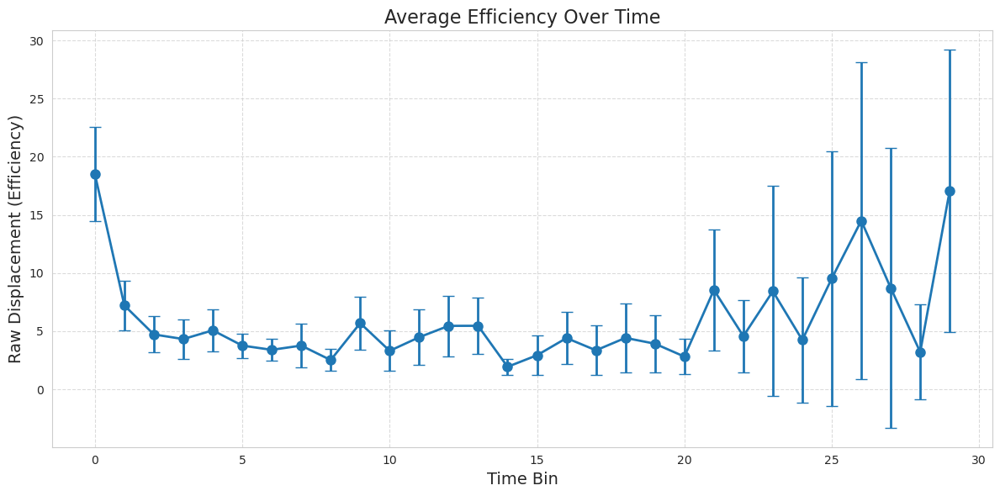

In [394]:
# Calculate average efficiency (raw_displacement) for each time bin
efficiency_over_time = Subset_interaction.groupby('binned_start_time')['displacement'].agg(['mean', 'count', 'std']).reset_index()

# Calculate 95% confidence interval
efficiency_over_time['ci'] = 1.96 * efficiency_over_time['std'] / np.sqrt(efficiency_over_time['count'])

# Plot average efficiency over time with confidence intervals
plt.figure(figsize=(12, 6))
plt.errorbar(
    efficiency_over_time["binned_start_time"],
    efficiency_over_time["mean"],
    yerr=efficiency_over_time["ci"],
    fmt="o-",
    capsize=5,
    linewidth=2,
    markersize=8,
)

plt.title('Average Efficiency Over Time', fontsize=16)
plt.xlabel('Time Bin', fontsize=14)
plt.ylabel('Raw Displacement (Efficiency)', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.savefig(f"{output_dir}/average_efficiency_over_time_all.png")
plt.show()

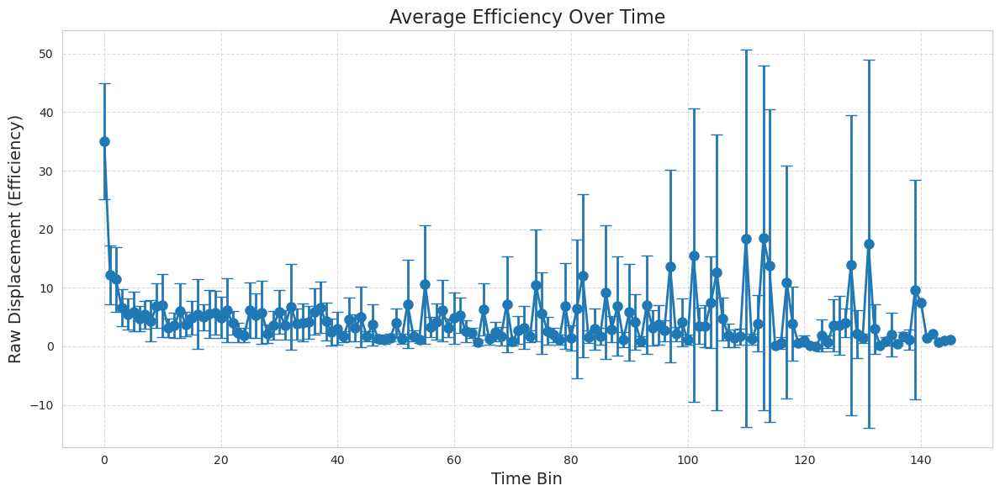

In [395]:
# Calculate average efficiency (raw_displacement) for each time bin
efficiency_over_time = (
    Subset_interaction.groupby("event_id")["displacement"].agg(["mean", "count", "std"]).reset_index()
)

# Calculate 95% confidence interval
efficiency_over_time["ci"] = 1.96 * efficiency_over_time["std"] / np.sqrt(efficiency_over_time["count"])

# Plot average efficiency over time with confidence intervals
plt.figure(figsize=(12, 6))
plt.errorbar(
    efficiency_over_time["event_id"],
    efficiency_over_time["mean"],
    yerr=efficiency_over_time["ci"],
    fmt="o-",
    capsize=5,
    linewidth=2,
    markersize=8,
)

plt.title("Average Efficiency Over Time", fontsize=16)
plt.xlabel("Time Bin", fontsize=14)
plt.ylabel("Raw Displacement (Efficiency)", fontsize=14)
plt.grid(True, linestyle="--", alpha=0.7)
plt.tight_layout()
plt.savefig(f"{output_dir}/average_efficiency_over_events_all.png")
plt.show()

Efficient clusters: [np.int32(29), np.int32(16), np.int32(8), np.int32(12), np.int32(17), np.int32(7), np.int32(19), np.int32(37), np.int32(2), np.int32(36), np.int32(4), np.int32(10), np.int32(31), np.int32(25), np.int32(21), np.int32(35), np.int32(28), np.int32(9), np.int32(33), np.int32(38)]
Inefficient clusters: [np.int32(5), np.int32(0), np.int32(15), np.int32(1), np.int32(20), np.int32(3), np.int32(22), np.int32(39), np.int32(14), np.int32(13), np.int32(27), np.int32(23), np.int32(32), np.int32(6), np.int32(24), np.int32(30), np.int32(11), np.int32(26), np.int32(18), np.int32(34)]


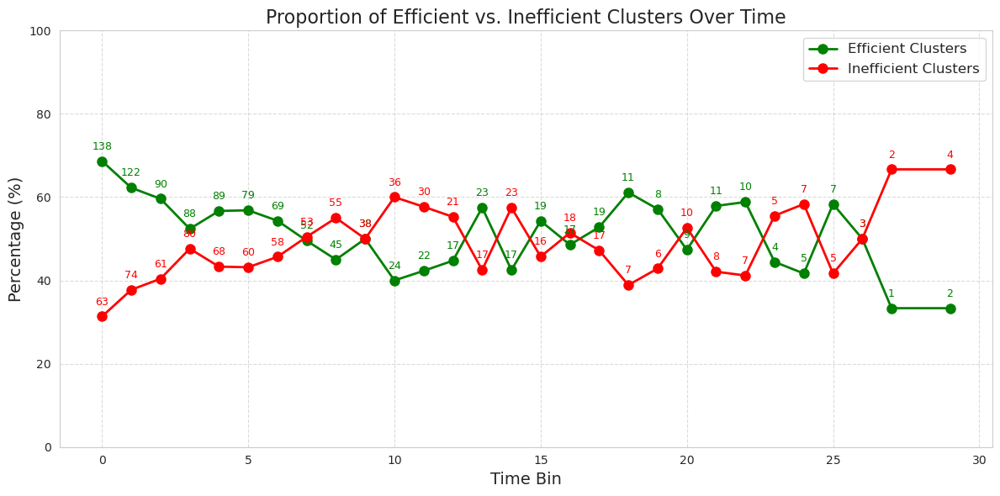

In [357]:
# Identify efficient vs. inefficient clusters (using median as cutoff)
median_efficiency = np.median(list(cluster_ranking.values()))

threshold = median_efficiency

efficient_clusters = [c for c, v in cluster_ranking.items() if v >= threshold]
inefficient_clusters = [c for c, v in cluster_ranking.items() if v < threshold]

print(f"Efficient clusters: {efficient_clusters}")
print(f"Inefficient clusters: {inefficient_clusters}")

# Calculate the proportion of efficient and inefficient clusters over time
efficiency_dist = []

for time_bin in sorted(Subset_interaction["binned_start_time"].unique()):
    bin_data = Subset_interaction[Subset_interaction["binned_start_time"] == time_bin]
    total_count = len(bin_data)

    if total_count > 0:
        efficient_count = len(bin_data[bin_data['cluster'].isin(efficient_clusters)])
        inefficient_count = len(bin_data[bin_data['cluster'].isin(inefficient_clusters)])

        efficiency_dist.append(
            {
                "binned_start_time": time_bin,
                "efficient_prop": efficient_count / total_count * 100,
                "inefficient_prop": inefficient_count / total_count * 100,
                "efficient_count": efficient_count,
                "inefficient_count": inefficient_count,
                "total_count": total_count,
            }
        )

efficiency_dist_df = pd.DataFrame(efficiency_dist)

# Plot the proportion of efficient vs. inefficient clusters over time
plt.figure(figsize=(12, 6))

plt.plot(
    efficiency_dist_df["binned_start_time"],
    efficiency_dist_df["efficient_prop"],
    "o-",
    color="green",
    linewidth=2,
    markersize=8,
    label="Efficient Clusters",
)
plt.plot(
    efficiency_dist_df["binned_start_time"],
    efficiency_dist_df["inefficient_prop"],
    "o-",
    color="red",
    linewidth=2,
    markersize=8,
    label="Inefficient Clusters",
)

# Add counts as annotations
for i, row in efficiency_dist_df.iterrows():
    plt.annotate(
        f"{int(row['efficient_count'])}",
        (row["binned_start_time"], row["efficient_prop"]),
        textcoords="offset points",
        xytext=(0, 10),
        ha="center",
        color="green",
        fontsize=9,
    )
    plt.annotate(
        f"{int(row['inefficient_count'])}",
        (row["binned_start_time"], row["inefficient_prop"]),
        textcoords="offset points",
        xytext=(0, 10),
        ha="center",
        color="red",
        fontsize=9,
    )

plt.title('Proportion of Efficient vs. Inefficient Clusters Over Time', fontsize=16)
plt.xlabel('Time Bin', fontsize=14)
plt.ylabel('Percentage (%)', fontsize=14)
plt.legend(fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)
plt.ylim(0, 100)
plt.tight_layout()
plt.savefig(f"{output_dir}/efficiency_proportion_over_time_all.png")
plt.show()

Efficient clusters: [np.int32(29), np.int32(16), np.int32(8), np.int32(12), np.int32(17), np.int32(7), np.int32(19), np.int32(37), np.int32(2), np.int32(36), np.int32(4), np.int32(10), np.int32(31), np.int32(25), np.int32(21), np.int32(35), np.int32(28), np.int32(9), np.int32(33), np.int32(38)]
Inefficient clusters: [np.int32(5), np.int32(0), np.int32(15), np.int32(1), np.int32(20), np.int32(3), np.int32(22), np.int32(39), np.int32(14), np.int32(13), np.int32(27), np.int32(23), np.int32(32), np.int32(6), np.int32(24), np.int32(30), np.int32(11), np.int32(26), np.int32(18), np.int32(34)]


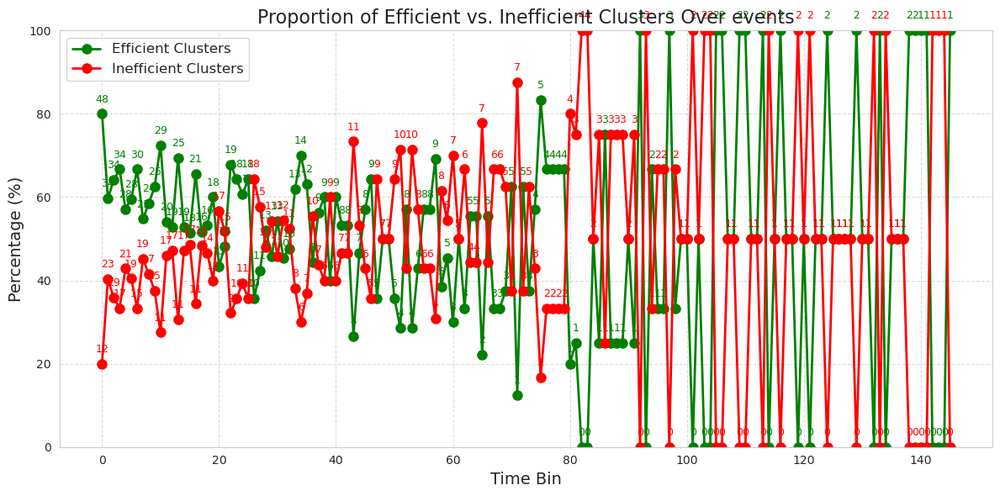

In [358]:
# Identify efficient vs. inefficient clusters (using median as cutoff)
median_efficiency = np.median(list(cluster_ranking.values()))

threshold = median_efficiency

efficient_clusters = [c for c, v in cluster_ranking.items() if v >= threshold]
inefficient_clusters = [c for c, v in cluster_ranking.items() if v < threshold]

print(f"Efficient clusters: {efficient_clusters}")
print(f"Inefficient clusters: {inefficient_clusters}")

# Calculate the proportion of efficient and inefficient clusters over time
efficiency_dist = []

for time_bin in sorted(Subset_interaction["event_id"].unique()):
    bin_data = Subset_interaction[Subset_interaction["event_id"] == time_bin]
    total_count = len(bin_data)

    if total_count > 0:
        efficient_count = len(bin_data[bin_data["cluster"].isin(efficient_clusters)])
        inefficient_count = len(bin_data[bin_data["cluster"].isin(inefficient_clusters)])

        efficiency_dist.append(
            {
                "event_id": time_bin,
                "efficient_prop": efficient_count / total_count * 100,
                "inefficient_prop": inefficient_count / total_count * 100,
                "efficient_count": efficient_count,
                "inefficient_count": inefficient_count,
                "total_count": total_count,
            }
        )

efficiency_dist_df = pd.DataFrame(efficiency_dist)

# Plot the proportion of efficient vs. inefficient clusters over time
plt.figure(figsize=(12, 6))

plt.plot(
    efficiency_dist_df["event_id"],
    efficiency_dist_df["efficient_prop"],
    "o-",
    color="green",
    linewidth=2,
    markersize=8,
    label="Efficient Clusters",
)
plt.plot(
    efficiency_dist_df["event_id"],
    efficiency_dist_df["inefficient_prop"],
    "o-",
    color="red",
    linewidth=2,
    markersize=8,
    label="Inefficient Clusters",
)

# Add counts as annotations
for i, row in efficiency_dist_df.iterrows():
    plt.annotate(
        f"{int(row['efficient_count'])}",
        (row["event_id"], row["efficient_prop"]),
        textcoords="offset points",
        xytext=(0, 10),
        ha="center",
        color="green",
        fontsize=9,
    )
    plt.annotate(
        f"{int(row['inefficient_count'])}",
        (row["event_id"], row["inefficient_prop"]),
        textcoords="offset points",
        xytext=(0, 10),
        ha="center",
        color="red",
        fontsize=9,
    )

plt.title("Proportion of Efficient vs. Inefficient Clusters Over events", fontsize=16)
plt.xlabel("Time Bin", fontsize=14)
plt.ylabel("Percentage (%)", fontsize=14)
plt.legend(fontsize=12)
plt.grid(True, linestyle="--", alpha=0.7)
plt.ylim(0, 100)
plt.tight_layout()
plt.savefig(f"{output_dir}/efficiency_proportion_over_events_all.png")
plt.show()

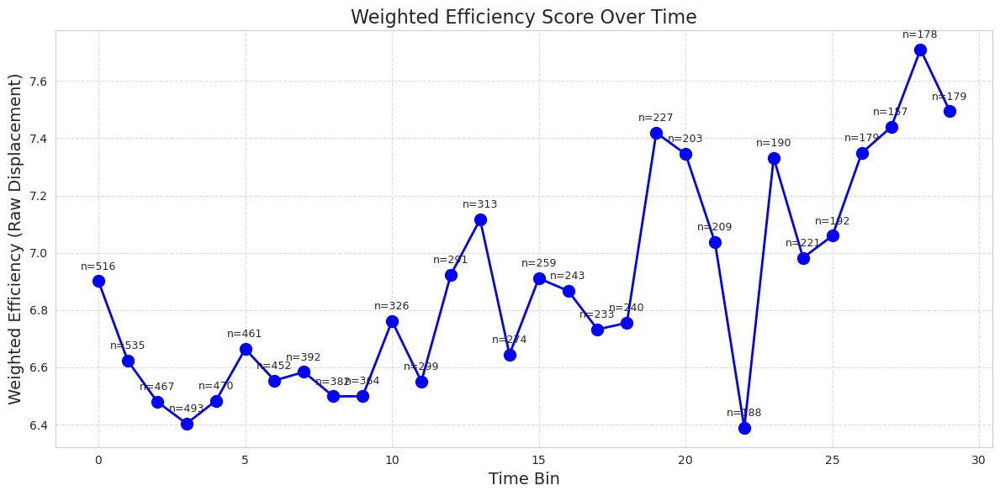

In [396]:
# Calculate weighted efficiency for each time bin
weighted_efficiency = []

for time_bin in sorted(Subset_interaction["binned_start_time"].unique()):
    bin_data = Subset[Subset["binned_start_time"] == time_bin]

    if len(bin_data) > 0:
        # Calculate proportion of each cluster in this time bin
        cluster_counts = bin_data['cluster'].value_counts()
        total_in_bin = cluster_counts.sum()

        # Calculate weighted efficiency
        weighted_eff = 0
        for cluster, count in cluster_counts.items():
            if cluster in cluster_ranking:
                cluster_eff = cluster_ranking[cluster]
                weighted_eff += (count / total_in_bin) * cluster_eff

        weighted_efficiency.append({
            'binned_start': time_bin,
            'weighted_efficiency': weighted_eff,
            'total_count': total_in_bin
        })

weighted_efficiency_df = pd.DataFrame(weighted_efficiency)

# Plot weighted efficiency over time
plt.figure(figsize=(12, 6))
plt.plot(weighted_efficiency_df['binned_start'], weighted_efficiency_df['weighted_efficiency'],
         'o-', color='blue', linewidth=2, markersize=10)

# Add sample size as annotations
for i, row in weighted_efficiency_df.iterrows():
    plt.annotate(f"n={int(row['total_count'])}",
               (row['binned_start'], row['weighted_efficiency']),
               textcoords="offset points",
               xytext=(0,10),
               ha='center',
               fontsize=9)

plt.title('Weighted Efficiency Score Over Time', fontsize=16)
plt.xlabel('Time Bin', fontsize=14)
plt.ylabel('Weighted Efficiency (Raw Displacement)', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.savefig(f"{output_dir}/weighted_efficiency_over_time.png")
plt.show()

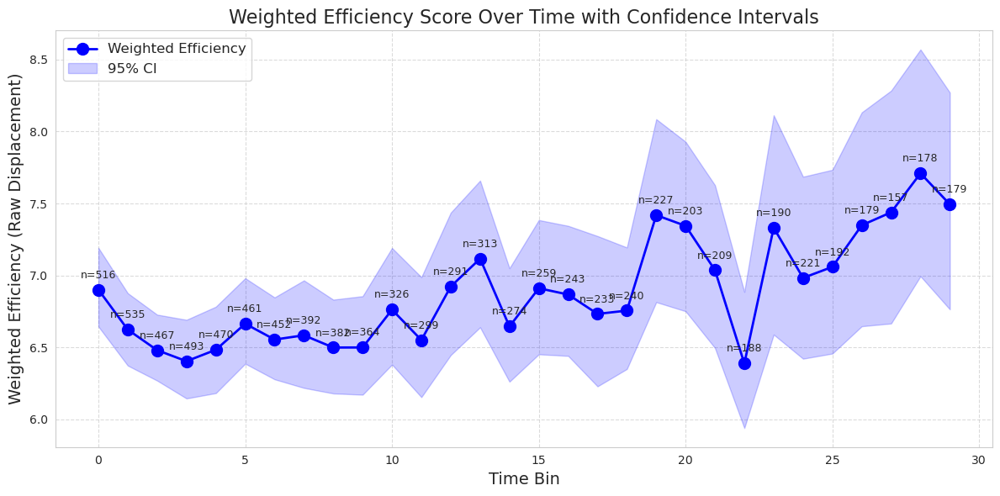

In [399]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import norm

# Calculate weighted efficiency for each time bin with confidence intervals
weighted_efficiency = []

for time_bin in sorted(Subset_interaction["binned_start_time"].unique()):
    bin_data = Subset[Subset["binned_start_time"] == time_bin]

    if len(bin_data) > 0:
        # Calculate proportion of each cluster in this time bin
        cluster_counts = bin_data["cluster"].value_counts()
        total_in_bin = cluster_counts.sum()

        # Calculate weighted efficiency
        weighted_eff = 0
        for cluster, count in cluster_counts.items():
            if cluster in cluster_ranking:
                cluster_eff = cluster_ranking[cluster]
                weighted_eff += (count / total_in_bin) * cluster_eff

        # Bootstrap to calculate confidence intervals
        bootstrap_samples = 1000
        bootstrap_efficiencies = []
        for _ in range(bootstrap_samples):
            # Resample with replacement
            resampled_data = bin_data.sample(n=len(bin_data), replace=True)
            resampled_cluster_counts = resampled_data["cluster"].value_counts()
            resampled_total = resampled_cluster_counts.sum()

            resampled_eff = 0
            for cluster, count in resampled_cluster_counts.items():
                if cluster in cluster_ranking:
                    cluster_eff = cluster_ranking[cluster]
                    resampled_eff += (count / resampled_total) * cluster_eff

            bootstrap_efficiencies.append(resampled_eff)

        # Calculate confidence intervals (e.g., 95%)
        lower_ci = np.percentile(bootstrap_efficiencies, 2.5)
        upper_ci = np.percentile(bootstrap_efficiencies, 97.5)

        weighted_efficiency.append(
            {
                "binned_start": time_bin,
                "weighted_efficiency": weighted_eff,
                "total_count": total_in_bin,
                "lower_ci": lower_ci,
                "upper_ci": upper_ci,
            }
        )

weighted_efficiency_df = pd.DataFrame(weighted_efficiency)

# Plot weighted efficiency over time with confidence intervals
plt.figure(figsize=(12, 6))
plt.plot(
    weighted_efficiency_df["binned_start"],
    weighted_efficiency_df["weighted_efficiency"],
    "o-",
    color="blue",
    linewidth=2,
    markersize=10,
    label="Weighted Efficiency",
)

# Add confidence intervals as shaded regions
plt.fill_between(
    weighted_efficiency_df["binned_start"],
    weighted_efficiency_df["lower_ci"],
    weighted_efficiency_df["upper_ci"],
    color="blue",
    alpha=0.2,
    label="95% CI",
)

# Add sample size as annotations
for i, row in weighted_efficiency_df.iterrows():
    plt.annotate(
        f"n={int(row['total_count'])}",
        (row["binned_start"], row["weighted_efficiency"]),
        textcoords="offset points",
        xytext=(0, 10),
        ha="center",
        fontsize=9,
    )

plt.title("Weighted Efficiency Score Over Time with Confidence Intervals", fontsize=16)
plt.xlabel("Time Bin", fontsize=14)
plt.ylabel("Weighted Efficiency (Raw Displacement)", fontsize=14)
plt.legend(fontsize=12)
plt.grid(True, linestyle="--", alpha=0.7)
plt.tight_layout()
plt.savefig(f"{output_dir}/weighted_efficiency_with_ci_over_time.png")
plt.show()

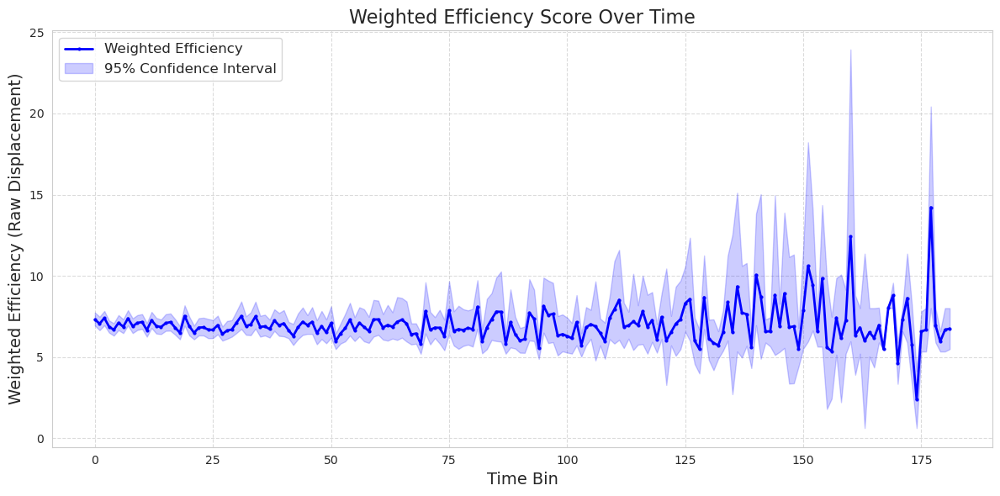

In [401]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Number of bootstrap samples
n_bootstraps = 1000
confidence_level = 0.95

# Calculate weighted efficiency for each time bin with bootstrapped confidence intervals
weighted_efficiency = []

for time_bin in sorted(Umap["event_id"].unique()):
    bin_data = Umap[Umap["event_id"] == time_bin]

    if len(bin_data) > 0:
        # Calculate proportion of each cluster in this time bin
        cluster_counts = bin_data["cluster"].value_counts()
        total_in_bin = cluster_counts.sum()

        # Calculate weighted efficiency
        weighted_eff = 0
        for cluster, count in cluster_counts.items():
            if cluster in cluster_ranking:
                cluster_eff = cluster_ranking[cluster]
                weighted_eff += (count / total_in_bin) * cluster_eff

        # Bootstrap resampling to calculate confidence intervals
        bootstrap_efficiencies = []
        for _ in range(n_bootstraps):
            # Resample with replacement
            resampled_data = bin_data.sample(n=len(bin_data), replace=True)
            resampled_cluster_counts = resampled_data["cluster"].value_counts()
            resampled_total = resampled_cluster_counts.sum()

            resampled_eff = 0
            for cluster, count in resampled_cluster_counts.items():
                if cluster in cluster_ranking:
                    cluster_eff = cluster_ranking[cluster]
                    resampled_eff += (count / resampled_total) * cluster_eff

            bootstrap_efficiencies.append(resampled_eff)

        # Calculate confidence intervals
        lower_bound = np.percentile(bootstrap_efficiencies, (1 - confidence_level) / 2 * 100)
        upper_bound = np.percentile(bootstrap_efficiencies, (1 + confidence_level) / 2 * 100)

        weighted_efficiency.append(
            {
                "event_id": time_bin,
                "weighted_efficiency": weighted_eff,
                "total_count": total_in_bin,
                "lower_ci": lower_bound,
                "upper_ci": upper_bound,
            }
        )

weighted_efficiency_df = pd.DataFrame(weighted_efficiency)

# Plot weighted efficiency over time with confidence intervals
plt.figure(figsize=(12, 6))
plt.plot(
    weighted_efficiency_df["event_id"],
    weighted_efficiency_df["weighted_efficiency"],
    "o-",
    color="blue",
    linewidth=2,
    markersize=2,
    label="Weighted Efficiency",
)

# Add confidence intervals as a shaded region
plt.fill_between(
    weighted_efficiency_df["event_id"],
    weighted_efficiency_df["lower_ci"],
    weighted_efficiency_df["upper_ci"],
    color="blue",
    alpha=0.2,
    label=f"{int(confidence_level * 100)}% Confidence Interval",
)

plt.title("Weighted Efficiency Score Over Time", fontsize=16)
plt.xlabel("Time Bin", fontsize=14)
plt.ylabel("Weighted Efficiency (Raw Displacement)", fontsize=14)
plt.grid(True, linestyle="--", alpha=0.7)
plt.legend(fontsize=12)
plt.tight_layout()
plt.savefig(f"{output_dir}/weighted_efficiency_over_events_with_ci.png")
plt.show()

In [ ]:
# Cluster by displacement

# Find columns that contain "displacement" in their name

Disp = Umap.filter(regex="displacement")

Disp

In [ ]:
sns.scatterplot(data=Umap, x="raw_displacement", y="cluster", alpha=0.1)

In [ ]:
# Get columns that have no x or y in their name, nor velocity

Umap.columns[~Umap.columns.str.contains("x|y|velocity")]

In [ ]:
PosPush = Umap[Umap["raw_displacement"] > 1]

In [ ]:
bin_metric(PosPush, "raw_displacement", 5)

In [ ]:
sns.histplot(data=PosPush, x="raw_displacement")

In [ ]:
sns.boxplot(data=Umap, x="cluster", y="raw_displacement")

# Adjust y range
plt.ylim(0, 10)

In [ ]:
Firstcontacts = Umap[Umap["event_id"] <10 ]

Firstcontacts = Firstcontacts[Firstcontacts["event_type"] == "interaction"]

In [ ]:
bin_metric(Firstcontacts, "start_distance", 10)

/home/matthias/miniconda3/envs/trackinganalysis/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/matthias/miniconda3/envs/trackinganalysis/lib/python3.11/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/matthias/miniconda3/envs/trackinganalysis/lib/python3.11/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/

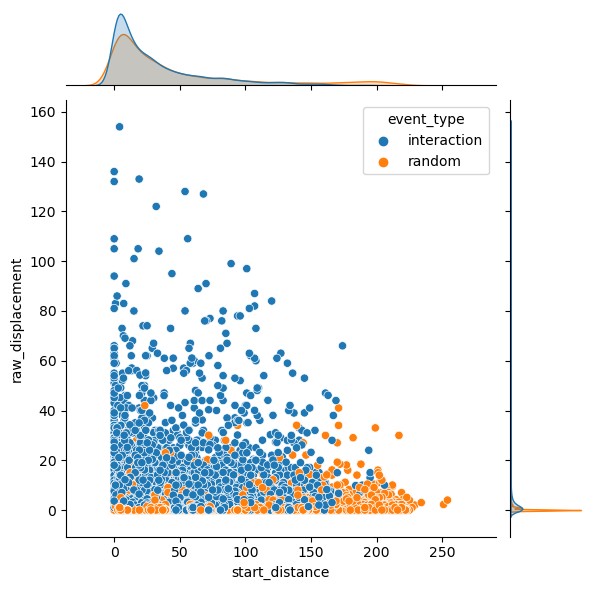

In [11]:
sns.jointplot(data=Umap, x="start_distance", y="raw_displacement", hue="event_type")

# plt.ylim(0, 10)

In [ ]:
# Plot side by side the umap values of event_type interaction and random with hue being the binned_end_distance
# Create a FacetGrid with two columns, one for each event_type
g = sns.FacetGrid(
    PosPush,
    col="event_type",
    sharex=True,
    sharey=True,
    height=6,
    aspect=1.2,
)

# Map the scatterplot to the FacetGrid
g.map_dataframe(
    sns.scatterplot,
    x="UMAP1",
    y="UMAP2",
    hue="cluster",
    alpha=0.5,
    palette="tab10",
)

# Add titles and adjust layout
g.set_titles(col_template="{col_name}")
g.add_legend()
plt.subplots_adjust(top=0.85)
g.fig.suptitle("Density Plots of UMAP by Event Type")

# Save the plot
plt.savefig(f"{output_dir}/UMAP_event_types_efficiency_cluster.png")
plt.show()
plt.close()

In [ ]:
PosPush = Umap[Umap["raw_displacement"] >= 1]

In [ ]:
bin_metric(PosPush, "raw_displacement", 5)

In [ ]:
# Calculate cluster proportions over time by event type
cluster_proportions = (PosPush
                      .groupby(['event_type', 'binned_raw_displacement', 'cluster'])
                      .size()
                      .reset_index(name='count'))

# Calculate totals for proportions
totals = (cluster_proportions
         .groupby(['event_type', 'binned_raw_displacement'])['count']
         .sum()
         .reset_index(name='total'))

# Merge and calculate proportions
cluster_proportions = cluster_proportions.merge(
    totals, on=['event_type', 'binned_raw_displacement'])
cluster_proportions['proportion'] = cluster_proportions['count'] / cluster_proportions['total']

In [ ]:
plt.figure(figsize=(20, 10))

for i, event_type in enumerate(PosPush["event_type"].unique()):
    plt.subplot(1, 2, i + 1)

    # Filter to just this event type
    event_data = cluster_proportions[cluster_proportions["event_type"] == event_type]

    # Plot a line for each cluster
    for cluster in sorted(PosPush["cluster"].unique()):
        cluster_data = event_data[event_data["cluster"] == cluster]
        if not cluster_data.empty:
            plt.plot(
                cluster_data["binned_raw_displacement"],
                cluster_data["proportion"],
                marker="o",
                linewidth=2,
                label=f"Cluster {cluster}",
            )

    plt.title(f"Cluster Efficiency - {event_type}", fontsize=14)
    plt.xlabel("Efficiency", fontsize=12)
    plt.ylabel("Proportion of Events", fontsize=12)
    plt.grid(True, alpha=0.3)
    plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc="upper left")

plt.tight_layout()
plt.savefig(f"{output_dir}/positive_disps_cluster_efficiency_line_plots.png")
plt.show()

In [ ]:
# Calculate cluster proportions over time by event type
cluster_proportions = (
    Umap.groupby(["binned_raw_displacement", "cluster"])
    .size()
    .reset_index(name="count")
)

# Calculate totals for proportions
totals = (
    cluster_proportions.groupby(["binned_raw_displacement"])["count"]
    .sum()
    .reset_index(name="total")
)

# Merge and calculate proportions
cluster_proportions = cluster_proportions.merge(
    totals, on=["binned_raw_displacement"]
)
cluster_proportions["proportion"] = (
    cluster_proportions["count"] / cluster_proportions["total"]
)
plt.figure(figsize=(20, 10))

# Plot a line for each cluster
for cluster in sorted(Umap["cluster"].unique()):
    cluster_data = event_data[event_data["cluster"] == cluster]
    if not cluster_data.empty:
        plt.plot(
            cluster_data["binned_raw_displacement"],
            cluster_data["proportion"],
            marker="o",
            linewidth=2,
            label=f"Cluster {cluster}",
        )

plt.title(f"Cluster Efficiency", fontsize=14)
plt.xlabel("Efficiency", fontsize=12)
plt.ylabel("Proportion of Events", fontsize=12)
plt.grid(True, alpha=0.3)
plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc="upper left")

plt.tight_layout()
plt.savefig(f"{output_dir}/cluster_efficiency_line_plots_pooled.png")
plt.show()

In [ ]:
# Calculate cluster proportions over time by event type AND fly
fly_cluster_proportions = (
    Umap.groupby(["fly", "event_type", "binned_raw_displacement", "cluster"])
    .size()
    .reset_index(name="count")
)

# Calculate totals for proportions (per fly and time bin)
fly_totals = (
    fly_cluster_proportions.groupby(["fly", "event_type", "binned_raw_displacement"])["count"]
    .sum()
    .reset_index(name="total")
)

# Merge and calculate proportions
fly_cluster_proportions = fly_cluster_proportions.merge(
    fly_totals, on=["fly", "event_type", "binned_raw_displacement"]
)
fly_cluster_proportions["proportion"] = (
    fly_cluster_proportions["count"] / fly_cluster_proportions["total"]
)

In [ ]:
# Create a facet grid of box plots
g = sns.FacetGrid(
    fly_cluster_proportions,
    col="event_type",
    row="cluster",
    margin_titles=True,
    height=3,
    aspect=1.5,
)

# Map the box plot
g.map_dataframe(sns.boxplot, x="binned_raw_displacement", y="proportion", color="skyblue")

# Add strip plot to show individual fly points
g.map_dataframe(
    sns.stripplot,
    x="binned_raw_displacement",
    y="proportion",
    color="black",
    size=2,
    alpha=0.5,
    jitter=True,
)

# Add titles and labels
g.set_axis_labels("Time Bin", "Proportion")
g.set_titles(col_template="{col_name}", row_template="Cluster {row_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Cluster Distribution by Efficiency", fontsize=16)

plt.savefig(f"{output_dir}/cluster_evolution_by_efficiency_box_plots.png")
plt.show()

# UMAP only with interaction data

In [ ]:
Interaction_UMAP = pd.read_feather("/mnt/upramdya_data/MD/Ballpushing_Exploration/Datasets/250312_StdContacts_Ctrl_noRandom_cutoff_300frames_Data/UMAP/250312_pooled_standardized_contacts.feather")

In [ ]:
# Define and create if not exist output directory

output_dir = Path("/mnt/upramdya_data/MD/Ballpushing_Exploration/Behavior_classification/UMAP/250311_Pooled_FeedingState_InteractionsOnly_300Frames")

output_dir.mkdir(parents=True, exist_ok=True)


In [ ]:

# Scatter plot of UMAP1 vs UMAP2

sns.scatterplot(data=Interaction_UMAP, x="UMAP1", y="UMAP2", alpha = 0.1)

# save the plot

plt.savefig(f"{output_dir}/UMAP.png")


In [ ]:
# Same with density

plt.figure(figsize=(8, 6))

sns.kdeplot(data=Interaction_UMAP, x="UMAP1", y="UMAP2", fill=True, alpha=0.5)

plt.savefig(f"{output_dir}/UMAP_density.png")

plt.show()

# Cluster detection

In [ ]:
# Identify clusters based on KMeans

from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=12, random_state=0).fit(Interaction_UMAP[["UMAP1", "UMAP2"]])

Interaction_UMAP["cluster"] = kmeans.labels_

plt.figure(figsize=(8, 6))

sns.scatterplot(data=Interaction_UMAP, x="UMAP1", y="UMAP2", alpha = 0.1, hue="cluster", palette="tab10")

# Save the plot

plt.savefig(f"{output_dir}/UMAP_Clusters.png")

plt.show()

# Looking at metrics of time / progress

In [ ]:
bin_metric(Interaction_UMAP, "event_id", 50)

# Event ID

In [ ]:
sns.scatterplot(data=Interaction_UMAP, x="UMAP1", y="UMAP2", hue="binned_event_id", alpha = 0.4, palette="viridis")

In [ ]:
# Look at distribution of event id

sns.histplot(data=Interaction_UMAP, x="event_id", bins=50)

In [ ]:
# Create the FacetGrid with multiple columns
g = sns.FacetGrid(Interaction_UMAP, col="binned_event_id", hue="binned_event_id", sharex=True, sharey=True, height=10, aspect=1.2, col_wrap=5)

# Map the kdeplot to the FacetGrid
g.map(sns.kdeplot, "UMAP1", "UMAP2", fill=True, alpha=0.5)

# Standardize x and y range for all subplots
g.set(xlim=(Interaction_UMAP["UMAP1"].min()-3, Interaction_UMAP["UMAP1"].max()+3), ylim=(Interaction_UMAP["UMAP2"].min()-3, Interaction_UMAP["UMAP2"].max()+3))

# Add titles and adjust layout
g.set_titles(col_template="{col_name}")
g.add_legend()
plt.subplots_adjust(top=0.85)
g.fig.suptitle("Density Plots of UMAP by Event ID")

# Save the plot
plt.savefig(f"{output_dir}/UMAP_event_id_density.png")
plt.show()

In [ ]:
# Create the FacetGrid with multiple columns
g = sns.FacetGrid(Interaction_UMAP, col="binned_event_id", hue="binned_event_id", sharex=True, sharey=True, height=10, aspect=1.2, col_wrap=5)

# Map the kdeplot to the FacetGrid
g.map(sns.scatterplot, "UMAP1", "UMAP2", alpha=0.5)

# Standardize x and y range for all subplots
g.set(xlim=(Interaction_UMAP["UMAP1"].min()-3, Interaction_UMAP["UMAP1"].max()+3), ylim=(Interaction_UMAP["UMAP2"].min()-3, Interaction_UMAP["UMAP2"].max()+3))

# Add titles and adjust layout
g.set_titles(col_template="{col_name}")
g.add_legend()
plt.subplots_adjust(top=0.85)
g.fig.suptitle("UMAP by Event ID")

# Save the plot
plt.savefig(f"{output_dir}/UMAP_event_id.png")
plt.show()

In [ ]:
# Get unique event_ids
unique_event_ids = Interaction_UMAP["binned_event_id"].unique()

# Initialize a DataFrame to store the proportions
proportions_df = pd.DataFrame()

# Process each event_id
for event_id in unique_event_ids:
    event_data = Interaction_UMAP[Interaction_UMAP["binned_event_id"] == event_id]

    # Count clusters and calculate proportions within the event_id
    cluster_counts = event_data["cluster"].value_counts(normalize=True).reset_index()
    cluster_counts.columns = ["cluster", "proportion"]
    cluster_counts["binned_event_id"] = event_id

    # Append to the proportions DataFrame
    proportions_df = pd.concat([proportions_df, cluster_counts], ignore_index=True)

# Plot cluster proportions as bar plots
plt.figure(figsize=(30, 30))
sns.lineplot(data=proportions_df, x="binned_event_id", y="proportion", hue="cluster", palette="tab10", linewidth=2)
plt.title("Cluster Proportions by Event ID")
plt.xlabel("Event ID (Binned)")
plt.ylabel("Proportion of Clusters")
plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/cluster_proportions_by_binned_event_id.png")
plt.show()
plt.close()

In [ ]:
# Group the data by fly and binned_event_id and calculate proportions
grouped = Interaction_UMAP.groupby(["fly", "binned_event_id", "cluster"]).size().reset_index(name="count")
total_counts = grouped.groupby(["fly", "binned_event_id"])["count"].transform("sum")
grouped["proportion"] = grouped["count"] / total_counts

# Plot cluster proportions as box plots with jittered strip plots
plt.figure(figsize=(14, 8))
sns.boxplot(data=grouped, x="binned_event_id", y="proportion", hue="cluster", palette="tab10")
#sns.stripplot(data=grouped, x="binned_event_id", y="proportion", hue="cluster", dodge=True, color="black", alpha=0.5, jitter=False)

# Adjust plot aesthetics
plt.title("Cluster Proportions by Event ID (Grouped by Fly)")
plt.xlabel("Event ID (Binned)")
plt.ylabel("Proportion of Clusters")
plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/jitterbp_cluster_proportions_by_binned_event_id_grouped_by_fly.png")
plt.show()
plt.close()

# With event id subset

In [ ]:
FirstIDs = Interaction_UMAP[Interaction_UMAP["event_id"] < 30]

In [ ]:
sns.scatterplot(data=FirstIDs, x="UMAP1", y="UMAP2", hue="event_id", alpha = 0.4, palette="viridis")

In [ ]:
# Create the FacetGrid with multiple columns
g = sns.FacetGrid(FirstIDs, col="event_id", hue="event_id", sharex=True, sharey=True, height=10, aspect=1.2, col_wrap=5)

# Map the kdeplot to the FacetGrid
g.map(sns.kdeplot, "UMAP1", "UMAP2", fill=True, alpha=0.5)

# Standardize x and y range for all subplots
g.set(xlim=(FirstIDs["UMAP1"].min()-3, FirstIDs["UMAP1"].max()+3), ylim=(FirstIDs["UMAP2"].min()-3, FirstIDs["UMAP2"].max()+3))

# Add titles and adjust layout
g.set_titles(col_template="{col_name}")
g.add_legend()
plt.subplots_adjust(top=0.85)
g.fig.suptitle("Density Plots of UMAP by Event ID")

# Save the plot
plt.savefig(f"{output_dir}/UMAP_event_id_subset_density.png")
plt.show()

In [ ]:
# Get unique event_ids
unique_event_ids = FirstIDs["event_id"].unique()

# Initialize a DataFrame to store the proportions
proportions_df = pd.DataFrame()

# Process each event_id
for event_id in unique_event_ids:
    event_data = FirstIDs[FirstIDs["event_id"] == event_id]

    # Count clusters and calculate proportions within the event_id
    cluster_counts = event_data["cluster"].value_counts(normalize=True).reset_index()
    cluster_counts.columns = ["cluster", "proportion"]
    cluster_counts["event_id"] = event_id

    # Append to the proportions DataFrame
    proportions_df = pd.concat([proportions_df, cluster_counts], ignore_index=True)

# Plot cluster proportions as bar plots
plt.figure(figsize=(30, 30))
sns.lineplot(data=proportions_df, x="event_id", y="proportion", hue="cluster", palette="tab10", linewidth=2)
plt.title("Cluster Proportions by Event ID")
plt.xlabel("Event ID (Binned)")
plt.ylabel("Proportion of Clusters")
plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/cluster_proportions_by_event_id.png")
plt.show()
plt.close()

In [ ]:
# Group the data by fly and binned_event_id and calculate proportions
grouped = FirstIDs.groupby(["fly", "event_id", "cluster"]).size().reset_index(name="count")
total_counts = grouped.groupby(["fly", "event_id"])["count"].transform("sum")
grouped["proportion"] = grouped["count"] / total_counts

# Plot cluster proportions as box plots with jittered strip plots
plt.figure(figsize=(14, 8))
sns.boxplot(data=grouped, x="event_id", y="proportion", hue="cluster", palette="tab10")
#sns.stripplot(data=grouped, x="binned_event_id", y="proportion", hue="cluster", dodge=True, color="black", alpha=0.5, jitter=False)

# Adjust plot aesthetics
plt.title("Cluster Proportions by Event ID (Grouped by Fly)")
plt.xlabel("Event ID (Binned)")
plt.ylabel("Proportion of Clusters")
plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/jitterbp_cluster_proportions_by_event_id_grouped_by_fly.png")
plt.show()
plt.close()

# Test with time

In [ ]:
# Lets generate a binned time

bin_metric(Interaction_UMAP, "start", 20)

In [ ]:
sns.scatterplot(data=Interaction_UMAP, x="UMAP1", y="UMAP2", hue="binned_start", alpha = 0.4, palette="viridis")

In [ ]:
# Create the FacetGrid with multiple columns
g = sns.FacetGrid(Interaction_UMAP, col="binned_start", hue="binned_start", sharex=True, sharey=True, height=10, aspect=1.2, col_wrap=5)

# Map the kdeplot to the FacetGrid
g.map(sns.kdeplot, "UMAP1", "UMAP2", fill=True, alpha=0.5)

# Standardize x and y range for all subplots
g.set(xlim=(Interaction_UMAP["UMAP1"].min()-3, Interaction_UMAP["UMAP1"].max()+3), ylim=(Interaction_UMAP["UMAP2"].min()-3, Interaction_UMAP["UMAP2"].max()+3))

# Add titles and adjust layout
g.set_titles(col_template="{col_name}")
g.add_legend()
plt.subplots_adjust(top=0.85)
g.fig.suptitle("Density Plots of UMAP by Event ID")

# Save the plot
plt.savefig(f"{output_dir}/UMAP_time_density.png")
plt.show()

In [ ]:
# Create the FacetGrid with multiple columns
g = sns.FacetGrid(Interaction_UMAP, col="binned_start", hue="binned_start", sharex=True, sharey=True, height=10, aspect=1.2, col_wrap=5)

# Map the kdeplot to the FacetGrid
g.map(sns.scatterplot, "UMAP1", "UMAP2", alpha=0.5)

# Standardize x and y range for all subplots
g.set(xlim=(Interaction_UMAP["UMAP1"].min()-3, Interaction_UMAP["UMAP1"].max()+3), ylim=(Interaction_UMAP["UMAP2"].min()-3, Interaction_UMAP["UMAP2"].max()+3))

# Add titles and adjust layout
g.set_titles(col_template="{col_name}")
g.add_legend()
plt.subplots_adjust(top=0.85)
g.fig.suptitle("UMAP by Event ID")

# Save the plot
plt.savefig(f"{output_dir}/UMAP_time.png")
plt.show()

In [ ]:
# Get unique event_ids
unique_event_ids = Interaction_UMAP["binned_start"].unique()

# Initialize a DataFrame to store the proportions
proportions_df = pd.DataFrame()

# Process each event_id
for event_id in unique_event_ids:
    event_data = Interaction_UMAP[Interaction_UMAP["binned_start"] == event_id]

    # Count clusters and calculate proportions within the event_id
    cluster_counts = event_data["cluster"].value_counts(normalize=True).reset_index()
    cluster_counts.columns = ["cluster", "proportion"]
    cluster_counts["binned_start"] = event_id

    # Append to the proportions DataFrame
    proportions_df = pd.concat([proportions_df, cluster_counts], ignore_index=True)

# Plot cluster proportions as bar plots
plt.figure(figsize=(30, 30))
sns.lineplot(data=proportions_df, x="binned_start", y="proportion", hue="cluster", palette="tab10", linewidth=2)
plt.title("Cluster Proportions by Event ID")
plt.xlabel("Event ID (Binned)")
plt.ylabel("Proportion of Clusters")
plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/cluster_proportions_by_binned_start.png")
plt.show()
plt.close()

In [ ]:
# Group the data by fly and binned_event_id and calculate proportions
grouped = Interaction_UMAP.groupby(["fly", "binned_start", "cluster"]).size().reset_index(name="count")
total_counts = grouped.groupby(["fly", "binned_start"])["count"].transform("sum")
grouped["proportion"] = grouped["count"] / total_counts

# Plot cluster proportions as box plots with jittered strip plots
plt.figure(figsize=(14, 8))
sns.boxplot(data=grouped, x="binned_start", y="proportion", hue="cluster", palette="tab10")
#sns.stripplot(data=grouped, x="binned_start", y="proportion", hue="cluster", dodge=True, color="black", alpha=0.5, jitter=False)

# Adjust plot aesthetics
plt.title("Cluster Proportions by Event ID (Grouped by Fly)")
plt.xlabel("Event ID (Binned)")
plt.ylabel("Proportion of Clusters")
plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/jitterbp_cluster_proportions_by_binned_start_grouped_by_fly.png")
plt.show()
plt.close()

In [ ]:
# Keep only first and last binned_start values

Subset = Interaction_UMAP[Interaction_UMAP["binned_start"].isin([0, 19])]

# Group the data by fly and binned_event_id and calculate proportions
grouped = Subset.groupby(["fly", "binned_start", "cluster"]).size().reset_index(name="count")
total_counts = grouped.groupby(["fly", "binned_start"])["count"].transform("sum")
grouped["proportion"] = grouped["count"] / total_counts

# Plot cluster proportions as box plots with jittered strip plots
plt.figure(figsize=(14, 8))
sns.boxplot(data=grouped, x="binned_start", y="proportion", hue="cluster", palette="tab10")
#sns.stripplot(data=grouped, x="binned_start", y="proportion", hue="cluster", dodge=True, color="black", alpha=0.5, jitter=False)

# Adjust plot aesthetics
plt.title("Cluster Proportions by Event ID (Grouped by Fly)")
plt.xlabel("Event ID (Binned)")
plt.ylabel("Proportion of Clusters")
plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/jitterbp_cluster_proportions_by_binned_start_grouped_by_fly_subset.png")
plt.show()
plt.close()

# By ball position



In [ ]:
# Lets generate a binned time

bin_metric(Interaction_UMAP, "median_euclidean_distance", 20)

In [ ]:
Interaction_UMAP.columns[Interaction_UMAP.columns.str.contains("displacement")]

In [ ]:
sns.histplot(data=Interaction_UMAP, x="y_centre_preprocessed_disp_mean", bins=20)

In [ ]:
sns.scatterplot(data=Interaction_UMAP, x="UMAP1", y="UMAP2", hue="binned_median_euclidean_distance", alpha = 0.4, palette="viridis")

In [ ]:
# Create the FacetGrid with multiple columns
g = sns.FacetGrid(Interaction_UMAP, col="binned_median_euclidean_distance", hue="binned_median_euclidean_distance", sharex=True, sharey=True, height=10, aspect=1.2, col_wrap=5)

# Map the kdeplot to the FacetGrid
g.map(sns.kdeplot, "UMAP1", "UMAP2", fill=True, alpha=0.5)

# Standardize x and y range for all subplots
g.set(xlim=(Interaction_UMAP["UMAP1"].min()-3, Interaction_UMAP["UMAP1"].max()+3), ylim=(Interaction_UMAP["UMAP2"].min()-3, Interaction_UMAP["UMAP2"].max()+3))

# Add titles and adjust layout
g.set_titles(col_template="{col_name}")
g.add_legend()
plt.subplots_adjust(top=0.85)
g.fig.suptitle("Density Plots of UMAP by Event ID")

# Save the plot
plt.savefig(f"{output_dir}/UMAP_distance_density.png")
plt.show()

In [ ]:
# Create the FacetGrid with multiple columns
g = sns.FacetGrid(Interaction_UMAP, col="binned_median_euclidean_distance", hue="binned_median_euclidean_distance", sharex=True, sharey=True, height=10, aspect=1.2, col_wrap=5)

# Map the kdeplot to the FacetGrid
g.map(sns.scatterplot, "UMAP1", "UMAP2", alpha=0.5)

# Standardize x and y range for all subplots
g.set(xlim=(Interaction_UMAP["UMAP1"].min()-3, Interaction_UMAP["UMAP1"].max()+3), ylim=(Interaction_UMAP["UMAP2"].min()-3, Interaction_UMAP["UMAP2"].max()+3))

# Add titles and adjust layout
g.set_titles(col_template="{col_name}")
g.add_legend()
plt.subplots_adjust(top=0.85)
g.fig.suptitle("UMAP by Event ID")

# Save the plot
plt.savefig(f"{output_dir}/UMAP_distance.png")
plt.show()

In [ ]:
# Get unique event_ids
unique_event_ids = Interaction_UMAP["binned_start"].unique()

# Initialize a DataFrame to store the proportions
proportions_df = pd.DataFrame()

# Process each event_id
for event_id in unique_event_ids:
    event_data = Interaction_UMAP[Interaction_UMAP["binned_start"] == event_id]

    # Count clusters and calculate proportions within the event_id
    cluster_counts = event_data["cluster"].value_counts(normalize=True).reset_index()
    cluster_counts.columns = ["cluster", "proportion"]
    cluster_counts["binned_start"] = event_id

    # Append to the proportions DataFrame
    proportions_df = pd.concat([proportions_df, cluster_counts], ignore_index=True)

# Plot cluster proportions as bar plots
plt.figure(figsize=(30, 30))
sns.lineplot(data=proportions_df, x="binned_start", y="proportion", hue="cluster", palette="tab10", linewidth=2)
plt.title("Cluster Proportions by Event ID")
plt.xlabel("Event ID (Binned)")
plt.ylabel("Proportion of Clusters")
plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/cluster_proportions_by_binned_start.png")
plt.show()
plt.close()

In [ ]:
# Group the data by fly and binned_event_id and calculate proportions
grouped = Interaction_UMAP.groupby(["fly", "binned_start", "cluster"]).size().reset_index(name="count")
total_counts = grouped.groupby(["fly", "binned_start"])["count"].transform("sum")
grouped["proportion"] = grouped["count"] / total_counts

# Plot cluster proportions as box plots with jittered strip plots
plt.figure(figsize=(14, 8))
sns.boxplot(data=grouped, x="binned_start", y="proportion", hue="cluster", palette="tab10")
#sns.stripplot(data=grouped, x="binned_start", y="proportion", hue="cluster", dodge=True, color="black", alpha=0.5, jitter=False)

# Adjust plot aesthetics
plt.title("Cluster Proportions by Event ID (Grouped by Fly)")
plt.xlabel("Event ID (Binned)")
plt.ylabel("Proportion of Clusters")
plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/jitterbp_cluster_proportions_by_binned_start_grouped_by_fly.png")
plt.show()
plt.close()

In [ ]:
# Keep only first and last binned_start values

Subset = Interaction_UMAP[Interaction_UMAP["binned_start"].isin([0, 19])]

# Group the data by fly and binned_event_id and calculate proportions
grouped = Subset.groupby(["fly", "binned_start", "cluster"]).size().reset_index(name="count")
total_counts = grouped.groupby(["fly", "binned_start"])["count"].transform("sum")
grouped["proportion"] = grouped["count"] / total_counts

# Plot cluster proportions as box plots with jittered strip plots
plt.figure(figsize=(14, 8))
sns.boxplot(data=grouped, x="binned_start", y="proportion", hue="cluster", palette="tab10")
#sns.stripplot(data=grouped, x="binned_start", y="proportion", hue="cluster", dodge=True, color="black", alpha=0.5, jitter=False)

# Adjust plot aesthetics
plt.title("Cluster Proportions by Event ID (Grouped by Fly)")
plt.xlabel("Event ID (Binned)")
plt.ylabel("Proportion of Clusters")
plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/jitterbp_cluster_proportions_by_binned_start_grouped_by_fly_subset.png")
plt.show()
plt.close()

# Check whether some clusters are associated with more or less efficiency

In [ ]:
sns.histplot(Interaction_UMAP["raw_displacement"])

In [ ]:
# Positive push

PosPush = Interaction_UMAP[Interaction_UMAP["raw_displacement"] > 0]

In [ ]:
sns.scatterplot(data=PosPush, x="UMAP1", y="UMAP2", hue="raw_displacement", alpha = 0.4, palette="viridis")

In [ ]:
bin_metric(PosPush, "raw_displacement", 10)

In [ ]:
# Create the FacetGrid with multiple columns
g = sns.FacetGrid(PosPush, col="binned_raw_displacement", hue="binned_raw_displacement", sharex=True, sharey=True, height=10, aspect=1.2, col_wrap=5)

# Map the kdeplot to the FacetGrid
g.map(sns.kdeplot, "UMAP1", "UMAP2", fill=True, alpha=0.5)

# Standardize x and y range for all subplots
g.set(xlim=(PosPush["UMAP1"].min()-3, PosPush["UMAP1"].max()+3), ylim=(PosPush["UMAP2"].min()-3, PosPush["UMAP2"].max()+3))

# Add titles and adjust layout
g.set_titles(col_template="{col_name}")
g.add_legend()
plt.subplots_adjust(top=0.85)
g.fig.suptitle("Density Plots of UMAP by Event ID")

# Save the plot
plt.savefig(f"{output_dir}/UMAP_disp_density.png")
plt.show()

In [ ]:
# Get unique event_ids
unique_event_ids = PosPush["binned_raw_displacement"].unique()

# Initialize a DataFrame to store the proportions
proportions_df = pd.DataFrame()

# Process each event_id
for event_id in unique_event_ids:
    event_data = PosPush[PosPush["binned_raw_displacement"] == event_id]

    # Count clusters and calculate proportions within the event_id
    cluster_counts = event_data["cluster"].value_counts(normalize=True).reset_index()
    cluster_counts.columns = ["cluster", "proportion"]
    cluster_counts["binned_raw_displacement"] = event_id

    # Append to the proportions DataFrame
    proportions_df = pd.concat([proportions_df, cluster_counts], ignore_index=True)

# Plot cluster proportions as bar plots
plt.figure(figsize=(30, 30))
sns.lineplot(data=proportions_df, x="binned_raw_displacement", y="proportion", hue="cluster", palette="tab20", linewidth=2)
plt.title("Cluster Proportions by Event ID")
plt.xlabel("Event ID (Binned)")
plt.ylabel("Proportion of Clusters")
plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/cluster_proportions_by_binned_raw_displacement.png")
plt.show()
plt.close()

In [ ]:
# Get unique values for fly, binned_raw_displacement, and cluster
unique_flies = PosPush["fly"].unique()
unique_binned_raw_displacement = PosPush["binned_raw_displacement"].unique()
unique_clusters = PosPush["cluster"].unique()

# Create a MultiIndex with all combinations of fly, binned_raw_displacement, and cluster
index = pd.MultiIndex.from_product([unique_flies, unique_binned_raw_displacement, unique_clusters], names=["fly", "binned_raw_displacement", "cluster"])

# Group the data by fly, binned_raw_displacement, and cluster, and calculate counts
grouped = PosPush.groupby(["fly", "binned_raw_displacement", "cluster"]).size().reset_index(name="count")

# Reindex the grouped data to include all combinations, filling missing values with zero
grouped = grouped.set_index(["fly", "binned_raw_displacement", "cluster"]).reindex(index, fill_value=0).reset_index()

# Calculate proportions within each fly and binned_raw_displacement
total_counts = grouped.groupby(["fly", "binned_raw_displacement"])["count"].transform("sum")
grouped["proportion"] = grouped["count"] / total_counts

# Plot cluster proportions as box plots with jittered strip plots
plt.figure(figsize=(14, 8))
sns.boxplot(data=grouped, x="binned_raw_displacement", y="proportion", hue="cluster", palette="tab10")
sns.stripplot(data=grouped, x="binned_raw_displacement", y="proportion", hue="cluster", dodge=True, color="black", alpha=0.5, jitter=True)

# Adjust plot aesthetics
plt.title("Cluster Proportions by Event ID (Grouped by Fly)")
plt.xlabel("Event ID (Binned)")
plt.ylabel("Proportion of Clusters")
plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save the plot
plt.savefig(f"{output_dir}/jitterbp_cluster_proportions_by_binned_raw_displacement_grouped_by_fly.png")
plt.show()
plt.close()